# Confident Learning and Cleanlab - Deep Dive
## IMD3011 - Datacentric AI
### [Dr. Elias Jacob de Menezes Neto](https://docente.ufrn.br/elias.jacob)

## Keypoints

- **Label noise significantly impacts model performance**: Incorrect or misleading labels in datasets can degrade the accuracy and reliability of machine learning models.

- **Confident Learning (CL) detects and corrects label noise**: CL uses model predictions to identify and address label errors, improving dataset quality.

- **CL assumes class-conditional label noise with error rates below50%**: The probability of label errors depends on the true class, and no class has more than50% mislabeled data.

- **CL involves four key steps**: Obtaining out-of-sample predictions, computing the confident joint distribution, estimating the noise transition matrix, and identifying/correcting label errors.

- **The `cleanlab` library simplifies CL implementation**: It provides tools like `Datalab` to detect label issues, outliers, and near-duplicates automatically.

- **CL improves model performance across various tasks**: It is effective in text classification, image classification, named entity recognition (NER), and multi-label classification.

- **Test set quality is essential**: Label noise in test data can lead to misleading performance metrics and unreliable model evaluation.

- **CL has limitations**: It struggles with completely missing labels, is computationally intensive for large datasets, and requires adaptation for multi-label tasks.

- **Complementary tools like `CleanVision` enhance data quality**: They detect outliers and near-duplicates, especially in image datasets, further improving model training data.

- **CL is stable to modeliscalibration**: It relies on relative confidence scores rather than exact probability estimates, making it effective even with imperfectly calibrated models.



## Learning goals
By the end of this class, you will be able to:

1. **Explain** the fundamental concepts of label noise and its detrimental effects on the performance and generalization of machine learning models.

2. **Describe** the key assumptions underpinning Confident Learning (CL), including class-conditional label noise and error rate limitations, and discuss their effects for real-world datasets.

3. **Outline** the four key steps of the Confident Learning algorithm: out-of-sample prediction generation, confident joint distribution computation, noise transition matrix estimation, and label error identification/correction, and **explain** the purpose of each step.

4. **Carry Out** the Confident Learning algorithm using the `cleanlab` library in Python to detect and mitigate label noise in diverse datasets, including text, images, and multi-label data.

5. **Apply** Confident Learning to various machine learning tasks such as text classification, image classification (e.g., Dogs vs. Cats), and Named Entity Recognition (NER) to improve data quality and model performance.

6. **Critically evaluate** the importance of test set quality in machine learning, and **analyze** the impact of label noise in test sets on model evaluation metrics and the reliability of performance assessments.

7. **Discuss** the limitations of Confident Learning, including its challenges in handling completely missing labels, computational demands for large datasets, and complexities in multi-label classification scenarios.

8. **Integrate** Confident Learning with complementary data quality techniques and tools, such as `CleanVision` for outlier and near-duplicate detection in image datasets, to design extensive data cleaning pipelines.

9. **Assess** the robustness of Confident Learning to model miscalibration, and **explain** how its reliance on relative confidence scores contributes to its effectiveness even with imperfectly calibrated models.

10. **Design** a data-centric machine learning workflow that incorporates continuous data quality assessment and improvement strategies, using Confident Learning and related techniques to enhance model reliability and real-world applicability.


## Confident Learning

In machine learning, **noise** refers to incorrect or irrelevant information that can lower model accuracy. One common type is **label noise**, where data points receive wrong or imprecise labels. Addressing label noise is an essential step in improving data quality and model performance.

**Confident Learning (CL)** is a systematic approach aimed at detecting and managing label noise. It uses model predictions and statistical methods to identify mislabeled samples and estimate the probability of label errors.

### Key Components of Confident Learning

#### 1. Label Noise Transition Matrix

- **Definition:**  
 The label noise transition matrix is a table that shows the probability of observing a specific label given the true basic label. In a binary classification task, for example, if the true label is "positive," the matrix provides probabilities for both "positive" (correct) and "negative" (incorrect) labels.

- **Mathematical Representation:**  
 Let $\hat{Q}(\tilde{y} \mid y^*)$ represent the transition probability, where $\tilde{y}$ is the observed (possibly noisy) label and $y^*$ is the true label. For example, the probability of correctly labeling a "bus" might be written as:
  
 $$
  \hat{Q}(\tilde{y}=\text{bus} \mid y^*=\text{bus})
  $$
  
 and the probability of a mislabel as:
  
 $$
  \hat{Q}(\tilde{y}=\text{car} \mid y^*=\text{bus})
  $$

- **Utility:**  
 By analyzing both diagonal elements (correct label assignments) and off-diagonal elements (mislabeling cases), this matrix provides insights into the nature of label errors. These insights allow for adjustments during training to reduce the negative impact of noise.

#### 2. Confidence Thresholding

- **Concept:**  
 Not every model prediction is equally reliable. Confidence thresholding sets a predetermined level, and only predictions exceeding this threshold are considered during training. This selective approach helps reduce the influence of data points that might be mislabeled.

- **Benefit:**  
 The method improves the learning process by focusing on predictions that the model is most certain about. It minimizes the risk of propagating errors from uncertain or noisy labels.

#### 3. Model-Agnostic Implementation

- **Flexibility:**  
 The framework does not depend on a particular type of model. Whether the model is simple or complex, such as logistic regression or a deep neural network, Confident Learning can be applied as long as the model outputs valid class probability estimates.

- **Implication:**  
 This broad applicability makes the method suitable for various domains and tasks, ensuring that the benefits from mitigating label noise can be reaped regardless of the model choice.

#### 4. Data-Centric Approach

- **Focus on Data Quality:**  
 Confident Learning emphasizes the improvement of data quality by directly addressing mislabeled instances. Correcting data quality at the source leads to models that generalize better and exhibit improved performance.

- **Implementation:**  
 The strategy involves examining the dataset for inconsistencies and refining the labeling process. It can also suggest adjustments in the data collection pipeline to minimize future errors.

### Key Assumptions

#### 1. Class-Conditional Label Noise

- **Definition:** Label noise is assumed to be class-conditional; the probability of a label error depends solely on the true class rather than on individual features.
  
- **Illustration:** In an image classification task, if images of cats are sometimes mistaken for dogs, the likelihood of a labeling error remains the same for all cat images. However, it is important to consider that external factors (such as image context) may occasionally influence mislabeling.

#### 2. Error Rate Below 50%

- **Premise:** It is presumed that the error rate for each class is less than 50%. If a class contains more than half incorrect labels, the true class distribution becomes very difficult to establish.
  
- **Rationale:** Reliable statistical estimates of the basic distribution are feasible only if the majority of the labels are accurate.


### Limitations and Challenges

While CL is effective in many scenarios, several challenges remain, particularly in complex tasks such as multi-label classification:

1. **Unseen True Labels**
   - **Issue:** Some true labels might not appear in the observed data, especially in tasks where multiple labels can coexist.
   - **Example:** In an image featuring both a television and water bottle, if only “television” is recorded, the absence of the second label goes unnoticed.

2. **Computational Complexity**
   - **Complexity Estimate:** The method operates with a complexity of $ O(m^2 + nm) $, where *m* is the number of classes and *n* is the number of samples.
   - **Repercussions:**
     - Large *m* (number of classes) and *n* (number of samples) may require significant computational resources.
     - Increased processing time can hinder practical applications for very large or complex datasets.

3. **Handling Multi-Label Classification**
   - **Challenge:** The assumptions and methods fundamental CL are primarily designed for single-label cases.
   - **Detailed Points:**
     - Joint label distributions in multi-label tasks are more complicated than the simple pairwise case.
     - Scaling the approach to handle multiple simultaneous labels introduces additional computational overhead and theoretical challenges.
  
 - **Current Research:** While tools like the `cleanlab` library are working to support multi-label cases, further empirical research is necessary to validate their effectiveness in these situations.

For a more in-depth explanation of Confident Learning basics, consider reading this [article](https://towardsdatascience.com/confident-learning-err-did-you-say-your-data-is-clean-ef2597903328).

## Notation from the [CL paper](http://arxiv.org/abs/1911.00068)
The following notation is used in the Confident Learning paper. It is important to understand these terms as they are fundamental to the concepts discussed in the paper.

Here's the table and equations using markdown formatting:

| Notation | Definition |
|----------|------------|
| $m$ | The number of unique class labels |
| $[m]$ | The set of $m$ unique class labels |
| $\tilde{y}$ | Discrete random variable $\tilde{y} \in [m]$ takes an observed, noisy label |
| $y^*$ | Discrete random variable $y^* \in [m]$ takes the unknown, true, uncorrupted label |
| $X$ | The dataset $(x, \tilde{y})^n \in (\mathbb{R}^d, [m])^n$ of $n$ examples $x \in \mathbb{R}^d$ with noisy labels |
| $x_k$ | The $k^{th}$ training data example |
| $\tilde{y}_k$ | The observed, noisy label corresponding to $x_k$ |
| $y_k^*$ | The unknown, true label corresponding to $x_k$ |
| $n$ | The cardinality of $X := (x, \tilde{y})^n$, i.e. the number of examples in the dataset |
| $\theta$ | Model parameters |
| $X_{\tilde{y}=i}$ | Subset of examples in $X$ with noisy label $i$, i.e. $X_{\tilde{y}=\text{cat}}$ is "examples labeled cat" |
| $X_{\tilde{y}=i,y^*=j}$ | Subset of examples in $X$ with noisy label $i$ and true label $j$ |
| $\hat{X}_{\tilde{y}=i,y^*=j}$ | Estimate of subset of examples in $X$ with noisy label $i$ and true label $j$ |
| $p(\tilde{y}=i,y^*=j)$ | Discrete joint probability of noisy label $i$ and true label $j$. |
| $p(\tilde{y}=i\|y^*=j)$ | Discrete conditional probability of true label flipping, called the noise rate |
| $p(y^*=j\|\tilde{y}=i)$ | Discrete conditional probability of noisy label flipping, called the inverse noise rate |
| $\hat{p}(\cdot)$ | Estimated or predicted probability (may replace $p(\cdot)$ in any context) |
| $Q_{y^*}$ | The prior of the latent labels |
| $\hat{Q}_{y^*}$ | Estimate of the prior of the latent labels |
| $Q_{\tilde{y},y^*}$ | The $m \times m$ joint distribution matrix for $p(\tilde{y}, y^*)$ |
| $\hat{Q}_{\tilde{y},y^*}$ | Estimate of the $m \times m$ joint distribution matrix for $p(\tilde{y}, y^*)$ |
| $Q_{\tilde{y}\|y^*}$ | The $m \times m$ noise transition matrix (noisy channel) of flipping rates for $p(\tilde{y}\|y^*)$ |
| $\hat{Q}_{\tilde{y}\|y^*}$ | Estimate of the $m \times m$ noise transition matrix of flipping rates for $p(\tilde{y}\|y^*)$ |
| $Q_{y^*\|\tilde{y}}$ | The inverse noise matrix for $p(y^*\|\tilde{y})$ |
| $\hat{Q}_{y^*\|\tilde{y}}$ | Estimate of the inverse noise matrix for $p(y^*\|\tilde{y})$ |
| $\hat{p}(\tilde{y} = i; x, \theta)$ | Predicted probability of label $\tilde{y} = i$ for example $x$ and model parameters $\theta$ |
| $\hat{p}_{x,\tilde{y}=i}$ | Shorthand abbreviation for predicted probability $\hat{p}(\tilde{y} = i; x, \theta)$ |
| $\hat{p}(\tilde{y}=i; x \in X_{\tilde{y}=j}, \theta)$ | The self-confidence of example $x$ belonging to its given label $\tilde{y}=i$ |
| $\hat{P}_{k,i}$ | $n \times m$ matrix of out-of-sample predicted probabilities $\hat{p}(\tilde{y} = i; x_k, \theta)$ |
| $C_{\tilde{y},y^*}$ | The confident joint $C_{\tilde{y},y^*} \in \mathbb{N}_{\geq 0}^{m \times m}$, an unnormalized estimate of $Q_{\tilde{y},y^*}$ |
| $C_{\text{confusion}}$ | Confusion matrix of given labels $\tilde{y}_k$ and predictions $\arg\max_{i\in[m]} \hat{p}(\tilde{y}=i; x_k, \theta)$ |
| $t_j$ | The expected (average) self-confidence for class $j$ used as a threshold in $C_{\tilde{y},y^*}$ |
| $p^*(\tilde{y}=i\|y^*=y_k^*)$ | Ideal probability for some example $x_k$, equivalent to noise rate $p^*(\tilde{y}=i\|y^*=j)$ |
| $p^*_{x,\tilde{y}=i}$ | Shorthand abbreviation for ideal probability $p^*(\tilde{y}=i\|y^*=y_k^*)$ |


## Practical Implementation: The [cleanlab](https://github.com/cleanlab/cleanlab) Library

The **cleanlab** library is a Python implementation of Confident Learning. It offers tools to:

- Detect and correct label errors.
- Estimate the noise transition matrix.
- Improve model training by focusing on clean data.

**Case Study:** Using cleanlab, researchers analyzed popular datasets like MNIST and found significant label errors—ranging from 3.3% to 20%. This finding underscores the importance of addressing label noise, even in well-established benchmark datasets, to prevent models from overfitting to erroneous data.

## Our Dataset

We'll load the dataset from our WSL Pipeline Notebook and perform Annotation Error Detection on it. We had weakly annotated the dataset. Now, we'll apply AED techniques to identify potential errors or inconsistencies in the labels. This process will help refine the dataset and enhance the quality of the training data for downstream tasks.

We'll compare the performance of different AED methods and evaluate their effectiveness producing a dataset that is more capable of training high-performing machine learning models.

In [1]:
import os

os.environ["TOKENIZERS_PARALLELISM"] = "false"

import cleanlab
import joblib
import numpy as np
import pandas as pd
from sklearn.decomposition import TruncatedSVD
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_predict
from sklearn.pipeline import Pipeline

from helpers.classification import print_classification_metrics

In [2]:
# Load the test dataset from a Parquet file
# This dataset contains cleaned test data with labels
test_data = pd.read_parquet("data/b2w/test_cleaned_with_labels.parquet")

# Load the training dataset from a Parquet file
# This dataset contains weakly labeled training data
train_data = pd.read_parquet("outputs/ws-pipeline/df_train_weakly_labeled.parquet")

In [3]:
train_data.head()

,source,review_id,text,label_snorkel,label_majority_vote
0,b2w,79d9a98a62d9adff5e2c8e2bed824e4d524695e0a1e235...,nao gostei do produto! - o acabamento e muito ...,1,1
1,b2w,5177b7800f360f47ccd69afa43def2180777c1f6a3b26d...,"produto nao funciona - produto nao funcio, vei...",0,0
2,b2w,fc0cc6d9c2e4539762936bcb5b0e855df6b5e08229b00d...,"nao recebi, portanto nao conheco o produto - p...",0,0
3,b2w,b3a8b907623ceece9aef15896c82a6ea3d932be9f8a856...,maravilhoso - parabens pela eficiencia na entr...,1,1
4,b2w,5e1611aae145617b04b247314421e2d65ef9d7800b2e95...,decepcionado - relogio com a mesma qualidade d...,0,0


In [4]:
# Create a machine learning pipeline with two stages:
# 1. TF-IDF Vectorizer: Converts text data into numerical features
# 2. Truncated SVD: Reduces the dimensionality of the feature space

pipe = Pipeline(
    [
        (
            "tfidf",  # Name of the first stage
            TfidfVectorizer(
                ngram_range=(1, 2),  # Use unigrams and bigrams
                strip_accents="unicode",  # Normalize accents
                lowercase=True,  # Convert all text to lowercase
                max_features=10000,  # Limit the number of features to 10,000
                min_df=10,  # Ignore terms that appear in fewer than 10 documents
            ),
        ),
        (
            "svd",  # Name of the second stage
            TruncatedSVD(
                n_components=768
            ),  # Reduce the feature space to 768 dimensions
        ),
    ]
)

In [5]:
# Transform the training text data using the pipeline
# The pipeline first converts text to TF-IDF features and then reduces dimensionality with SVD
X_train_tfidf = pipe.fit_transform(train_data.text)

# Extract the weak labels for the training data
# These labels are obtained through a majority vote mechanism
y_train_weak_label = train_data["label_majority_vote"]

# Transform the test text data using the same pipeline
# Note: We only transform the test data, not fit, to ensure consistency with the training data
X_test_tfidf = pipe.transform(test_data.text)

# Extract the true labels for the test data
y_test = test_data["label"]

Let's estabilish a reference point for the dataset if it was trained with the original labels and then compare it with the dataset trained with the weak labels

In [6]:
# Merge the training dataset with an external dataset containing labels
# The merge is performed on the 'review_id' column, using a left join to keep all rows from train_data
# The external dataset is read from a Parquet file and only the 'review_id' and 'label' columns are selected
train_data_full_supervision = train_data.merge(
    pd.read_parquet("data/b2w/data_with_labels.parquet")[["review_id", "label"]],
    on="review_id",
    how="left",
)

# Display the merged DataFrame
train_data_full_supervision

,source,review_id,text,label_snorkel,label_majority_vote,label
0,b2w,79d9a98a62d9adff5e2c8e2bed824e4d524695e0a1e235...,nao gostei do produto! - o acabamento e muito ...,1,1,0
1,b2w,5177b7800f360f47ccd69afa43def2180777c1f6a3b26d...,"produto nao funciona - produto nao funcio, vei...",0,0,0
2,b2w,fc0cc6d9c2e4539762936bcb5b0e855df6b5e08229b00d...,"nao recebi, portanto nao conheco o produto - p...",0,0,0
3,b2w,b3a8b907623ceece9aef15896c82a6ea3d932be9f8a856...,maravilhoso - parabens pela eficiencia na entr...,1,1,1
4,b2w,5e1611aae145617b04b247314421e2d65ef9d7800b2e95...,decepcionado - relogio com a mesma qualidade d...,0,0,0
...,...,...,...,...,...,...
101456,b2w,8d1a158926a1d0ced1f34e5cca097582628f9ca32705c4...,"amei o produto - meu filho ficou encantado, le...",1,1,1
101457,olist,64408d18914abe811a12225c1da97beb,"chegou antes do prazo, produto de acordo com o...",1,1,1
101458,b2w,a24a9e978f550958d912ecc6598d3df5092f8bd0c6d21d...,elogio - estou muito satisfeita com minha comp...,1,1,1
101459,b2w,ab33f05a6519100d7f74d973db63f07140caa4d519f8f8...,"copo goose island - produto bom, otimo acabame...",1,1,1


In [7]:
y_train_full_supervision = train_data_full_supervision.label.values

In [8]:
# USe CalibratedClassifierCV to calibrate the probabilities of the LSV model
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import LinearSVC

model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# X_train_tfidf: feature matrix obtained from TF-IDF and SVD transformations
# y_train_full_supervision: target labels for the training data
model_lsvc.fit(X_train_tfidf, y_train_full_supervision)

# Predict the labels for the test data using the trained model
y_test_pred = model_lsvc.predict(X_test_tfidf)

# Print classification metrics to evaluate the model's performance
# y_test: true labels for the test data
# y_test_pred: predicted labels for the test data
print("LinearSV Classifier on Full Supervision Data")
print_classification_metrics(y_test, y_test_pred)

LinearSV Classifier on Full Supervision Data
Metric                                   Score
Accuracy Score:                        0.97578
Balanced Accuracy Score:               0.96943
F1 Score (weighted):                   0.97574
Cohen Kappa Score:                     0.94235
Matthews Correlation Coefficient:      0.94240

Classification Report:

              precision    recall  f1-score   support

           0       0.97      0.95      0.96      7871
           1       0.98      0.99      0.98     18187

    accuracy                           0.98     26058
   macro avg       0.97      0.97      0.97     26058
weighted avg       0.98      0.98      0.98     26058


Confusion Matrix:

Class 0 has 367 false negatives and 264 false positives.
Class 1 has 264 false negatives and 367 false positives.
The total number of errors is 631 out of 26058 samples (error rate: 0.0242).
Predicted      0       1     All
True                            
0          7,504     367   7,871
1          

In [9]:
model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)
# Train the LightGBM model using the training data
# X_train_tfidf: feature matrix obtained from TF-IDF and SVD transformations
# y_train_weak_label: weakly labeled target labels for the training data
model_lsvc.fit(X_train_tfidf, y_train_weak_label)

# Predict the labels for the test data using the trained model
# X_test_tfidf: feature matrix for the test data obtained from TF-IDF and SVD transformations
y_test_pred = model_lsvc.predict(X_test_tfidf)

# Print classification metrics to evaluate the model's performance
# y_test: true labels for the test data
# y_test_pred: predicted labels for the test data
print("LinearSV Classifier on Weak Supervision Data (before Cleanlab)")
print_classification_metrics(y_test, y_test_pred)

LinearSV Classifier on Weak Supervision Data (before Cleanlab)
Metric                                   Score
Accuracy Score:                        0.95414
Balanced Accuracy Score:               0.93227
F1 Score (weighted):                   0.95347
Cohen Kappa Score:                     0.88825
Matthews Correlation Coefficient:      0.89039

Classification Report:

              precision    recall  f1-score   support

           0       0.97      0.88      0.92      7871
           1       0.95      0.99      0.97     18187

    accuracy                           0.95     26058
   macro avg       0.96      0.93      0.94     26058
weighted avg       0.95      0.95      0.95     26058


Confusion Matrix:

Class 0 has 968 false negatives and 227 false positives.
Class 1 has 227 false negatives and 968 false positives.
The total number of errors is 1195 out of 26058 samples (error rate: 0.0459).
Predicted      0       1     All
True                            
0          6,903     968 

## The Confident Learning Algorithm

 <p align="center">
   <img src="images/cl.png" width="80%" height="80%"/>
   <br>
   <span style="display: block; text-align: center;">An example of the confident learning process using the confident joint and an estimate of the join distribution of noisy observed labels and unknown true labels to find label errors. Source: <a href="http://arxiv.org/abs/1911.00068">NORTHCUTT et al</a>.</span>
   </p>


<br><br>

CL operates in a structured manner to detect label noise. The process can be broken down into several key steps:

### Step 1: Obtaining Model Predictions

- **Approach:** Train a well-performing predictive model on the dataset.
- **Objective:** Obtain predictions for all data points, ideally using an out-of-sample method. This helps capture the model’s perspective on the true labels.


### Step 2: Computing the Confident Joint Distribution

- **Definition:** The confident joint distribution matrix counts data points for all combinations of true labels and observed (possibly noisy) labels.
  
- **Method:**
  - Apply class-specific confidence thresholds to select predictions where the model is certain.
  - Count overlaps between the model’s confident predictions and the provided labels.
- **Result:** The resulting matrix, $ C_{\tilde{y}, y^*} $, provides a comprehensive view of the relationship between the model's predictions and the observed labels.

Consider the following matrix that represents counts of observed labels ($\tilde{y}$) versus true latent labels ($y^*$):

<div align="center">

| $C_{\tilde{y}, y^*}$            | $y^*=\text{bus}$ | $y^*=\text{car}$ | $y^*=\text{bike}$ |
|--------------------------------|----------------|----------------|----------------|
 $\tilde{y}=\text{bus}$           |90                 |35                 |25                  |
| $\tilde{y}=\text{car}$           |50                 |70                 |5                   |
| $\tilde{y}=\text{bike}$          |30                 |15                 |75                  |

</div>

When these counts are normalized, we obtain the transition matrix:

<div align="center">

| $\hat{Q}(\tilde{y} \mid y^*)$    | $y^*=\text{bus}$ | $y^*=\text{car}$ | $y^*=\text{bike}$ |
|--------------------------------|----------------|----------------|----------------|
 $\tilde{y}=\text{bus}$           |0.22               |0.09               |0.06                |
| $\tilde{y}=\text{car}$           |0.13               |0.18               |0.01                |
| $\tilde{y}=\text{bike}$          |0.08               |0.04               |0.19                |


</div>


#### Important Points from the Matrix

- **Diagonal Elements:**  
 Represent probabilities where the observed label equals the true label. For example, 
 $$
  \hat{Q}(\tilde{y}=\text{bus} \mid y^*=\text{bus}) =0.22
  $$
  indicates the chance that a true "bus" remains correctly labeled.

- **Off-Diagonal Elements:**  
 Represent mislabeling probabilities. For instance, 
 $$
  \hat{Q}(\tilde{y}=\text{car} \mid y^*=\text{bus}) =0.13
  $$
  denotes a 13% chance that a "bus" is misobserved as "car".


#### Applications of the Transition Matrix

- **Error Detection:**  
 Analyzing off-diagonal entries clarifies which classes frequently get confused, guiding further review of the data labeling process.

- **Model Training with Noisy Data:**  
 The transition matrix informs algorithms that adjust for noisy labels. This knowledge can be integrated into the objective function or used to weight training examples differentially.

- **Data Quality Insight:**  
 Examining the probabilities helps to uncover fundamental issues in the dataset, such as overlapping classes or ambiguous definitions, prompting revisions to the labeling scheme.



### Step 3: Estimating the Noise Transition Matrix

- **Definition:** The noise transition matrix represents the probability of an observed label given the true label. Each element $ X_{ij} $ is defined as:
  $$
  
  T_{ij} = P(\tilde{y}=i,\, y^*=j)
  $$
  
- **Purpose:** This matrix captures how likely it is for a true label of class *i* to be misclassified as class *j*.




### Step 4: Identifying and Handling Label Errors

- **Process:**
  - Compare the model’s confident predictions with the actual labels to flag likely mislabeled instances.
  - Prioritize samples based on error likelihood for further manual review or automatic correction.
  
- **Outcome:** A cleaner dataset, with the possibility of removing or correcting noisy labels, leading to better performance in subsequent modeling.


#### Estimating the Joint Distribution $P(\tilde{y}, y^*)$

When working with the joint distribution, we need to consider the following components:
- **True labels ($y^*$)**:  
 These are the actual labels that we want to predict. They are not directly observed in the dataset but are inferred from the model's predictions.

- **Noisy labels ($\tilde{y}$)**:  
 These are the observed labels found in the dataset.

- **Predicted Probabilities ($\hat{p}(\tilde{y}; x, \theta)$)**:  
 These are the probabilities provided by the model for each class. Here, $x$ denotes the input data and $\theta$ represents the model parameters.

<br>

To obtain reliable estimates of the joint distribution, we need to ensure that the model's predictions are accurate and unbiased. This involves several steps:

- **Out-of-Sample Predictions:**  
 It is important to obtain predictions from data that the model did not see during training. This can be done by applying cross-validation. The goal is to avoid overfitting the estimates of $\hat{p}(\tilde{y}; x, \theta)\ $ and ensure that the predictions are unbiased.

- **Statistical Estimation:**  
 Using out-of-sample predictions, one can derive the joint distribution $P(\tilde{y}, y^*)$ and subsequently compute marginal and conditional probabilities. For instance, the marginal probability of the observed label is given by:

  $$
  P(\tilde{y}) = \sum_{y^*} P(\tilde{y}, y^*)
  $$

  while the conditional probability, which is equivalent to the transition probability, is obtained by:

  $$
  P(\tilde{y} \mid y^*) = \frac{P(\tilde{y}, y^*)}{P(y^*)}
  $$

> **Additional Insight:**  
> Accurately estimating $P(\tilde{y}, y^*)$ aids in making informed adjustments during model training, especially when different classes are affected by varying levels of label noise.


For more detailed reading, refer to the [paper](https://arxiv.org/pdf191.00068).


### Addressing Uncertainties in Estimating the Joint Distribution

In any predictive modeling task, two types of uncertainty are typically encountered:

- **Epistemic Uncertainty:** This arises from limited data or insufficient model capacity. It reflects what the model does not yet know.
- **Aleatoric Uncertainty:** This represents innate noise in the data that cannot be reduced, even with more data.

CL distinguishes between these uncertainties by estimating and interpreting the joint distribution. This distinction is important to understand the noise characteristics and to properly manage data cleaning efforts.

## Reimplementing Confident Learning Basics without Cleanlab

This section explores the core principles of Confident Learning (CL) by rebuilding its fundamental mechanisms from scratch, bypassing external libraries. This approach allows for a detailed understanding of how model predictions can uncover potential label errors and how to estimate the noise characteristics of the dataset.

### Foundational Concepts in Confident Learning

-   **Using Model Predictions for Label Quality Insight:**
    CL operates on the premise that a well-generalized model's predicted probabilities reflect its certainty. Specifically, CL leverages *out-of-sample* predicted probabilities (e.g., from cross-validation) for every data point. High confidence in a prediction that contradicts the provided label signals a potential mislabeling issue for that data point.

-   **Identifying Confident Examples:**
    Before constructing summary matrices, we first determine which examples the model is "confident" about. For each class $j$, a confidence threshold, $t_j$, is established (the calculation is detailed in Step 2). An example $x$ is considered confidently assigned to class $j$ by the model if its predicted probability for class $j$, $\hat{p}(y=j | x)$, meets or exceeds this threshold $t_j$.

-   **The Confident Joint Matrix:**
    A key structure in CL is the *Confident Joint* matrix, denoted by $C$. This is an $m \times m$ matrix, where $m$ is the number of classes. An entry $C_{ij}$ counts the number of examples in the dataset that satisfy two conditions:
    1.  The example's provided (*noisy*) label is $\tilde{y} = j$.
    2.  The model's predicted label is $i$, *and* this prediction is confident (i.e., $\hat{p}(y=i | x) \geq t_i$).

    $$ C_{ij} = \left| \{ x : \tilde{y}_x = j \land \hat{y}_x = i \land \hat{p}(y=i | x) \geq t_i \} \right| $$

    Where $\tilde{y}_x$ is the observed (noisy) label for example $x$, $\hat{y}_x = \arg\max_k \hat{p}(y=k | x)$ is the predicted class label, and $t_i$ is the confidence threshold for class $i$. The Confident Joint matrix summarizes the relationship between observed noisy labels and confident model predictions across the dataset.

### Estimating the Label Noise Matrix

-   **Definition and Goal:**
    Label noise can be characterized by the *Noise Transition Matrix*, often denoted as $Q$. This $m \times m$ matrix captures the probabilities of observing a noisy label given the true, underlying label. Specifically, the entry $Q_{ij}$ represents the probability that an example with true label $y^*=i$ is observed with noisy label $\tilde{y}=j$:

    $$ Q_{ij} = P(\tilde{y}=j | y^*=i) $$

    Estimating $Q$ is essential for understanding the noise patterns and correcting for them.

-   **Estimation via the Confident Joint:**
    CL estimates the Noise Transition Matrix $Q$ using the Confident Joint matrix $C$. The core assumption is that the counts in $C_{ij}$ (examples confidently predicted as $i$, observed as $j$) serve as a reasonable proxy for the number of examples with *true* label $i$ and *observed* label $j$. Under this assumption, we can estimate the noise transition probabilities by normalizing the columns of the Confident Joint matrix. First, estimate the number of examples with true label $i$, often denoted $\hat{c}_i^*$, using the diagonal elements of $C$ (or more robust methods). 
    
### Identifying Mislabeled Instances

-   **Identifying Candidates:**
    With the estimated noise matrix $\hat{Q}$ and the per-instance predicted probabilities $\hat{p}(y=i|x)$, CL provides principled ways to identify individual data points likely to be mislabeled. The fundamental approach involves finding examples where:
    1.  The observed label $\tilde{y}$ is different from the predicted label $\hat{y}$.
    2.  The prediction $\hat{y}$ is made with high confidence (above the class threshold $t_{\hat{y}}$).
    3.  More sophisticated CL methods rank potential errors based on criteria derived from $\hat{Q}$ and $\hat{p}$, such as the *margin* $p(\tilde{y}|x) - p(\hat{y}|x)$. The most basic approach flags examples identified in the off-diagonal elements of the Confident Joint. Step 3 details a common method for creating these sets of potential errors.

-   **Improving Data Quality:**
    Instances flagged as potential label errors can be reviewed, corrected, or removed. Cleaning the dataset using CL techniques typically leads to more robust model training and better generalization performance.


## Reimplementing Confident Learning Basics without Cleanlab

This section explores the core principles of Confident Learning (CL) by rebuilding its fundamental mechanisms from scratch, bypassing external libraries. This approach allows for a detailed understanding of how model predictions can uncover potential label errors and how to estimate the noise characteristics of the dataset.

### Foundational Concepts in Confident Learning

- **Using Model Predictions for Label Quality Insight:**

  CL operates on the premise that a well-generalized model's predicted probabilities reflect its certainty. Specifically, CL leverages *out-of-sample* predicted probabilities (e.g., from cross-validation) for every data point. High confidence in a prediction that contradicts the provided label signals a potential mislabeling issue.

- **Identifying Confident Examples:**

  Before constructing summary matrices, we first determine which examples the model is "confident" about. For each class $ j $, a confidence threshold, $ t_j $, is established (the calculation is detailed in Step2). An example $ x $ is considered confidently assigned to class $ j $ by the model if its predicted probability for class $ j $, $\hat{p}\bigl(y = j \mid x\bigr) $ meets or exceeds $ t_j $.

- **The Confident Joint Matrix:**

  A key structure in CL is the *Confident Joint* matrix, denoted by $ C $. This is an $ m \times m $ matrix—where $ m $ is the number of classes—that summarizes the relationship between observed noisy labels and confident model predictions. An entry $ C_{ij} $ counts the number of examples in the dataset that satisfy two conditions:

 1. The example's provided (*noisy*) label is $\tilde{y}_x = j $.
 2. The model's predicted label is $ i $ and this prediction is confident, i.e.,
     $$
     \hat{p}\bigl(y=i \mid x\bigr) \ge t_i.
     $$

  More formally, the confident joint is defined as

  $$
  C_{ij} = \Bigl| \Bigl\{ x : \tilde{y}_x = j \;\land\; \hat{y}_x = i \;\land\; \hat{p}\bigl(y=i \mid x\bigr) \ge t_i \Bigr\} \Bigr|,
  $$

  where the predicted label for $ x $ is given by

  $$
  \hat{y}_x = \arg\max_{k \in [m]} \hat{p}\bigl(y=k \mid x\bigr).
  $$

### Estimating the Label Noise Matrix

- **Definition and Goal:**

  Label noise can be characterized by the Noise Transition Matrix, often denoted as $ Q $. This is an $ m \times m $ matrix that captures the probabilities of observing a noisy label given the true, underlying label. Specifically, the entry $ Q_{ij} $ represents the probability that an example with true label $ y^* = i $ is observed with noisy label $\tilde{y} = j $:

  $$
  Q_{ij} = P\bigl(\tilde{y} = j \mid y^* = i\bigr).
  $$

  Estimating $ Q $ is essential for understanding the noise patterns and correcting for them.

- **Estimation via the Confident Joint:**

  CL estimates the Noise Transition Matrix $ Q $ using the Confident Joint matrix $ C $. The core assumption is that the counts in $ C_{ij} $ (i.e., examples confidently predicted as $ i $ and observed as $ j $) serve as reasonable proxy for the number of examples with true label $ i $ and observed label $ j $. Under this assumption, one can estimate the noise transition probabilities by normalizing the columns of the Confident Joint matrix. For example, the number of examples with true label $ i $ is estimated (often denoted by $hat{c}^*_i $) using the diagonal elements of $ C $ (or via more robust methods).

### Identifying Mislabeled Instances

- **Identifying Candidates:**
  With the estimated noise matrix $\hat{Q} $ and the per-instance predicted probabilities $\hat{p}\bigl(y=i \mid x\bigr) $, CL provides principled methods to identify individual data points that are likely to be mislabeled. The fundamental approach involves flagging examples where:

 1. The observed label $\tilde{y} $ is different from the predicted label $\hat{y} $.
 2. The prediction $\hat{y} $ is made with high confidence (i.e., above the class threshold $ t_{\hat{y}} $).
 3. More sophisticated CL methods rank potential errors based on criteria derived from $\hat{Q} $ and $\hat{p} $, such as the margin $ p\bigl(\tilde{y} \mid x\bigr) - p\bigl(\hat{y} \mid x\bigr) $. The most basic approach flags examples identified in the off-diagonal elements of the Confident Joint matrix.

- **Improving Data Quality:**
  Instances flagged as potential label errors can then be reviewed, corrected, or removed. Cleaning the dataset using these CL techniques typically leads to more robust model training and better generalization performance.


### Step 1 - Obtaining Model Predictions

The first step involves generating reliable, out-of-sample predicted probabilities for every data point in the dataset. Cross-validation is a standard technique for achieving this.

In [10]:
model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# Perform cross-validated predictions using the LSVC model
# cross_val_predict: generates cross-validated estimates for each input data point
predicted_probabilities = cross_val_predict(
    model_lsvc,
    X_train_tfidf,
    y_train_weak_label,
    cv=StratifiedKFold(n_splits=10, random_state=271828, shuffle=True),
    method="predict_proba",
    n_jobs=2,
)


### Step 2: Computing Thresholded Confidences

**Concept:** To identify "confident" predictions, Confident Learning establishes a baseline level of self-confidence for the model concerning each class. This is achieved by calculating class-specific confidence thresholds. The threshold $t_j$ for class $j$ represents the typical predicted probability assigned to class $j$ by the model for examples that are *labeled* as class $j$ in the (potentially noisy) dataset.

The threshold $t_j$ for class $j$ is calculated as the average predicted probability for class $j$ over all data points $x$ whose observed noisy label $\tilde{y}$ is $j$:

$$ t_j = \frac{1}{|\{x : \tilde{y}_x = j\}|} \sum_{x : \tilde{y}_x = j} \hat{p}(y = j | x, \theta) $$

Breaking down the formula:

-   **$t_j$**: The **confidence threshold** for class $j$. It quantifies the average output probability for class $j$ computed over instances *observed* with label $j$.

-   **$\{x : \tilde{y}_x = j\}$**: The set of all data points in the dataset $X$ that are assigned the **noisy label** $j$. $\tilde{y}_x$ denotes the observed (potentially incorrect) label for data point $x$.

-   **$|\{x : \tilde{y}_x = j\}|$**: The number of data points in the dataset assigned the noisy label $j$.

-   **$\sum_{x : \tilde{y}_x = j}$**: A summation over all data points $x$ that have the noisy label $j$.

-   **$\hat{p}(y = j | x, \theta)$**: The **predicted probability** output by the model for class $j$, given the input data point $x$ and the model's learned parameters $\theta$. This probability reflects the model's assessment of the likelihood that $x$ belongs to class $j$, based on its training (which occurred on the noisy dataset).

<br>

**Calculation Process:**

1.  **Group by Noisy Label:** Identify all data points $x$ that have been assigned the noisy label $\tilde{y} = j$.

2.  **Get Model Probabilities:** For each such data point $x$, obtain the model's predicted probability for class $j$, $\hat{p}(y = j | x, \theta)$.

3.  **Average Probabilities:** Calculate the average of these probabilities. This average value becomes the threshold $t_j$.

<br>

**Why Class-Specific Thresholds?**

A single, global threshold is often insufficient because:

-   **Varying Class Difficulty:** Some classes might be inherently harder to classify than others, leading to lower average predicted probabilities even for correctly labeled examples.

-   **Uneven Noise Distribution:** Label noise might affect certain classes more severely. A class with more noise might exhibit lower average predicted probabilities for instances labeled as that class.

Using class-specific thresholds $t_j$ accommodates these variations, establishing a fair baseline for confidence assessment relative to the model's typical behavior for each class label as observed in the noisy data.

<br>

**Threshold Interpretation:**

The threshold $t_j$ acts as an empirical benchmark for the model's confidence related to class $j$. It's derived directly from the model's outputs on data labeled as $j$. A prediction $\hat{p}(y=k | x)$ is considered "confident" if it exceeds the threshold $t_k$ associated with the *predicted* class $k$. These thresholds are crucial for the next step: identifying specific instances where the model confidently disagrees with the provided noisy label.


In [11]:
# Convert labels and predicted probabilities to numpy arrays for consistency
given_labels = np.asarray(y_train_weak_label)
predicted_probabilities = np.asarray(predicted_probabilities)

# Determine the number of unique classes (num_classes)
num_classes = len(np.unique(given_labels))

# Estimate the probability thresholds for confident counting
# These thresholds can be specified manually or optimized using a validation set.
# By default, they are set to the average class probability.
thresholds = np.zeros(num_classes)
for k in range(num_classes):
    thresholds[k] = np.mean(
        predicted_probabilities[:, k][given_labels == k]
    )  # P(label^=k|label=k)


# Initialize the confident joint matrix with zeros
confident_joint_matrix = np.zeros((num_classes, num_classes), dtype=int)

# Iterate over each example to populate the confident joint matrix
for i, prob_row in enumerate(predicted_probabilities):
    true_label = given_labels[i]

    # Determine which classes the example is confidently labeled as
    confident_bins = prob_row >= thresholds - 1e-6
    num_confident_bins = sum(confident_bins)

    # If exactly one confident class, increment the count for that class
    if num_confident_bins == 1:
        confident_joint_matrix[true_label][np.argmax(confident_bins)] += 1

    # If more than one confident class, increment the count for the class with the highest probability
    elif num_confident_bins > 1:
        confident_joint_matrix[true_label][np.argmax(prob_row)] += 1

# Normalize the confident joint matrix using Cleanlab's calibration function
confident_joint_matrix = cleanlab.count.calibrate_confident_joint(
    confident_joint_matrix, given_labels
)

# Print the calibrated confident joint matrix for inspection
cleanlab.internal.util.print_joint_matrix(confident_joint_matrix)


 Joint Label Noise Distribution Matrix P(given_label, true_label) of shape (2, 2)
 p(s,y)	y=0	y=1
	---	---
s=0 |	27519	85
s=1 |	221	73636
	Trace(matrix) = 101155




### Step 3: Compute the Error Candidate Sets

After establishing the class-specific confidence thresholds $t_j$, the next objective is to identify data points that are strong candidates for being mislabeled. This involves finding instances where the observed noisy label differs from the class the model confidently predicts. We define sets, often referred to as *error candidate sets* or *off-diagonal confident joint counts*, to capture these specific instances.

The set of examples **labeled** as class $i$ but **confidently predicted** as class $j$ (where $i \neq j$) is defined as:

$$ \hat{X}_{\tilde{y}=i, \hat{y}^*=j} = \left\{ x \in X : \tilde{y}_x = i \land \hat{y}_x = j \land \hat{p}(y = j | x, \theta) \geq t_j \right\} $$

Let's break down this definition:

-   **$\hat{X}_{\tilde{y}=i, \hat{y}^*=j}$**: This denotes the set of **error candidates**. It contains data points $x$ that meet specific criteria suggesting a potential mislabeling.
    -   $\tilde{y}=i$: Indicates that the data point $x$ has the **observed noisy label** $i$.
    -   $\hat{y}^*=j$: Indicates that the model's **confident prediction** points towards class $j$. We use $\hat{y}^*$ to denote the confidently predicted label, differentiating it from a simple prediction $\hat{y}$.

-   **$x \in X$**: We are considering all data points in the dataset $X$.

-   **$\tilde{y}_x = i$**: The first condition selects only those data points whose provided (noisy) label is $i$.

-   **$\hat{y}_x = j$**: The second condition requires that the model's predicted class (the one with the highest probability) is $j$. Here, $\hat{y}_x = \arg\max_k \hat{p}(y=k | x, \theta)$.

-   **$\hat{p}(y = j | x, \theta) \geq t_j$**: This is the crucial **confidence condition**. It checks if the model's predicted probability for class $j$ (which is the predicted class, $\hat{y}_x=j$) meets or exceeds the confidence threshold $t_j$ calculated in Step 2 for class $j$.

**Interpretation of the Condition:**

The condition $\hat{p}(y = j | x, \theta) \geq t_j$ signifies that the model's prediction of class $j$ for instance $x$ is considered *confident* relative to the model's typical behavior for class $j$.

When an instance $x$ satisfies all three conditions ($\tilde{y}_x = i$, $\hat{y}_x = j$, and $\hat{p}(y=j | x, \theta) \geq t_j$ with $i \neq j$):

1.  The provided label is $i$.
2.  The model predicts label $j$.
3.  The model is confident in its prediction of $j$.

This combination strongly suggests that the provided noisy label $i$ might be incorrect, and the true underlying label is potentially $j$. The instance $x$ is therefore flagged as a candidate label error.

**Purpose of These Sets:**

Computing these sets serves two main purposes:

1.  **Identifying Potential Label Errors:** These sets directly contain the data points identified by the CL algorithm as likely having incorrect labels. The size of the set, $|\hat{X}_{\tilde{y}=i, \hat{y}^*=j}|$, gives the count of examples labeled $i$ but confidently predicted as $j$. These counts form the off-diagonal entries of the Confident Joint matrix discussed in the first section ($C_{ji} = |\hat{X}_{\tilde{y}=i, \hat{y}^*=j}|$).
2.  **Foundation for Noise Estimation:** The counts derived from these sets are fundamental inputs for estimating the Noise Transition Matrix $\hat{Q}$. They provide the empirical basis for quantifying how often label $i$ appears when the model confidently indicates label $j$, which is used to infer the noise process $P(\tilde{y}=i | y^*=j)$.

When we identify these candidate errors for all pairs of classes $(i, j)$ where $i \neq j$, we build a comprehensive picture of potential label noise across the entire dataset.

In [12]:
# Define the minimum number of examples to keep in each class, regardless of potential label errors
MIN_NUM_PER_CLASS = 5

# Ensure that at least MIN_NUM_PER_CLASS examples are left in every class
# prune_count_matrix is transposed relative to confident_joint_matrix
pruned_count_matrix = cleanlab.filter._keep_at_least_n_per_class(
    prune_count_matrix=confident_joint_matrix.T,
    n=MIN_NUM_PER_CLASS,
)

# Count the number of examples in each class
class_counts = np.bincount(given_labels)
noise_masks_per_class = []

# Iterate over each class to identify label errors
for actual_class in range(num_classes):
    noise_mask = np.zeros(len(predicted_probabilities), dtype=bool)
    predicted_probabilities_class = predicted_probabilities[:, actual_class]

    # Only prune if the class has more than MIN_NUM_PER_CLASS examples
    if class_counts[actual_class] > MIN_NUM_PER_CLASS:
        # Iterate over each possible noisy label (predicted class)
        for noisy_class in range(num_classes):
            if (
                actual_class != noisy_class
            ):  # Only prune for noise rates, not diagonal entries
                num_to_prune = pruned_count_matrix[actual_class][noisy_class]
                if num_to_prune > 0:
                    # Calculate the margin between the actual class and the noisy class probabilities
                    margin = (
                        predicted_probabilities_class
                        - predicted_probabilities[:, noisy_class]
                    )
                    # Filter examples with the noisy label
                    filter_noisy_label = given_labels == noisy_class
                    # Determine the threshold for pruning based on the margin
                    threshold = -np.partition(
                        -margin[filter_noisy_label], num_to_prune - 1
                    )[num_to_prune - 1]
                    # Update the noise mask for examples that exceed the threshold
                    noise_mask = noise_mask | (
                        filter_noisy_label & (margin >= threshold)
                    )
        noise_masks_per_class.append(noise_mask)
    else:
        noise_masks_per_class.append(np.zeros(len(given_labels), dtype=bool))

In [13]:
# Combine the noise masks for all classes to create a boolean label error mask
label_errors_mask = np.stack(noise_masks_per_class).any(axis=0)

In [14]:
# Remove label errors if the true label matches the model prediction
for i, predicted_label in enumerate(predicted_probabilities.argmax(axis=1)):
    # np.all allows this to work for both multi-label and single-label cases
    if label_errors_mask[i] and np.all(predicted_label == given_labels[i]):
        label_errors_mask[i] = False

In [15]:
# Convert the boolean mask to an ordered list of indices for label errors
label_error_indices = np.arange(len(given_labels))[label_errors_mask]

In [16]:
# Calculate self-confidence as the holdout probability that an example belongs to its true class label
self_confidence = np.array(
    [np.mean(predicted_probabilities[i][given_labels[i]]) for i in label_error_indices]
)

In [17]:
# Calculate the margin between self-confidence and the maximum predicted probability for label errors
confidence_margin = self_confidence - predicted_probabilities[label_errors_mask].max(
    axis=1
)

In [18]:
# Sort the label error indices by the margin
label_error_indices = label_error_indices[np.argsort(confidence_margin)]

In [19]:
# Print the indices of label errors identified by confident learning
print(
    f"Confident Learning algorithm found {len(label_error_indices)} cases with potential label errors."
)
print(
    f"Here are the first 10 indices sorted by their likelihood of being an error: {np.array(label_error_indices)[:10]}"
)

Confident Learning algorithm found 306 cases with potential label errors.
Here are the first 10 indices sorted by their likelihood of being an error: [99739 26339 94716 49690 40120 70782 16898 91136 63933 91777]


In [20]:
def view_error(df_train, label_error_indice):
    print("Index: ", label_error_indice)
    print(f"Text: {df_train.iloc[label_error_indice].text}")
    red = "\033[91m"
    green = "\033[92m"
    reset = "\033[0m"
    int2str = {0: f"{red}Negative{reset}", 1: f"{green}Positive{reset}"}
    print(
        f"Weak Label: {int2str[df_train.iloc[label_error_indice].label_majority_vote]}"
    )


# View the first 10 labels identified by confident learning
for i in label_error_indices[:10]:
    view_error(train_data, i)
    print()

Index:  99739
Text: bom produto - produto bom, com boa qualidade. problema e o manual que e pessimo.
Weak Label: Negative

Index:  26339
Text: faz 30 que comprei e nao recebi ate hoje. - comprei o produto dia 28/01/2018 o prazo de entrega era 15 dias hoje faz 30 dias eu nao recebi . e nao tem nenhum telefone pra contato nem no watts . entao nao tem como avaliar como bom. espero algum retorno ou satisfacao o que aconteceu.
Weak Label: Positive

Index:  94716
Text: produto muito bom - atendimento muito bom, produto bom, o unico problema e que nao recebi o cartao americanas.
Weak Label: Negative

Index:  49690
Text: excelente produto! - o produto e excelente, porem a entrega foi pessima. atrasou bastante.
Weak Label: Negative

Index:  40120
Text: chegaram quebradas - a cuba chegou muito depois do prazo e quebrada na diagonal em dois cantos. ja comprei antes duas cubas, que chegaram muito antes do prazo e em perfeito estado.
Weak Label: Negative

Index:  70782
Text: cabelos sedosos - shamp

## One Step to Clean Your Labels and Data with cleanlab

The cleanlab library provides a unified framework for addressing data quality issues. At the center of this framework is the **Datalab object**, which serves as diagnostic tool that automatically detect and characterize common data problems in supervised learning.




### The Role of Datalab

Datalab leverages the predictive probabilities produced by your machine learning models. These probabilities provide valuable information about the uncertainty and reliability of model predictions. The process can be outlined as follows:

- **Model Predictions as Guides:**  
 Datalab uses Confident Learning to analyse the probabilistic predictions to identify instances where the model is less confident.

- **Combination of Data Cleaning Methods:**  
 Instead of requiring multiple, separate procedures for various issues, Datalab automatically applies the appropriate cleaning method based on the dataset characteristics and model outputs. This creates a thorough workflow for enhancing data quality.


### Data Quality Issues Detected by Datalab

The Datalab object focuses on detecting three main categories of issues:

1. **Noisy Labels**

   - **Issue:**  Manual annotations or data entry errors frequently introduce mislabeled examples. Training with such noisy labels can degrade model performance and compromise evaluation reliability.
   
 - **Approach:**  
     Using Confident Learning algorithms, cleanlab examines the relationship between model predictions and the provided labels. By considering the confidence in each prediction, Datalab can flag potential mislabeled instances for correction or removal. 

2. **Outliers**

   - **Issue:** Outliers are data points that do not conform to the general pattern of the dataset. They may represent rare events or may stem from errors in measurement or data collection. In either case, outliers can exert an undue influence on the model.
   
 - **Approach:**  
     Datalab employs multiple criteria to detect outliers, including:
   
     - **Analyzing Numerical Features:**  
       Evaluating individual features to identify values that fall outside the normal range.
     - **Feature Space Positioning:**  
       Examining how far data points lie from the central cluster in the feature space.
     - **Prediction Probabilities:**  
       Considering low-confidence predictions as potential indicators of anomalous data.
     
 It is important to note that Datalab flags outliers rather than removing them automatically. The final decision on whether to treat an outlier as rare but valid case or an error should be based on domain-specific considerations.

   > **Note:** The correct handling of outliers requires careful interpretation. For further details on outlier detection algorithms, see this [blog post](https://cleanlab.ai/blog/outlier-detection/).

3. **(Near) Duplicates**

   - **Issue:** (Near) duplicates are instances the data that are highly similar. Their presence can cause overfitting by allowing the model to learn redundant and potentially noisy patterns. This is particularly problematic when duplicates appear in both training and testing datasets.
   
 - **Approach:**  
     Datalab identifies duplicates by measuring the similarity between data points. The analysis may involve:
   
     - **Text Data:**  
       Variations such as different abbreviations, common misspellings, and minor formatting differences can lead to near duplicates.
     - **Audio, Image, and Video Data:**  
       Differences in compression levels, resolutions, or minor transformation differences.
     - **General Variations:**  
       Even translated versions of the same image or slight natural variations can be identified.
   
 In practice, the process helps ensure that performance evaluations are not overly optimistic due to redundant data.

In [22]:
model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# Perform cross-validated predictions using the LightGBM model
# cross_val_predict: generates cross-validated estimates for each input data point
oos_preds = cross_val_predict(
    model_lsvc,
    X_train_tfidf,
    y_train_weak_label,
    cv=StratifiedKFold(n_splits=10, random_state=271828, shuffle=True),
    method="predict_proba",
    n_jobs=2,
)

In [23]:
# Import the Datalab class from the cleanlab library
from cleanlab import Datalab

# Create a Datalab object with the training data and specify the label column name
# data: the DataFrame containing the training data
# label_name: the column name in the DataFrame that contains the labels
lab = Datalab(data=train_data, label_name="label_majority_vote")

# Use the Datalab object to find issues with the predicted probabilities
# features: the feature matrix for the training data
# pred_probs: the predicted probabilities obtained from cross-validation
lab.find_issues(features=X_train_tfidf, pred_probs=oos_preds)

Finding null issues ...
Finding label issues ...
Finding outlier issues ...
Finding near_duplicate issues ...
Finding non_iid issues ...
Finding class_imbalance issues ...
Finding underperforming_group issues ...

Audit complete. 933 issues found in the dataset.


In [24]:
# Generate a report of the issues found by the Datalab object
lab.report()

Dataset Information: num_examples: 101461, num_classes: 2

Here is a summary of various issues found in your data:

    issue_type  num_issues
near_duplicate         622
         label         310
       outlier           1

Learn about each issue: https://docs.cleanlab.ai/stable/cleanlab/datalab/guide/issue_type_description.html
See which examples in your dataset exhibit each issue via: `datalab.get_issues(<ISSUE_NAME>)`

Data indices corresponding to top examples of each issue are shown below.


------------------ near_duplicate issues -------------------

About this issue:
	A (near) duplicate issue refers to two or more examples in
    a dataset that are extremely similar to each other, relative
    to the rest of the dataset.  The examples flagged with this issue
    may be exactly duplicated, or lie atypically close together when
    represented as vectors (i.e. feature embeddings).
    

Number of examples with this issue: 622
Overall dataset quality in terms of this issue: 0.604

In [25]:
# Filter the DataFrame to include only rows where 'is_near_duplicate_issue' is True
# This isolates the issues that are identified as near duplicates
near_duplicate_issues = lab.get_issues(issue_name="near_duplicate").query(
    "is_near_duplicate_issue == True"
)

# Filter the DataFrame to include only rows where 'is_label_issue' is True
# This isolates the issues that are identified as label issues
label_issues = lab.get_issues(issue_name="label").query("is_label_issue == True")

# The resulting DataFrames 'near_duplicate_issues' and 'label_issues' contain only the respective issues

In [26]:
# Randomly sample 10 rows from the filtered near-duplicate issues
# This helps in inspecting a subset of the near-duplicate issues
sampled_issues = near_duplicate_issues.sample(10)

# Iterate over each sampled issue to print its details
for row in sampled_issues.itertuples():
    # Print the text of the example issue
    print("Example Text:")
    print(f"\t - {train_data.iloc[row.Index]['text']}")

    # Print the texts of the near-duplicate issues
    # row.near_duplicate_sets contains the indices of the near-duplicate texts
    print("Near-Duplicate Texts:")
    for idx in row.near_duplicate_sets:
        print(f"\t - {train_data.iloc[idx]['text']}")

    # Print a newline for better readability between examples
    print("\n")

Example Text:
	 - excelente custo-beneficio - excelente custo-beneficio! excelente custo-beneficio
Near-Duplicate Texts:
	 - custoxbeneficio - excelente custo beneficio.excelente custo beneficio.excelente custo beneficio.excelente custo beneficio.
	 - excelente custo beneficio, muito bonitinho


Example Text:
	 - entrega rapida e produto de otima qualidade.
Near-Duplicate Texts:
	 - entrega rapida e produto de otima qualidade
	 - entrega rapida e produto de otima qualidade!


Example Text:
	 - otimo produto e chegou bem antes do prazo, fiquei muito satisfeita.
Near-Duplicate Texts:
	 - fiquei muito satisfeita, produto chegou bem antes do prazo


Example Text:
	 - super recomendo - o produto chegou antes do prazo.
Near-Duplicate Texts:
	 - super recomendo. - produto chegou antes do prazo.


Example Text:
	 - produto nao entregue - produto nao entregue e nenhuma explicacao dada.
Near-Duplicate Texts:
	 - produto nao entregue - produto nao entregue


Example Text:
	 - ainda nao recebi a t

In [27]:
# Randomly sample 10 rows from the filtered label issues
sampled_issues = label_issues.sample(10)

# Iterate over each sampled issue to print its details
for row in sampled_issues.itertuples():
    # Print the text of the example issue
    print("Example Text:")
    print(f"\t - {train_data.iloc[row.Index]['text']}")

    # Print the given label (majority vote label) for the example issue
    print(f"\t - Given Label: {train_data.iloc[row.Index]['label_majority_vote']}")

    # Print the predicted label for the example issue
    # oos_preds[row.Index].argmax() gives the class with the highest predicted probability
    print(f"\t - Predicted Label: {oos_preds[row.Index].argmax()}")

    # Print a newline for better readability between examples
    print("\n")

Example Text:
	 - a capinha a qualidade do plastico de dentro e boa a parte de fora "couro" e boa porem a pelicula de vidro veio quebrada e bem quebrada,veio bem embalada oque indica que foi embalada ja quebrada.triste
	 - Given Label: 0
	 - Predicted Label: 1


Example Text:
	 - gostei do produto - gostei do produto, faz o file de frango muito rapido. so nao gostei que o revestimento e de plastico.
	 - Given Label: 0
	 - Predicted Label: 1


Example Text:
	 - regular - na especificacao diz tapete muito peludo 4cm.nao e verdade. o tapete e bem ralo e nao 4cm.po ser 4mm.
	 - Given Label: 1
	 - Predicted Label: 0


Example Text:
	 - samsung s7 - exatamente como desejava. rapidez na navegacao, as fotos sao bem nitidas o unico problema foi encontrar acessorios.
	 - Given Label: 0
	 - Predicted Label: 1


Example Text:
	 - enjoativo! - nao gostei, muito enjoativo, fora que o sabor e estranho. nao parece ser milka, pois geralmente os chocolates sao as maravilhosos.
	 - Given Label: 1
	 - Pre

In [28]:
# Iterate over the rows of the DataFrame containing outlier issues
# lab.get_issues().query('is_outlier_issue == True') filters the issues to only include outliers
for row in lab.get_issues().query("is_outlier_issue == True").itertuples():
    # Print the text of the outlier example
    print(f"Outlier: {train_data.iloc[row.Index]['text']}")

    # Print the true label of the outlier example
    print(f"Label: {train_data.iloc[row.Index]['label_majority_vote']}")

    # Print the predicted probability of the outlier example
    # oos_preds[row.Index] contains the predicted probabilities for each class
    print(f"Predicted Probability: {oos_preds[row.Index]}")

    # Print the predicted label of the outlier example
    # np.argmax(oos_preds[row.Index]) returns the class with the highest predicted probability
    print(f"Predicted Label: {np.argmax(oos_preds[row.Index])}")

    # Add a line break to separate the output for each example
    print("\n\n")

Outlier: decepcao - cueca apertada. cueca apertada. cueca apertada. cueca apertada cueca apertada cueca apertada
Label: 0
Predicted Probability: [0.19641264 0.80358736]
Predicted Label: 1





### The Non-IID Data in Machine Learning

In machine learning, a basic assumption often made is that our training and test datasets are **independent and identically distributed (IID)**. This assumption simplifies both the theoretical analysis and the practical application of many algorithms. However, real-world data often deviates from this ideal scenario, leading to what we call the **non-IID (non-independent and identically distributed) problem.**

The IID assumption is composed of two properties:

1. **Independence:** This principle asserts that each data point is generated without being influenced by any other data point in the dataset. In other words, the occurrence or characteristics of one sample provides no predictive information about any other sample. For instance, if you are collecting images for training an image classifier, the content of one image should ideally not affect the content of the next image you collect. Mathematically, for a dataset $D = \{x_1, x_2, ..., x_n\}$, the joint probability distribution under the independence assumption can be expressed as a product of marginal probabilities:

   $$
   P(D) = P(x_1, x_2, ..., x_n) = \prod_{i=1}^{n} P(x_i)
   $$

   This means that the probability of observing the entire dataset is simply the product of the probabilities of observing each individual data point, highlighting their statistical independence.

2. **Identical Distribution:** This component of the IID assumption dictates that all data points, whether they belong to the training set or the test set, are drawn from the same probability distribution. This implies that the statistical process generating the data remains consistent across all samples. Formally, if $P(x, y)$ represents the joint probability distribution of features $x$ and labels $y$, the IID assumption requires that the training data and test data follow the same distribution:

   $$
   P_{\text{train}}(x, y) = P_{\text{test}}(x, y)
   $$

   This identical distribution ensures that the patterns learned by a model from the training data are relevant and applicable to the test data.



#### The Reality of Non-IID Data

Real-world data is frequently **non-IID**, violating one or both of the IID conditions. Non-IID data arises when the training and test datasets do not originate from the same distribution, or when data points exhibit dependencies on each other, or both. This divergence from the IID ideal is not merely a theoretical concern; it is a practical challenge that stems from the innate complexities of data generation processes in real-world applications.

Non-IID data conditions can manifest in various forms, including:

1. **Dependence Between Data Points:** In many scenarios, data points are not generated in isolation but are inherently linked. Examples include:

   - **Time-Series Data:** Data collected over time, such as stock prices or sensor readings, inherently exhibit temporal dependencies. The value at a given time point is often correlated with preceding values, violating the independence assumption.

   - **Social Network Data:** In social networks, user behaviors and interactions are interdependent. The actions of one user can influence the actions of their connections, creating complex dependencies within the data.

   - **Legal Rulings:** In legal contexts, judicial decisions are often influenced by precedent, leading to dependencies between cases. A model trained on legal rulings must account for these dependencies to make accurate predictions.

   - **Medical Records:** Patient health records are typically interrelated, with medical conditions, treatments, and outcomes often linked. Predictive models in healthcare must consider these dependencies for effective decision-making. Think about two doctors: one has a patient mortality rate of 2% and the other 99%. The first doctor is probably a pediatrician and the second one is probably into palliative care. The model should consider this information to make better predictions.

2. **Distribution Shift:** A common form of non-IID is when the training and test data are drawn from different distributions, a phenomenon known as **dataset shift** or **distribution shift**. This shift can occur in several ways:

   - **Temporal Shift:** Data distributions can change over time due to evolving conditions. For example, a model trained on historical financial data from the early 2000s may not accurately predict market behavior in the 2020s due to shifts in economic climates, regulatory changes, and technological advancements.

   - **Population Shift:** Data collected from different populations can exhibit distinct distributions. Consider a medical diagnosis model trained on patient data from one hospital. If this model is tested on data from another hospital with different patient demographics, medical practices, or equipment, a population shift occurs, potentially degrading model performance.

   - **Covariate Shift:** This occurs when the distribution of input features $P(x)$ differs between training and test sets, while the conditional distribution of labels given features $P(y|x)$ remains the same. For instance, if a model is trained to classify images under well-lit conditions but tested under low-light conditions, a covariate shift is present.

   - **Prior Probability Shift:** In this case, the class prior probabilities $P(y)$ change, but the conditional distribution $P(x|y)$ remains constant. An example is a spam detection system trained with a balanced dataset (equal spam and non-spam examples) but deployed in an environment where spam is much less frequent.

   - **Concept Drift:** This is a more complex scenario where the relationship between input features and output labels $P(y|x)$ itself changes over time. For example, in Natural Language Processing (NLP), the meaning of certain words or phrases may grow, leading to shifts in the concepts represented in the data.

#### Impacts of Non-IID Data on Model Performance

The violation of the IID assumption due to non-IID data poses significant challenges for machine learning models, primarily affecting their ability to generalize effectively. The key negative impacts include:

1. **Poor Generalization:** Models trained under the IID assumption are designed to learn patterns that are representative of the data distribution from which both training and test sets are ideally drawn. However, when test data originates from a different, non-IID distribution, the patterns learned during training may no longer hold true. Consequently, the model’s predictive accuracy and reliability on unseen, non-IID test data diminish considerably. For example, a model trained predominantly on urban datasets might exhibit subpar performance when deployed in rural environments if the characteristics of rural data were not adequately represented during training.

2. **Overfitting to Training Biases:** Non-IID data can exacerbate the problem of overfitting. Models may inadvertently capture spurious correlations or noise that are specific to the training data distribution but not generalizable to other distributions. In the presence of temporal dependencies or biased sampling in the training data, models may learn to exploit these idiosyncrasies rather than uncovering stable, generalizable features. When applied to non-IID test data, these learned biases lead to inaccurate predictions and compromised performance.

3. **Biased Evaluation:** Standard evaluation metrics, such as accuracy, precision, recall, or F1-score, are based on the assumption that the test set is representative of the real-world data the model will encounter post-deployment. However, when training and test sets are drawn from different distributions, performance metrics calculated on the test set may provide a misleadingly optimistic or pessimistic assessment of the model’s true capabilities in its intended operational environment. The test set, in non-IID settings, may become unrepresentative of the data distribution the model will face in real-world applications, leading to unreliable evaluation outcomes.


#### Strategies for Addressing the Non-IID Challenge

1. **Data Collection Strategies:** Ensure you take proactive measures during data collection. Efforts should be made to ensure that the training and test data are as representative as possible of the intended operational distribution. This may involve:
   - **Collecting Data from Diverse Sources:** Gathering data from varied sources, time periods, geographic locations, and demographic groups to enhance the representativeness of the training dataset.
   - **Stratified Sampling:** Employing stratified sampling techniques to ensure balanced representation of different subgroups or strata within the data, mitigating potential biases in the training set.

2. **Domain Adaptation and Transfer Learning:** When distribution shift is unavoidable or built-in to the problem, domain adaptation and transfer learning techniques become even more important. These methods aim to bridge the gap between different data distributions:
   - **Domain Adaptation:** Algorithms in domain adaptation seek to adjust the model to account for discrepancies between the training (source domain) and test (target domain) distributions. Techniques may involve feature alignment to transform feature spaces, making distributions more similar, or adversarial training to learn domain-invariant representations.
   - **Transfer Learning:** Transfer learning leverages knowledge, learned features, or model parameters from a related source domain to improve learning and generalization in the target domain, even when distributions differ.

3. **Temporal Validation Techniques:** For time-series data and scenarios with temporal shifts, validation strategies must account for the built-in time dependencies. Temporal validation approaches include:
   - **Rolling Window Validation:** Training models on historical data up to a certain point in time and validating on subsequent, temporally forward data segments. This method simulates real-world forecasting scenarios where models are trained on past data and evaluated on future data.
   - **Time-Based Data Splitting:** Ensuring that the test dataset always comes from a later time period than the training dataset. This chronological splitting strategy mirrors the temporal nature of many real-world applications and provides a more realistic performance assessment.


In [29]:
# Iterate over the non-iid issues and print information about each example
# There are no non-iid issues in this dataset, so the loop will not execute
for row in lab.get_issues().query("is_non_iid_issue == True").itertuples():
    # Print the text of the non-iid example
    print(f"Non-IID Example: {train_data.iloc[row.Index]['text']}")

    # Print the true label of the non-iid example
    print(f"Label: {train_data.iloc[row.Index]['label']}")

    # Print the predicted probability of the non-iid example
    # oos_preds[row.Index] contains the predicted probabilities for each class
    print(f"Predicted Probability: {oos_preds[row.Index]}")

    # Print the predicted label of the non-iid example
    # np.argmax(oos_preds[row.Index]) returns the class with the highest predicted probability
    print(f"Predicted Label: {np.argmax(oos_preds[row.Index])}")

    # Add a line break to separate the output for each example
    print("\n\n")

Ok, there are no non-iid issues. Let's get back to our main focus: label issues


In [30]:
label_issues

,is_label_issue,label_score,given_label,predicted_label
129,True,0.010821,0,1
413,True,0.020668,1,0
1270,True,0.021969,1,0
1281,True,0.051796,1,0
2475,True,0.014526,1,0
...,...,...,...,...
99914,True,0.024852,0,1
99988,True,0.031178,0,1
100523,True,0.074267,1,0
101062,True,0.025001,1,0


In [31]:
# Identify the indices of rows in the DataFrame 'label_issues' where 'is_label_issue' is True
# This filters out the rows that have been identified as having label issues
idx_to_remove = label_issues.query("is_label_issue == True").index

# Print the number of indices identified as having label issues
# This gives an idea of how many rows will be removed due to label issues
len(idx_to_remove)

310

In [32]:
# Create a copy of the original training data to avoid modifying the original DataFrame
train_data_clean = train_data.copy()

# Drop the rows from the copied DataFrame that have been identified as having label issues
# idx_to_remove contains the indices of these rows
# reset_index(drop=True) resets the index of the DataFrame after dropping the rows
# drop=True ensures that the old index is not added as a new column
train_data_clean = train_data_clean.drop(idx_to_remove).reset_index(drop=True)

In [33]:
# Create a pipeline with two stages:
pipe = Pipeline(
    [
        (
            "tfidf",  # First stage: TF-IDF Vectorizer
            TfidfVectorizer(
                ngram_range=(1, 2),  # Use unigrams and bigrams
                strip_accents="unicode",  # Normalize accents
                lowercase=True,  # Convert all text to lowercase
                max_features=10000,  # Limit the number of features to 10,000
                min_df=10,  # Ignore terms that appear in fewer than 10 documents
            ),
        ),
        (
            "svd",  # Second stage: Truncated SVD
            TruncatedSVD(
                n_components=768
            ),  # Reduce the feature space to 768 dimensions
        ),
    ]
)

In [34]:
# Transform the cleaned training text data using the pipeline
# The pipeline first converts text to TF-IDF features and then reduces dimensionality with SVD
X_train_tfidf = pipe.fit_transform(train_data_clean.text)

# Extract the weak labels for the cleaned training data
# These labels are obtained through a majority vote mechanism
y_train_weak_label = train_data_clean["label_majority_vote"]

# Transform the test text data using the same pipeline
# Note: We only transform the test data, not fit, to ensure consistency with the training data
X_test_tfidf = pipe.transform(test_data.text)

# Extract the true labels for the test data
y_test = test_data["label"]

In [35]:
model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# Train the model using the training data
# X_train_tfidf: feature matrix obtained from TF-IDF and SVD transformations
# y_train_weak_label: weakly labeled target labels for the training data
model_lsvc.fit(X_train_tfidf, y_train_weak_label)

# Predict the labels for the test data using the trained model
# X_test_tfidf: feature matrix for the test data obtained from TF-IDF and SVD transformations
y_test_pred = model_lsvc.predict(X_test_tfidf)

# Print classification metrics to evaluate the model's performance
# y_test: true labels for the test data
# y_test_pred: predicted labels for the test data
print_classification_metrics(y_test, y_test_pred)

Metric                                   Score
Accuracy Score:                        0.95357
Balanced Accuracy Score:               0.93099
F1 Score (weighted):                   0.95285
Cohen Kappa Score:                     0.88671
Matthews Correlation Coefficient:      0.88905

Classification Report:

              precision    recall  f1-score   support

           0       0.97      0.87      0.92      7871
           1       0.95      0.99      0.97     18187

    accuracy                           0.95     26058
   macro avg       0.96      0.93      0.94     26058
weighted avg       0.95      0.95      0.95     26058


Confusion Matrix:

Class 0 has 992 false negatives and 218 false positives.
Class 1 has 218 false negatives and 992 false positives.
The total number of errors is 1210 out of 26058 samples (error rate: 0.0464).
Predicted      0       1     All
True                            
0          6,879     992   7,871
1            218  17,969  18,187
All        7,097  18,9

---

Now, let's try with a better way to generate features for our texts (instead of using the bag of words approach).

In [ ]:
from sentence_transformers import SentenceTransformer

# Define the path to the pre-trained SentenceTransformer model that will be used for encoding
# This model is trained on the ASSIN 2 dataset and produces 768-dimensional sentence embeddings
PATH_LM = "data/bin/assin2_sentence-transformer"

# Load the SentenceTransformer model from the specified path
model_st = SentenceTransformer(PATH_LM)

# Encode the cleaned training text data using the SentenceTransformer model
# batch_size: number of samples to process at a time
# show_progress_bar: display a progress bar during encoding
# convert_to_tensor: return the encoded data as a NumPy array (False) instead of a PyTorch tensor
X_train_st = model_st.encode(
    train_data_clean.text.values,
    batch_size=96,
    show_progress_bar=True,
    convert_to_tensor=False,
    normalize_embeddings=True,
)

# Extract the weak labels for the cleaned training data
y_train = train_data_clean["label_majority_vote"]

# Encode the test text data using the same SentenceTransformer model
X_test_st = model_st.encode(
    test_data.text.values,
    batch_size=96,
    show_progress_bar=True,
    convert_to_tensor=False,
    normalize_embeddings=True,
)

# Extract the true labels for the test data
y_test = test_data["label"]

Batches:   0%|          | 0/1054 [00:00<?, ?it/s]

Batches:   0%|          | 0/272 [00:00<?, ?it/s]

In [37]:
model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# Perform cross-validated predictions using the LightGBM model
oos_preds = cross_val_predict(
    model_lsvc,
    X_train_st,
    y_train,
    cv=StratifiedKFold(n_splits=10, random_state=271828, shuffle=True),
    method="predict_proba",
    n_jobs=2,
)

In [38]:
# Import the Datalab class from the cleanlab library
from cleanlab import Datalab

# Create a Datalab object with the cleaned training data and specify the label column name
# data: the DataFrame containing the cleaned training data
# label_name: the column name in the DataFrame that contains the labels
lab = Datalab(data=train_data_clean, label_name="label_majority_vote")

# Use the Datalab object to find issues with the predicted probabilities
# features: the feature matrix for the training data obtained from SentenceTransformer
# pred_probs: the predicted probabilities obtained from cross-validation
lab.find_issues(features=X_train_st, pred_probs=oos_preds)

Finding null issues ...
Finding label issues ...
Finding outlier issues ...


Finding near_duplicate issues ...
Finding non_iid issues ...
Finding class_imbalance issues ...
Finding underperforming_group issues ...

Audit complete. 1726 issues found in the dataset.


In [39]:
# Generate a report of the issues found by the Datalab object
lab.report()

Dataset Information: num_examples: 101151, num_classes: 2

Here is a summary of various issues found in your data:

    issue_type  num_issues
         label         958
       outlier         389
near_duplicate         379

Learn about each issue: https://docs.cleanlab.ai/stable/cleanlab/datalab/guide/issue_type_description.html
See which examples in your dataset exhibit each issue via: `datalab.get_issues(<ISSUE_NAME>)`

Data indices corresponding to top examples of each issue are shown below.


----------------------- label issues -----------------------

About this issue:
	Examples whose given label is estimated to be potentially incorrect
    (e.g. due to annotation error) are flagged as having label issues.
    

Number of examples with this issue: 958
Overall dataset quality in terms of this issue: 0.9920

Examples representing most severe instances of this issue:
       is_label_issue  label_score  given_label  predicted_label
98958            True     0.000000            0    

In [40]:
# Retrieve the identified label issues using the Datalab object
# issue_name='label' specifies that we are interested in label issues
# query('is_label_issue == True') filters the DataFrame to include only rows where 'is_label_issue' is True
label_issues = lab.get_issues(issue_name="label").query("is_label_issue == True")

# Display the DataFrame containing the label issues
# This allows for inspection and analysis of the identified issues
label_issues

,is_label_issue,label_score,given_label,predicted_label
69,True,0.127192,1,0
149,True,0.089077,1,0
497,True,0.026388,1,0
559,True,0.007717,0,1
566,True,0.004246,0,1
...,...,...,...,...
100228,True,0.057336,1,0
100261,True,0.121791,1,0
100508,True,0.033733,0,1
100651,True,0.011877,0,1


In [41]:
# Retrieve the identified near-duplicate issues using the Datalab object
# issue_name='near_duplicate' specifies that we are interested in near-duplicate issues
# query('is_near_duplicate_issue == True') filters the DataFrame to include only rows where 'is_near_duplicate_issue' is True
near_duplicate_issues = lab.get_issues(issue_name="near_duplicate").query(
    "is_near_duplicate_issue == True"
)

# The resulting DataFrame 'near_duplicate_issues' contains only the near-duplicate issues

In [42]:
# Randomly sample 10 rows from the filtered near-duplicate issues
# This helps in inspecting a subset of the near-duplicate issues
sampled_issues = near_duplicate_issues.sample(10)

# Iterate over each sampled issue to print its details
for row in sampled_issues.itertuples():
    # Print the text of the example issue
    print("Example Text:")
    print(f"\t - {train_data_clean.iloc[row.Index]['text']}")

    # Print the texts of the near-duplicate issues
    # row.near_duplicate_sets contains the indices of the near-duplicate texts
    print("Near-Duplicate Texts:")
    for idx in row.near_duplicate_sets:
        print(f"\t - {train_data_clean.iloc[idx]['text']}")

    # Print a newline for better readability between examples
    print("\n")

Example Text:
	 - nao recebi o produto - nao recebi o produto nao recebi o produto nao recebi o produto nao recebi o produto
Near-Duplicate Texts:
	 - nao recebi o produto - nao recebi o produto nao recebi o produto nao recebi o produto
	 - nao recebi o produto - eu nao recebi o produto nao recebi o produto nao recebi o produto nao recebi o produto
	 - nao recebi o produto - nao recebi o produto nao recebi o produto nao recebi o produto nao recebi o produto nao recebi o produto nao recebi o produto
	 - nao recebi o produto - nao recebi o produto, nao recebi o produto nao recebi o produto


Example Text:
	 - super recomendo - entrega eficiente e produto muito bom! excelente satisfeito
Near-Duplicate Texts:
	 - super recomendo - entrega eficiente e produto muito bom! excelente recomendo satisfeito


Example Text:
	 - nao recebi o produto - nao recebi o produto nao recebi o produto nao recebi o produto
Near-Duplicate Texts:
	 - nao recebi o produto - nao recebi o produto nao recebi o prod

In [43]:
# Iterate over 20 random outlier issues and print information about each example
# lab.get_issues().query('is_outlier_issue == True') filters the DataFrame to include only rows where 'is_outlier_issue' is True
# sample(20) randomly selects 20 rows from the filtered DataFrame
for row in lab.get_issues().query("is_outlier_issue == True").sample(20).itertuples():
    # Print the text of the outlier example
    print(f"Outlier: {train_data_clean.iloc[row.Index]['text']}")

    # Print the true label of the outlier example
    print(f"Label: {train_data_clean.iloc[row.Index]['label_majority_vote']}")

    # Print the predicted probability of the outlier example
    # oos_preds[row.Index] contains the predicted probabilities for each class
    print(f"Predicted Probability: {oos_preds[row.Index]}")

    # Add a line break to separate the output for each example
    print("\n\n")

Outlier: o unico problema e que, na descricao da propaganda do produto, estava indicando a capacidade de 450 / 750w, mas na etiqueta da descricao do produto recebido na embalagem ha a indicacao de 500w.
Label: 0
Predicted Probability: [0.67796221 0.32203779]



Outlier: opcao economica - opcao economica para quem faz uso da epson ecotank
Label: 1
Predicted Probability: [0.03143097 0.96856903]



Outlier: investigacao e suspense - foi o primeiro livro q li da tess e me apaixonei livro c muito detalhes suspense que prende a historia do comeco ao fim .
Label: 1
Predicted Probability: [0.15505292 0.84494708]



Outlier: excelente para criancada - minha filha de 8 anos ficou louca com o presente, quer brincar de baladinha todos os dias com as amiguinhas agora.
Label: 1
Predicted Probability: [0.04029745 0.95970255]



Outlier: otimo - se voce esta cansado, estressado, insone, esgotado. por favor, leia esse livro.
Label: 1
Predicted Probability: [0.08847492 0.91152508]



Outlier: esse snap 

### The semantic outlier brings a new view of the data

The words may be ok, but their meaning is not. This is a very common problem in NLP, and it is called semantic outliers. The words are not outliers, but their meaning is. Here are some examples:

> "carrinho da mão - instalei no meu carrinho de mão pra carregar areia, fiz uma praia em torno do tiete em 2 horas" 😂
>
> "nan suplemento para bebês atletas - se vc precisa de suplemento alimentar para o seu bebê recém nascido, compre o nan comfor 1. ele faz crescer músculos grandes e fortes, aumenta em até 90% de massa corpórea, peso, massa encefálica, tornando crianças super dotadas, substitui plenamente o leite materno, faz o bebê dormir a noite toda, dispensando todas as mais excenciais vacinas durante a vida do bebê. indicação direta para recém nascidos e recomendado o uso até os 30 anos. garante um emprego bem sucedido na fase adulta e aposentadoria plena." 😂
>
> "multifunções - adorei o produto! além de espantar as crianças, ainda come o capim do meu terreno! o problema, é que esse homem de preto vem me assombrar." 😂
>
> "medida do colchão - gostaria de saber a medida do colchão que vai na cama" ❓
>
> "ótima - gostaria de saber se este modelo de balcão serve para um cooktop 5 bocas dimensões 81,50 x 13,60 x 40,50 - lxaxp cm" ❓
>
> "top - chave top, solta e aperta parafusos, abre cofre de banco, abre a casa branca, abre a porta da área 51, abre as portas do céu." 😂
>
> "bengador rei - muito bom, coloquei no meu chevette e acelerei com meu vizinho que tem um gol ap 3kilimeinupe fiquei só 3 carros p trás" 😂
>
> "realização de milagres! - você que é iniciante em oficinas e precisa de resolver problemas misteriosos! adquira hoje mesmo sua chave que realiza milagres por apenas r$ 3.186,03. não perca tempo e saia transformando problemas em soluções! americanas, parabéns." 😂
>
> "99% do valor dessa chave é para ajudar na vaquinha do lula. - vamos ajudar meu povo, vendi meu carro e comprei 5." 😂
>
> "blindado - esse chuveiro é blindado; ou é daquele que troca a ressistencia." ❓
>
> "negociação. - aceita meus copos de requeijão de entrada? posso usar o fgts? primeira revisão é gratuita?" 😂

In [44]:
# Randomly sample 10 rows from the filtered label issues
# This helps in inspecting a subset of the label issues
sampled_issues = label_issues.sample(10)

# Iterate over each sampled issue to print its details
for row in sampled_issues.itertuples():
    # Print the text of the example issue
    print("Example Text:")
    print(f"\t - {train_data_clean.iloc[row.Index]['text']}")

    # Print the given label (majority vote label) for the example issue
    print(
        f"\t - Given Label: {train_data_clean.iloc[row.Index]['label_majority_vote']}"
    )

    # Print the predicted label for the example issue
    # oos_preds[row.Index].argmax() gives the class with the highest predicted probability
    print(f"\t - Predicted Label: {oos_preds[row.Index].argmax()}")

    # Print a newline for better readability between examples
    print("\n")

Example Text:
	 - terrivel - nao consigo usar netflix e a imagem nao e muito boa nao.
	 - Given Label: 1
	 - Predicted Label: 0


Example Text:
	 - nao e inverter - o produto e mto bom, no entanto, eu me sinto lesionada nessa compra, uma vez que minha pesquisa no site foi para refrigerador inverter e recebi essa opcao, como o valor estava atrativo resolvi comprar e ao receber o produto fiquei decepcionada por nao ser o modelo inverter o qual eu estava esperando.
	 - Given Label: 1
	 - Predicted Label: 0


Example Text:
	 - muito bommmm - produto de otima qualidade. nao tive problemas. parabens equipe americanas.
	 - Given Label: 0
	 - Predicted Label: 1


Example Text:
	 - compre duas unidades de um produto e so chegou uma.
	 - Given Label: 1
	 - Predicted Label: 0


Example Text:
	 - devo ter equivocado quanto ao tipo de aluminio da mesma. esperava um e chegou outro tipo. mas nada a reclamar alem disso.
	 - Given Label: 1
	 - Predicted Label: 0


Example Text:
	 - comprei para minha f

In [45]:
# Iterate over the non-iid issues and print information about each example
for row in lab.get_issues().query("is_non_iid_issue == True").itertuples():
    # Print the text of the non-iid example
    print(f"Non-IID Example: {train_data_clean.iloc[row.Index]['text']}")

    # Print the true label of the non-iid example
    print(f"Label: {train_data_clean.iloc[row.Index]['label']}")

    # Print the predicted probability of the non-iid example
    # oos_preds[row.Index] contains the predicted probabilities for each class
    print(f"Predicted Probability: {oos_preds[row.Index]}")

    # Print the predicted label of the non-iid example
    # np.argmax(oos_preds[row.Index]) returns the class with the highest predicted probability
    print(f"Predicted Label: {np.argmax(oos_preds[row.Index])}")

    # Add a line break to separate the output for each example
    print("\n\n")

In [46]:
# Identify the indices of rows in the DataFrame 'label_issues' where any of the following conditions are True:
# - 'is_outlier_issue' is True
# - 'is_label_issue' is True
# - 'is_near_duplicate_issue' is True
# This filters out the rows that have been identified as having any of these issues
idx_to_remove = (
    lab.get_issues()
    .query(
        "is_outlier_issue == True or is_label_issue == True or is_near_duplicate_issue == True"
    )
    .index
)

# Print the number of indices identified as having any of the specified issues
# This gives an idea of how many rows will be removed due to these issues
len(idx_to_remove)

1721

In [47]:
# Create a copy of the cleaned training data to avoid modifying the original DataFrame
train_data_clean_v2 = train_data_clean.copy()

# Drop the rows from the copied DataFrame that have been identified as having any of the specified issues
# idx_to_remove contains the indices of these rows
# reset_index(drop=True) resets the index of the DataFrame after dropping the rows
# drop=True ensures that the old index is not added as a new column
train_data_clean_v2 = train_data_clean_v2.drop(idx_to_remove).reset_index(drop=True)

In [48]:
# Extract the labels from the cleaned training data (version 2)
# The labels are obtained from the 'label_majority_vote' column and converted to a NumPy array
y_train_clean_v2 = train_data_clean_v2.label_majority_vote.values

# Encode the text data from the cleaned training data (version 2) using the SentenceTransformer model
# batch_size: number of samples to process at a time
# show_progress_bar: display a progress bar during encoding
# convert_to_tensor: return the encoded data as a NumPy array (False) instead of a PyTorch tensor
X_train_clean_v2 = model_st.encode(
    train_data_clean_v2.text.values,
    batch_size=96,
    show_progress_bar=True,
    convert_to_tensor=False,
    normalize_embeddings=True,
)

Batches:   0%|          | 0/1036 [00:00<?, ?it/s]

### Comparing the Performance of the End-Models
Now, let's compare our end results for the dataset trained with the original labels and the dataset trained with the weak labels.
First, let's get the results for the dataset trained with the original weak labels.

In [49]:
# Load the weakly labeled training data from a Parquet file
train_data = pd.read_parquet("outputs/ws-pipeline/df_train_weakly_labeled.parquet")

# Encode the text data from the weakly labeled training data using the SentenceTransformer model
# batch_size: number of samples to process at a time
# show_progress_bar: display a progress bar during encoding
# convert_to_tensor: return the encoded data as a NumPy array (False) instead of a PyTorch tensor
X_train_weak_original = model_st.encode(
    train_data.text.values,
    batch_size=128,
    show_progress_bar=True,
    convert_to_tensor=False,
    normalize_embeddings=True,
)

# Extract the weak labels for the training data
# These labels are obtained through a majority vote mechanism
y_train_weak_original = train_data["label_majority_vote"]

model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# X_train_weak_original: feature matrix obtained from SentenceTransformer
# y_train_weak_original: weakly labeled target labels for the training data
model_lsvc.fit(X_train_weak_original, y_train_weak_original)

# Predict the labels for the test set using the trained model
# X_test_st: feature matrix for the test data obtained from SentenceTransformer
y_test_pred = model_lsvc.predict(X_test_st)

# Print classification metrics to evaluate the model's performance
# y_test: true labels for the test data
# y_test_pred: predicted labels for the test data
print_classification_metrics(y_test, y_test_pred)

Batches:   0%|          | 0/793 [00:00<?, ?it/s]

Metric                                   Score
Accuracy Score:                        0.95809
Balanced Accuracy Score:               0.93560
F1 Score (weighted):                   0.95741
Cohen Kappa Score:                     0.89760
Matthews Correlation Coefficient:      0.90024

Classification Report:

              precision    recall  f1-score   support

           0       0.98      0.88      0.93      7871
           1       0.95      0.99      0.97     18187

    accuracy                           0.96     26058
   macro avg       0.97      0.94      0.95     26058
weighted avg       0.96      0.96      0.96     26058


Confusion Matrix:

Class 0 has 954 false negatives and 138 false positives.
Class 1 has 138 false negatives and 954 false positives.
The total number of errors is 1092 out of 26058 samples (error rate: 0.0419).
Predicted      0       1     All
True                            
0          6,917     954   7,871
1            138  18,049  18,187
All        7,055  19,0

Now let's check the results for the dataset trained with the weak labels AFTER the Confident Learning process.

In [50]:
model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# Train the  model using the cleaned training data (version 2)
# X_train_clean_v2: feature matrix obtained from SentenceTransformer
# y_train_clean_v2: target labels for the cleaned training data
model_lsvc.fit(X_train_clean_v2, y_train_clean_v2)

# Predict the labels for the test set using the trained model
# X_test_st: feature matrix for the test data obtained from SentenceTransformer
y_test_pred = model_lsvc.predict(X_test_st)

# Print classification metrics to evaluate the model's performance
# y_test: true labels for the test data
# y_test_pred: predicted labels for the test data
print_classification_metrics(y_test, y_test_pred)

Metric                                   Score
Accuracy Score:                        0.95825
Balanced Accuracy Score:               0.93622
F1 Score (weighted):                   0.95759
Cohen Kappa Score:                     0.89807
Matthews Correlation Coefficient:      0.90055

Classification Report:

              precision    recall  f1-score   support

           0       0.98      0.88      0.93      7871
           1       0.95      0.99      0.97     18187

    accuracy                           0.96     26058
   macro avg       0.96      0.94      0.95     26058
weighted avg       0.96      0.96      0.96     26058


Confusion Matrix:

Class 0 has 940 false negatives and 148 false positives.
Class 1 has 148 false negatives and 940 false positives.
The total number of errors is 1088 out of 26058 samples (error rate: 0.0418).
Predicted      0       1     All
True                            
0          6,931     940   7,871
1            148  18,039  18,187
All        7,079  18,9

Finally, let's compare the results for the dataset trained with the original full labels. Remember: you probably won't have access to the full labels in a real-world scenario, but this comparison will give you a sense of the potential improvements achieved through Confident Learning.

In [51]:
# Encode the text data from the fully supervised training data using the SentenceTransformer model
# batch_size: number of samples to process at a time
X_train_full_supervision_st = model_st.encode(
    train_data_full_supervision.text.values,
    batch_size=128,
    show_progress_bar=True,
    convert_to_tensor=False,
    normalize_embeddings=True,
)

# Extract the true labels for the fully supervised training data
# The labels are obtained from the 'label' column and converted to a NumPy array
y_train_full_supervision = train_data_full_supervision.label.values

Batches:   0%|          | 0/793 [00:00<?, ?it/s]

In [52]:
model_lsvc = CalibratedClassifierCV(
    estimator=LinearSVC(class_weight="balanced", random_state=271828),
    method="isotonic",
    cv=5,
)

# Train the model using the fully supervised training data
# X_train_full_supervision_st: feature matrix obtained from SentenceTransformer
# y_train_full_supervision: true labels for the fully supervised training data
model_lsvc.fit(X_train_full_supervision_st, y_train_full_supervision)

# Predict the labels for the test set using the trained model
# X_test_st: feature matrix for the test data obtained from SentenceTransformer
y_test_pred = model_lsvc.predict(X_test_st)

# Print classification metrics to evaluate the model's performance
# y_test: true labels for the test data
# y_test_pred: predicted labels for the test data
print_classification_metrics(y_test, y_test_pred)

Metric                                   Score
Accuracy Score:                        0.97563
Balanced Accuracy Score:               0.96874
F1 Score (weighted):                   0.97557
Cohen Kappa Score:                     0.94193
Matthews Correlation Coefficient:      0.94200

Classification Report:

              precision    recall  f1-score   support

           0       0.97      0.95      0.96      7871
           1       0.98      0.99      0.98     18187

    accuracy                           0.98     26058
   macro avg       0.97      0.97      0.97     26058
weighted avg       0.98      0.98      0.98     26058


Confusion Matrix:

Class 0 has 383 false negatives and 252 false positives.
Class 1 has 252 false negatives and 383 false positives.
The total number of errors is 635 out of 26058 samples (error rate: 0.0244).
Predicted      0       1     All
True                            
0          7,488     383   7,871
1            252  17,935  18,187
All        7,740  18,31

#### Overview of Dataset Performance Metrics

The table below summarizes the performance metrics across different dataset variations:

| Dataset Type | Accuracy | Matthews Correlation Coefficient (MCC) | # of Errors |
|------------------------------------------|----------|----------------------------------------|-------------|
| Original Full Labels | 0.97563 | 0.94200 | 635 |
| Weak Labels (After Confident Learning) | 0.95825 | 0.90055 | 1088 |
| Weak Labels (Before Confident Learning) | 0.95809 | 0.90024 | 1092 |


- **Original Full Labels**: This dataset, presumably with the most accurate labeling, achieved the highest accuracy with the fewest errors. This serves as our benchmark.

- **Weak Labels (Before Confident Learning)**: This version, which contains noisier labels, shows a slight decrease in accuracy, along with an increase in errors. This indicates the presence of label noise affecting the model's performance.

- **Weak Labels (After Confident Learning)**: After applying Confident Learning, we see a modest improvement in accuracy, with a reduction in errors. This suggests that Confident Learning can help mitigate some of the noise, though the improvement is not dramatic.

> **Note**: The dataset's simplicity and abundance of data might limit the visible impact of data cleaning methods like Confident Learning. In more complex scenarios with less data, the benefits of such cleaning are usually more pronounced.

## Another CL Workflow Example

### Step 0: Pre-processing – Outlier Detection and Near-Duplicates Pass (Optional but Highly Recommended)

Although the Confident Learning algorithm is tailored to improve **label quality**, its effectiveness, and indeed the effectiveness of any machine learning algorithm, is intrinsically linked to the quality of the basic data. Therefore, as an initial, optional yet strongly recommended step, addressing potential data quality issues can significantly benefit the entire workflow.

> **Note**: Confident Learning directly targets **label quality enhancement**, not data quality in a broader sense. However, a dataset burdened with substantial outliers or redundant near-duplicates can impede model performance and consequently compromise the reliability of label quality assessment within the CL framework.

#### Understanding Data Pre-processing in this context:

- **Outlier Detection**: Outliers are data points that deviate markedly from the typical distribution of your dataset. These anomalies can stem from various sources, including data entry errors, measurement inaccuracies, or genuine, but rare, occurrences. In machine learning, outliers can disproportionately influence model training, potentially leading to suboptimal model performance and skewed, unreliable predictions. By identifying and appropriately handling outliers *before* applying Confident Learning, you enhance the robustness of your models and improve the accuracy of the subsequent label quality assessment.

- **Near-Duplicate Detection**: Near-duplicates refer to data instances that are almost, but not perfectly, identical to one another. Redundancy is a common issue in datasets, particularly those derived from web scraping or large-scale data aggregation processes. The presence of near-duplicates can artificially inflate the importance of certain data patterns during model training, potentially leading to biased models that overemphasize these redundant patterns at the expense of others. Removing near-duplicates ensures that each data point contributes uniquely to the learning process. This not only improves the representativeness of your dataset but can also make efficient the Confident Learning workflow by reducing unnecessary computational overhead associated with redundant data.


Now, let's see how to apply the Confident Learning process to a real-world image dataset and evaluate its impact on model performance.


### Step 1: Generating Out-of-Sample (OOS) Predictions

The first step in the Confident Learning workflow is to generate *out-of-sample predictions*.

#### Steps Involved:

1.  **Model Selection for OOS Predictions**: Choose a machine learning model appropriate for your data type and classification task. The accuracy of this model directly impacts the quality of the out-of-sample predictions, which are the foundation for Confident Learning. A model with better predictive power will generally lead to a more reliable assessment of label quality. Consider models known for providing well-calibrated probability estimates, as these probabilities are important for the subsequent steps in CL.

2.  **Acquiring Probabilistic Predictions**: After training your chosen model, you need to obtain class probabilities for each data point in your dataset. This is achieved using methods like `predict_proba()` in many machine learning libraries. These probabilities represent the model's confidence in assigning each data point to each possible class.  Specifically, for each data point $x_i$, and each class $c_j$, you need to obtain the probability $P(\tilde{y}_i = c_j | x_i, \theta)$, where $\tilde{y}_i$ is the observed label of $x_i$, and $\theta$ represents the parameters of your trained model.

    > **Why Out-of-Sample Predictions are Critical:**
    > Using *in-sample* predictions (predictions on the data used to train the model) would lead to an overly optimistic and biased assessment of label quality. Models tend to perform artificially well on their training data, and any label errors in the training set would be masked by the model's overfitting. Out-of-sample predictions, typically obtained through cross-validation, provide a more realistic and unbiased estimate of how  well the model generalizes to unseen data, and therefore, a more accurate evaluation of label correctness.

### Step 2: Applying the Confident Learning Algorithm for Label Quality Assessment

With out-of-sample predictions in hand, the next step is to apply the fundamental Confident Learning algorithm. This algorithm leverages the probabilistic predictions to quantify the quality of each label in your dataset.

#### Steps Involved:

1.  **Prepare Inputs for Confident Learning**: Ensure you have organized your data and the corresponding out-of-sample class probabilities in a format compatible with the way `cleanlab` expects. You will need:
    - The original labels of your dataset.
    - The out-of-sample predicted probabilities for each class, for each data point.
    > **Note**: Notice that we don't need the actual features of the data points $x_i$ for Confident Learning. This is due to the assumption of class-conditional label noise, which implies that the probability of a label error depends only on the true class, not on the specific data point.

2.  **Calculating Label Quality Scores**: Confident Learning provides functions to compute *label quality scores*. These scores are metrics that quantify the likelihood of each label being correct. Two key functions often used are:
    - `cleanlab.rank.get_label_quality_scores()`: This function computes label quality scores based on the principles of confident counts and noise rates, as developed in the Confident Learning framework. It directly estimates the probability that each given label is correct.
    - `cleanlab.rank.get_label_quality_ensemble_scores()`:  This is useful when you have predictions from multiple models (an ensemble). It aggregates predictions from different models to provide a more strong and potentially more accurate label quality score, using the diversity of the ensemble.

    > **Understanding Label Quality Scores**: These scores are designed to be in the range of [0, 1], where a higher score indicates a higher confidence that the label is correct.  They are not simply the model's predicted probability for the assigned label. Instead, they are derived by considering the agreement (or disagreement) between the given label and the model's probabilistic predictions, along with estimations of class-conditional label noise.

3.  **Identifying Problematic Labels**:  Once label quality scores are calculated, you can use functions like `cleanlab.rank.find_label_issues()` to rank and identify potentially incorrect labels. This function orders the data points based on their label quality scores, allowing you to focus on the data points with the lowest scores, which are most likely to be mislabeled. You can specify a threshold or a number of top issues to inspect.

### Step 3: Strategies for Handling Identified Noisy Labels

After identifying potentially noisy labels using Confident Learning, the final step is to decide how to handle these issues.  The approach you choose will depend on the nature of your dataset, the severity of the label noise, and the goals of your project.

**Possible Strategies for Handling Noisy Labels**:

- **Eliminate Noisy Labels**: This strategy involves removing the data points identified as having noisy labels from your dataset. This is a straightforward approach, particularly useful when you have a large dataset and a relatively small proportion of noisy labels. Removing noisy data can improve the quality of your training data and potentially lead to better model performance. However, be cautious about removing too much data, especially if your dataset is already limited in size, as it might lead to loss of valuable information.

- **Flip Noisy Labels (Label Correction)**: Instead of removing data points, you can attempt to correct the noisy labels. Based on the insights from Confident Learning and potentially further manual inspection, you can change the noisy label to what is believed to be the correct label.  Often, the model's prediction (the class with the highest probability) can be a good candidate for the corrected label. This approach retains all data points and aims to improve label accuracy directly. However, label flipping should be done cautiously, as incorrect label corrections can introduce new errors.

- **Apply Inference Techniques with Noisy Labels**: In some scenarios, instead of outright elimination or flipping, you might choose to keep all data points, including those with potentially noisy labels, but employ training techniques that are stable to label noise. This might involve using loss functions or model architectures that are less sensitive to noisy labels, or incorporating techniques like *sample weighting*, where data points identified as having higher quality labels are given more weight during training. This approach is valuable when you want to preserve the size of your dataset and believe that even noisy data contains some useful information, or when automatic label correction is deemed too risky.

> **Important Consideration**: Handling noisy labels is a balancing act. While removing or correcting errors can improve data quality, be careful to avoid introducing new errors or losing information.  Carefully evaluate the impact of each strategy on your downstream tasks and consider iterative refinement of labels, possibly involving human-in-the-loop validation for critical applications.

### Our dataset

We will use the classic "Dogs vs Cats" dataset for this image class. It's structured as follows:

**Source and Organization:**

- Images are stored in the `data/dogs-vs-cats` directory.
- Within this directory, we have separate folders for `train`, `valid`, and `test` sets.
- Each of these sets is further divided into `DOG` and `CAT` folders containing the respective images in `.jpg` format.

**Dataset Split and Size:**

- **Training:** Used to train the model (exact numbers of dog and cat images are printed during preprocessing).
- **Validation:** Used for hyperparameter tuning and model evaluation during training.
- **Test:** A held-out set for the final, unbiased evaluation of the trained model.

**Preprocessing:**

1. **Shuffling:** We shuffle the image lists within each split using a fixed random seed to prevent order-based learning and ensure diverse training batches.
2. **Feature Extraction with Hugging Face:**
    - We use the `google/vit-base-patch16-224-in21k` Vision Transformer model.
    - Images are loaded, preprocessed using the `AutoImageProcessor`, and fed to the model.
    - The average of the last hidden state is extracted as the feature vector for each image.
    - Features are saved using `joblib.dump` for efficiency.

In [54]:
from glob import glob
import os
from pathlib import Path
import random
import numpy as np
from tqdm import tqdm
from PIL import Image
import joblib

dog_files_train = glob("data/dogs-vs-cats/train/DOG/*.jpg")
cat_files_train = glob("data/dogs-vs-cats/train/CAT/*.jpg")
dog_files_valid = glob("data/dogs-vs-cats/valid/DOG/*.jpg")
cat_files_valid = glob("data/dogs-vs-cats/valid/CAT/*.jpg")
dog_files_test = glob("data/dogs-vs-cats/test/DOG/*.jpg")
cat_files_test = glob("data/dogs-vs-cats/test/CAT/*.jpg")


# Define a specific seed
seed = 271828

# Create a random number generator with the specific seed
rng = np.random.default_rng(seed)

# Shuffle the files using the random number generator
rng.shuffle(dog_files_train)
rng.shuffle(cat_files_train)
rng.shuffle(dog_files_valid)
rng.shuffle(cat_files_valid)
rng.shuffle(dog_files_test)
rng.shuffle(cat_files_test)

In [55]:
print(
    f"""
Sizes:
  Train - Dog: {len(dog_files_train)}, Cat: {len(cat_files_train)}
  Valid - Dog: {len(dog_files_valid)}, Cat: {len(cat_files_valid)}
  Test  - Dog: {len(dog_files_test)}, Cat: {len(cat_files_test)}
"""
)


Sizes:
  Train - Dog: 9976, Cat: 9971
  Valid - Dog: 1239, Cat: 1253
  Test  - Dog: 1246, Cat: 1246



In [111]:
from PIL import Image
from transformers import AutoImageProcessor, AutoModel
from tqdm import tqdm
import numpy as np
import joblib
from pathlib import Path


def extract_features_from_files(
    files: list[str], processor: AutoImageProcessor, model: AutoModel
) -> list[tuple[int, str, np.ndarray]]:
    """Extracts features from a list of image files using a pre-trained model.

    Args:
        files (list[str]): list of file paths to the images.
        processor (AutoImageProcessor): The image processor from Hugging Face.
        model (AutoModel): The pre-trained model from Hugging Face.

    Returns:
        list[Tuple[int, str, np.ndarray]]: list of tuples containing labels, file paths, and their corresponding extracted features.
    """
    features = []
    # Iterate over each file and extract features
    for file in tqdm(files):
        # Open the image file
        image = Image.open(file)
        # Process the image to prepare it for the model
        inputs = processor(images=image, return_tensors="pt")
        # Pass the processed image through the model to get outputs
        outputs = model(**inputs)
        # Extract the last hidden states from the model outputs
        last_hidden_states = outputs.last_hidden_state
        # Compute the mean of the hidden states to get a feature vector
        feature_vector = last_hidden_states.mean(axis=1).squeeze().detach().numpy()
        # Assign a label based on the file name (1 for DOG, 0 for CAT)
        label = 1 if "DOG" in file else 0
        # Append the label, file path, and feature vector to the features list
        features.append((label, file, feature_vector))
    return features


if (
    not Path("outputs/cats-vs-dogs/train_features.joblib").exists()
    or not Path("outputs/cats-vs-dogs/valid_features.joblib").exists()
    or not Path("outputs/cats-vs-dogs/test_features.joblib").exists()
):

    # Load the pre-trained model and processor from Hugging Face
    processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
    model = AutoModel.from_pretrained("google/vit-base-patch16-224-in21k")

    # Extract features from training, validation, and test image files
    train_features = extract_features_from_files(
        dog_files_train + cat_files_train, processor, model
    )
    valid_features = extract_features_from_files(
        dog_files_valid + cat_files_valid, processor, model
    )
    test_features = extract_features_from_files(
        dog_files_test + cat_files_test, processor, model
    )

    # Shuffle the features to ensure random distribution
    rng.shuffle(train_features)
    rng.shuffle(valid_features)
    rng.shuffle(test_features)

    # Save the extracted features to disk using joblib for later use
    joblib.dump(train_features, "outputs/cats-vs-dogs/train_features.joblib")
    joblib.dump(valid_features, "outputs/cats-vs-dogs/valid_features.joblib")
    joblib.dump(test_features, "outputs/cats-vs-dogs/test_features.joblib")

else:
    # Load the extracted features from disk using joblib
    train_features = joblib.load("outputs/cats-vs-dogs/train_features.joblib")
    valid_features = joblib.load("outputs/cats-vs-dogs/valid_features.joblib")
    test_features = joblib.load("outputs/cats-vs-dogs/test_features.joblib")

In [112]:
# Extract features, labels, and file names from the training data
# Each element in train_features is a tuple where:
# - x[0] is the label
# - x[1] is the file name
# - x[2] is the feature vector
X_train = np.array([x[2] for x in train_features])  # Feature vectors for training
y_train = np.array([x[0] for x in train_features])  # Labels for training
files_train = np.array([x[1] for x in train_features])  # File names for training

# Extract features, labels, and file names from the validation data
X_valid = np.array([x[2] for x in valid_features])  # Feature vectors for validation
y_valid = np.array([x[0] for x in valid_features])  # Labels for validation
files_valid = np.array([x[1] for x in valid_features])  # File names for validation

# Extract features, labels, and file names from the test data
X_test = np.array([x[2] for x in test_features])  # Feature vectors for testing
y_test = np.array([x[0] for x in test_features])  # Labels for testing
files_test = np.array([x[1] for x in test_features])  # File names for testing

In [113]:
X_valid.shape, y_valid.shape, files_valid.shape

((2492, 768), (2492,), (2492,))

In [114]:
df_train = pd.DataFrame({"file": files_train, "label": y_train})
df_valid = pd.DataFrame({"file": files_valid, "label": y_valid})
df_test = pd.DataFrame({"file": files_test, "label": y_test})

In [115]:
df_train

,file,label
0,data/dogs-vs-cats/train/CAT/2146.jpg,0
1,data/dogs-vs-cats/train/DOG/8960.jpg,1
2,data/dogs-vs-cats/train/CAT/9498.jpg,0
3,data/dogs-vs-cats/train/DOG/2109.jpg,1
4,data/dogs-vs-cats/train/CAT/5541.jpg,0
...,...,...
19942,data/dogs-vs-cats/train/DOG/4865.jpg,1
19943,data/dogs-vs-cats/train/DOG/4927.jpg,1
19944,data/dogs-vs-cats/train/DOG/2315.jpg,1
19945,data/dogs-vs-cats/train/DOG/9505.jpg,1


## Step 0: Identifying Outliers and Near-Duplicates (Optional)

At this initial stage, our main goal is to detect and handle any existing outliers in our dataset. We'll begin by reloading the original dataset, giving us a clean slate as if we've never conducted any data cleaning process before.

### Using Cleanlab's Out-of-Distribution (OOD) and Near-Duplicates (ND) Detector

To inspect and tackle potential outliers, we'll employ **Cleanlab's Out-of-Distribution (OOD) detector**. This tool identifies anomalous data points, or outliers, that deviate from the general pattern of the dataset. Employing Cleanlab's OOD detector helps eliminate these inconsistencies, ensuring a more accurate and dependable analysis by mitigating the impact of such anomalies.

In scenarios where your dataset comprises wholly numerical features or when ther's a clearly defined method to determine similarity among examples, one common approach to assess how atypical an example is can be achieved through calculating the average distance to its **K-Nearest Neighbors (KNN)**.

This proactive outlier detection approach using the OOD detector and KNN distance allows us to safeguard the integrity of our data, enhancing overall model performance by dealing with issues that might skew our insights early in the process. The OOD detector is also capable of detecting near-duplicates, which are instances that are unusually similar to other data points in the dataset. This can lead to overfitting and negatively affect the generalization performance of a model.

In [116]:
# Import the Datalab class from the cleanlab library
from cleanlab import Datalab

# Create a Datalab object with the training data with no label name
lab = Datalab(data=df_train)

# Use the Datalab object to find issues  with the features (we are not using predicted probabilities, thus, not analysing label issues so far)
lab.find_issues(features=X_train, issue_types={"near_duplicate": {}, "outlier": {}})

# Generate a report of the issues found by the Datalab object
lab.report()

Finding near_duplicate issues ...
Finding outlier issues ...

Audit complete. 198 issues found in the dataset.
Dataset Information: num_examples: 19947

Here is a summary of various issues found in your data:

    issue_type  num_issues
       outlier         154
near_duplicate          44

Learn about each issue: https://docs.cleanlab.ai/stable/cleanlab/datalab/guide/issue_type_description.html
See which examples in your dataset exhibit each issue via: `datalab.get_issues(<ISSUE_NAME>)`

Data indices corresponding to top examples of each issue are shown below.


---------------------- outlier issues ----------------------

About this issue:
	Examples that are very different from the rest of the dataset 
    (i.e. potentially out-of-distribution or rare/anomalous instances).
    

Number of examples with this issue: 154
Overall dataset quality in terms of this issue: 0.3726

Examples representing most severe instances of this issue:
       is_outlier_issue  outlier_score
9900          

In [117]:
# Retrieve the near-duplicate issues identified by the Datalab object
# Filter the issues to only include those marked as actual near-duplicate issues
near_duplicates = lab.get_issues("near_duplicate").query(
    "is_near_duplicate_issue == True"
)

# Retrieve the outlier issues identified by the Datalab object
# Filter the issues to only include those marked as actual outlier issues
outliers = lab.get_issues("outlier").query("is_outlier_issue == True")

# Display the DataFrame containing the near-duplicate issues
near_duplicates

,is_near_duplicate_issue,near_duplicate_score,near_duplicate_sets,distance_to_nearest_neighbor
1223,True,0.000000,[17248],0.000000
1801,True,0.001744,[14744],0.000465
3054,True,0.000000,[3076],0.000000
3076,True,0.000000,[3054],0.000000
3687,True,0.000000,[8891],0.000000
3758,True,0.000000,[11581],0.000000
3940,True,0.000000,[9462],0.000000
4592,True,0.000000,[5022],0.000000
4686,True,0.000000,[9025],0.000000
4703,True,0.000000,[14914],0.000000


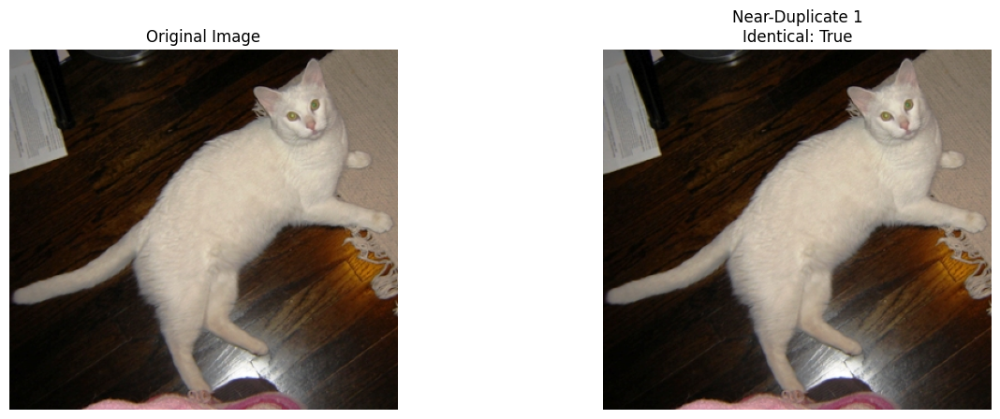

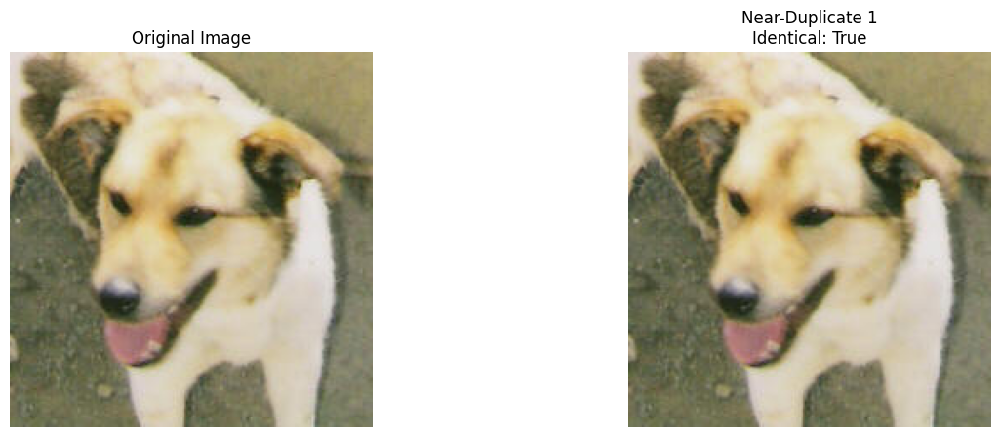

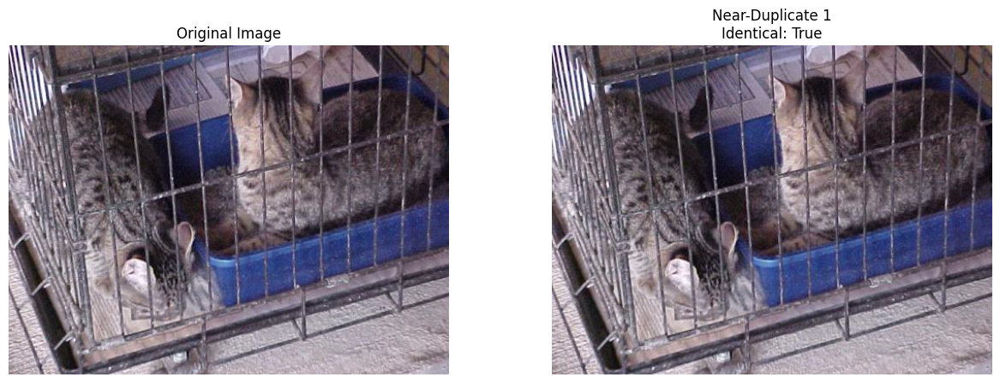

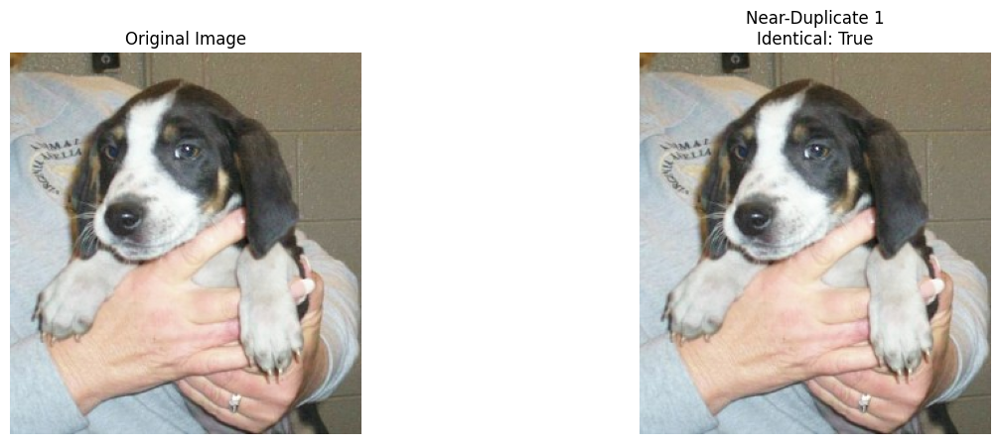

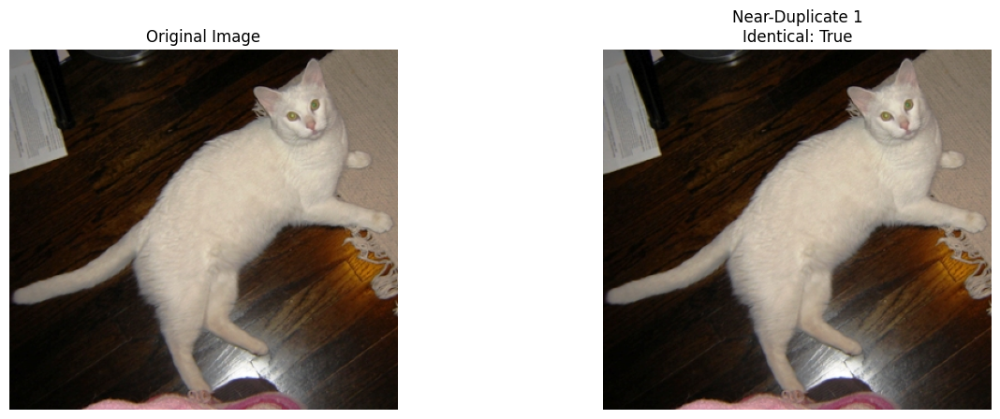

...

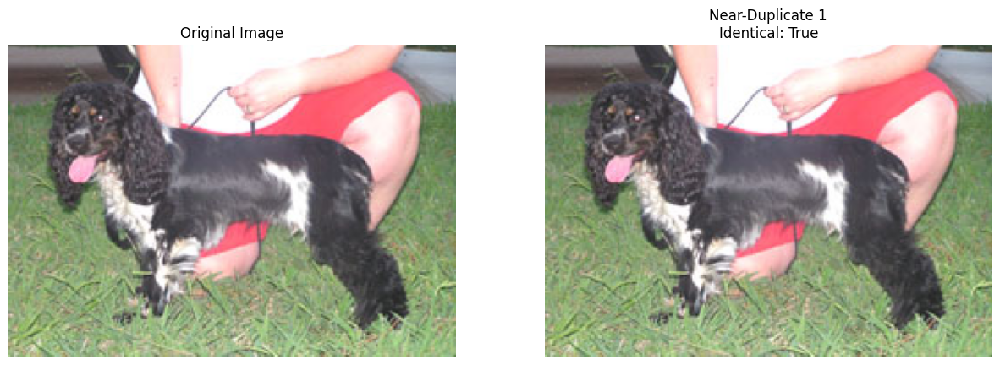

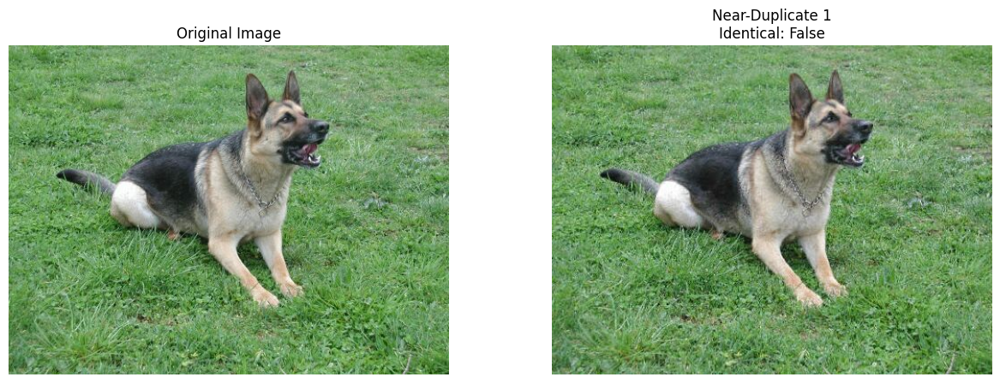

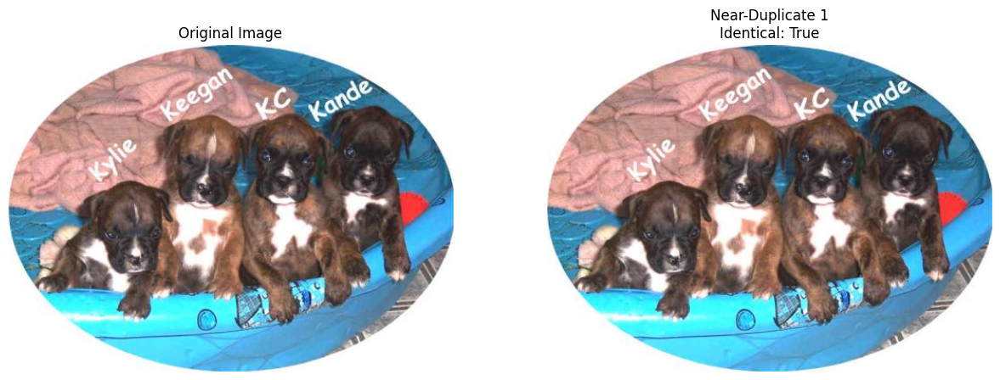

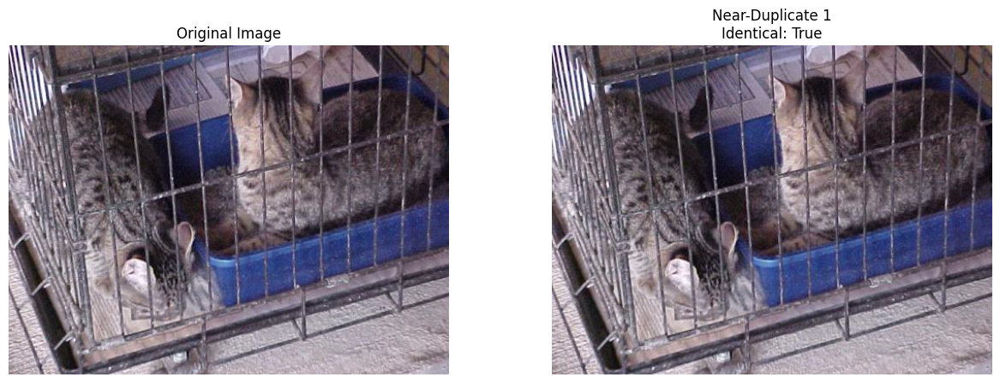

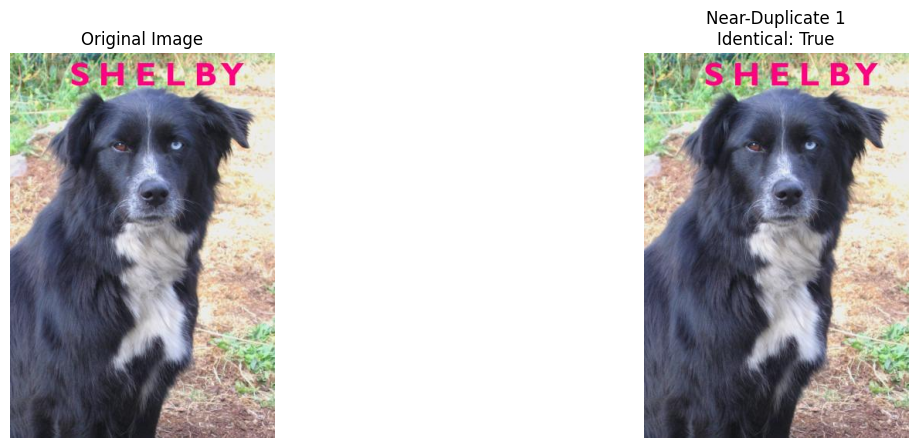

In [122]:
from PIL import Image  # Import the Python Imaging Library for image processing
from matplotlib import pyplot as plt  # Import matplotlib for plotting
import numpy as np  # Import numpy for array operations

# Display the near-duplicate issues

# Randomly sample 30 rows from the filtered near-duplicate issues
# This helps in inspecting a subset of the near-duplicate issues
sampled_issues = near_duplicates.sample(min(30, len(near_duplicates)))

# Iterate over each sampled issue to display the images
for row in sampled_issues.itertuples():
    # Load the original image using the file path from the training DataFrame
    original_image = Image.open(df_train.iloc[row.Index].file)
    original_array = np.array(original_image)

    # Load the near-duplicate images using their file paths from the training DataFrame
    near_duplicate_images = []
    near_duplicate_arrays = []
    for idx in row.near_duplicate_sets:
        img = Image.open(df_train.iloc[idx].file)
        near_duplicate_images.append(img)
        near_duplicate_arrays.append(np.array(img))

    # Create a new figure for displaying the images
    plt.figure(figsize=(15, 5))

    # Display the original image in the first subplot
    plt.subplot(1, len(near_duplicate_images) + 1, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis("off")  # Hide the axis for better visualization

    # Display each near-duplicate image in subsequent subplots
    for i, image in enumerate(near_duplicate_images):
        plt.subplot(1, len(near_duplicate_images) + 1, i + 2)
        plt.imshow(image)

        # Check if images are exactly the same
        are_identical = np.array_equal(original_array, near_duplicate_arrays[i])
        title = f"Near-Duplicate {i + 1}\nIdentical: {are_identical}"
        plt.title(title)
        plt.axis("off")  # Hide the axis for better visualization

    # Show the figure with all the images
    plt.show()

In [119]:
# Sort the outliers DataFrame by the 'outlier_score' column in ascending order
# This helps in identifying the most significant outliers first
outliers = outliers.sort_values("outlier_score", ascending=True)

# Display the sorted outliers DataFrame
outliers

,is_outlier_issue,outlier_score
9900,True,0.065686
9392,True,0.073232
7247,True,0.079008
19733,True,0.081200
11021,True,0.081554
...,...,...
13988,True,0.145552
2704,True,0.146177
13000,True,0.146955
2549,True,0.147673


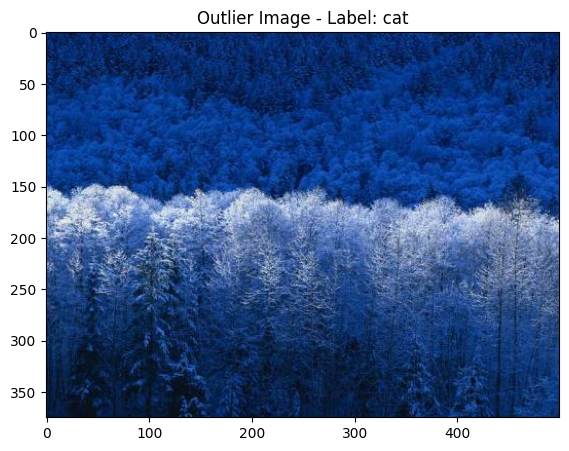

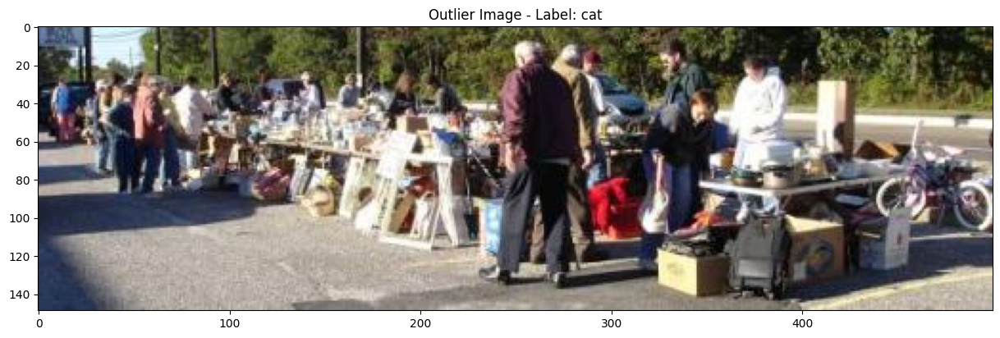

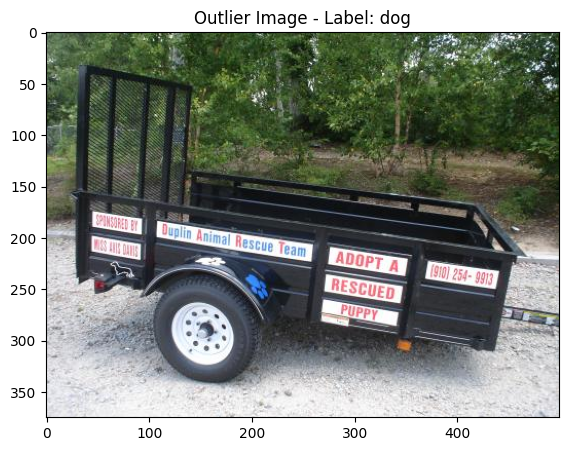

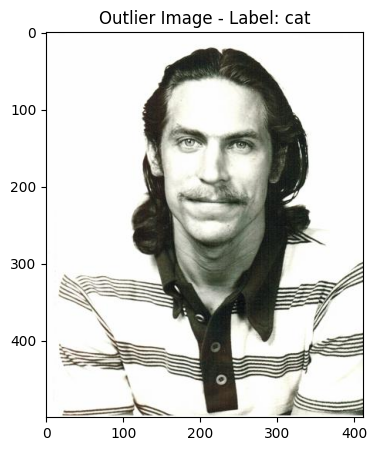

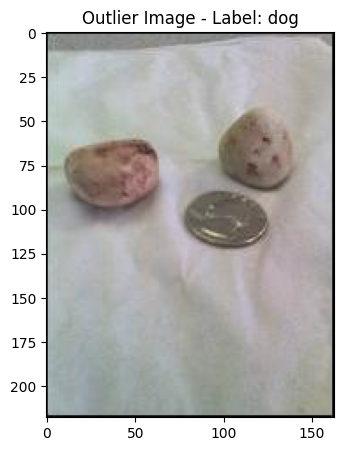

...

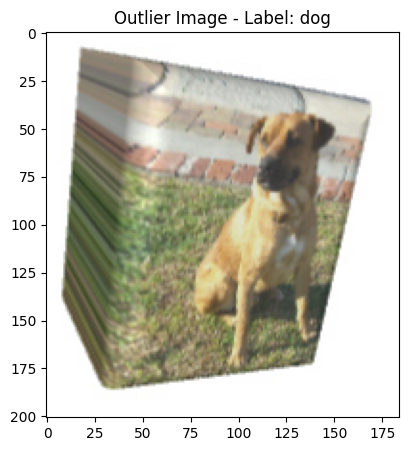

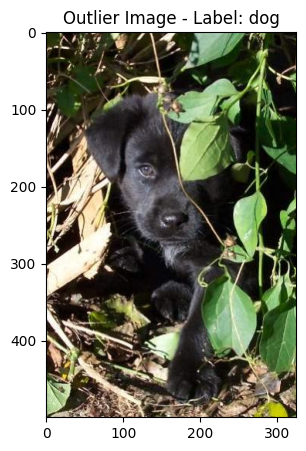

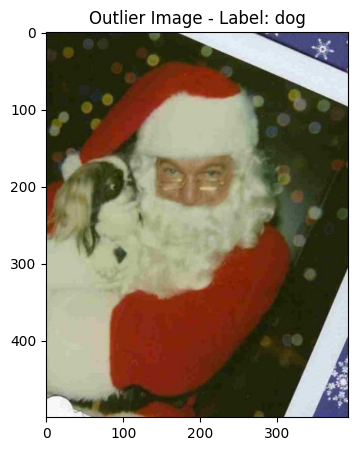

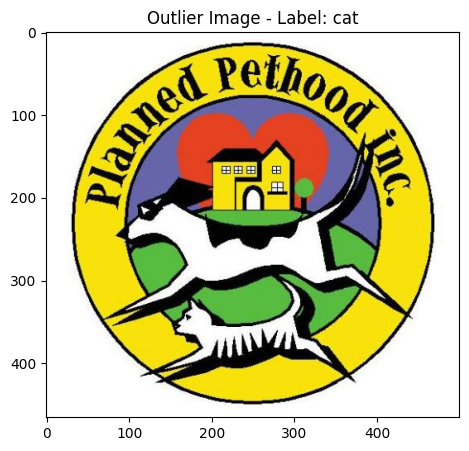

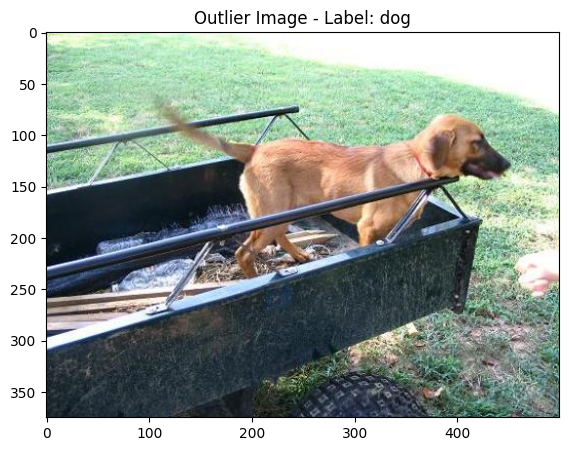

In [68]:
# Display the outlier issues

# Select the top 30 outliers with the lowest outlier scores
sampled_issues = outliers.head(30)

# Iterate over each sampled issue to display the images
for row in sampled_issues.itertuples():
    # Load the image using the file path from the training DataFrame
    original_image = Image.open(df_train.iloc[row.Index].file)

    # Dictionary to convert integer labels to string labels
    int2str = {0: "cat", 1: "dog"}

    # Create a new figure for displaying the image
    plt.figure(figsize=(15, 5))

    # Display the original image
    plt.imshow(original_image)

    # Set the title of the plot to indicate the outlier image and its label
    plt.title(f"Outlier Image - Label: {int2str[df_train.iloc[row.Index].label]}")

    # Show the plot with the image
    plt.show()

In [69]:
# Let's remove the problematic images from the training set

# Print the shape of the training feature set before removing problematic images
print(f"Before removing problematic images: {X_train.shape}")

# Identify the indices of the problematic images
# These are images that are either outliers or near-duplicates
problems_idx_1 = (
    lab.get_issues()
    .query("is_outlier_issue == True or is_near_duplicate_issue == True")
    .index
)

# Remove the problematic images from the training DataFrame and reset the index
df_train_cleaned_1 = df_train.drop(problems_idx_1).reset_index(drop=True)

# Remove the problematic images from the training feature set
X_train_cleaned_1 = np.delete(X_train, problems_idx_1, axis=0)

# Remove the problematic images from the training labels
y_train_cleaned_1 = np.delete(y_train, problems_idx_1, axis=0)

# Print the shape of the training feature set after removing problematic images
print(f"After removing problematic images: {X_train_cleaned_1.shape}")

Before removing problematic images: (19947, 768)
After removing problematic images: (19751, 768)


## Step 1 - Getting out of sample predictions

In [71]:
from helpers.classification import (
    print_classification_metrics,
    train_and_evaluate_classification_models,
)

# Check the performance of the model with the cleaned training data
df_results, creports, _ = train_and_evaluate_classification_models(
    X_train_cleaned_1, y_train_cleaned_1
)

Model: Calibrated-LSVC - F1: 0.9971 - Balanced Accuracy: 0.9971 - Accuracy: 0.9971 - Matthews Correlation Coefficient: 0.9941 - Elapsed time: 40.13s
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      9889
           1       1.00      1.00      1.00      9862

    accuracy                           1.00     19751
   macro avg       1.00      1.00      1.00     19751
weighted avg       1.00      1.00      1.00     19751

[[9853   36]
 [  22 9840]]
******************** 

Model: Logistic Regression - F1: 0.9976 - Balanced Accuracy: 0.9976 - Accuracy: 0.9976 - Matthews Correlation Coefficient: 0.9952 - Elapsed time: 3.11s
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      9889
           1       1.00      1.00      1.00      9862

    accuracy                           1.00     19751
   macro avg       1.00      1.00      1.00     19751
weighted avg       1.00      1.00      1.00     19

In [72]:
df_results.sort_values(by="Matthews Correlation Coefficient", ascending=False)

,Model,F1,Balanced Accuracy,Accuracy,Matthews Correlation Coefficient,Elapsed Time,Confusion Matrix,Classification Report
1,Logistic Regression,0.997620,0.997621,0.997620,0.995241,3.111647,[[9861 28]\n [ 19 9843]],precision recall f1-score ...
4,SGD,0.997165,0.997165,0.997165,0.994330,1.680066,[[9857 32]\n [ 24 9838]],precision recall f1-score ...
0,Calibrated-LSVC,0.997063,0.997064,0.997063,0.994128,40.128162,[[9853 36]\n [ 22 9840]],precision recall f1-score ...
5,K-Nearest Neighbors,0.996760,0.996760,0.996760,0.993520,4.493309,[[9851 38]\n [ 26 9836]],precision recall f1-score ...
2,Random Forest,0.996355,0.996358,0.996355,0.992722,71.919208,[[9828 61]\n [ 11 9851]],precision recall f1-score ...
3,XGBoost,0.996355,0.996357,0.996355,0.992714,51.386706,[[9837 52]\n [ 20 9842]],precision recall f1-score ...
7,Extra Trees,0.996304,0.996308,0.996304,0.992622,13.599029,[[9826 63]\n [ 10 9852]],precision recall f1-score ...
6,Decision Tree,0.978837,0.978836,0.978837,0.957673,421.433891,[[9682 207]\n [ 211 9651]],precision recall f1-score ...


In [73]:
model_lr = LogisticRegression(
    random_state=271828, n_jobs=-1, class_weight="balanced", max_iter=1000
)
skfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=271828)

# Any model would work here, but we are using Logistic Regression for simplicity
out_of_sample_probs = cross_val_predict(
    estimator=model_lr,
    X=X_train_cleaned_1,
    y=y_train_cleaned_1,
    cv=skfold,
    method="predict_proba",
    n_jobs=2,
)

In [74]:
out_of_sample_probs[:5]

array([[9.99939415e-01, 6.05854489e-05],
       [2.10298592e-05, 9.99978970e-01],
       [9.99937893e-01, 6.21074228e-05],
       [3.73815674e-05, 9.99962618e-01],
       [9.96335741e-01, 3.66425899e-03]])

## Step 2 - Applying the Confident Learning algorithm

In [75]:
# Get the label quality scores for each label using the cleanlab library
# Parameters:
# - labels: The true labels of the training data after cleaning
# - pred_probs: The predicted probabilities for each label from the model
# The function returns a score for each label indicating its quality
label_quality_scores = cleanlab.rank.get_label_quality_scores(
    labels=y_train_cleaned_1, pred_probs=out_of_sample_probs
)

# Display the first 5 label quality scores to inspect the results
label_quality_scores[:5]

array([0.99993941, 0.99997897, 0.99993789, 0.99996262, 0.99633574])

In [76]:
# Get the indices of the 5 elements with the lowest label quality scores
# np.argsort(label_quality_scores) returns the indices that would sort the array
# [:5] selects the first 5 indices, which correspond to the lowest scores
top_train_label_quality_scores_idxs = np.argsort(label_quality_scores)[:5]

# Display the indices of the 5 elements with the lowest label quality scores
top_train_label_quality_scores_idxs

array([15658,  3878,  1281, 18451, 16761])

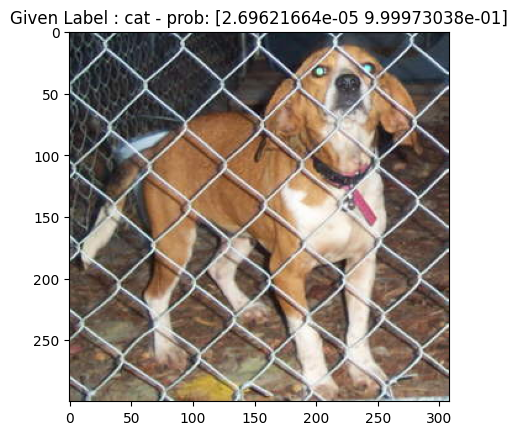

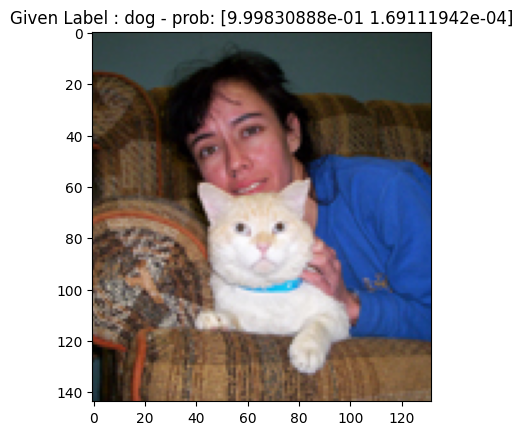

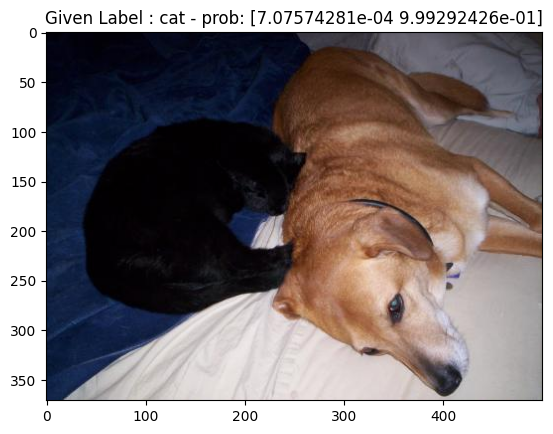

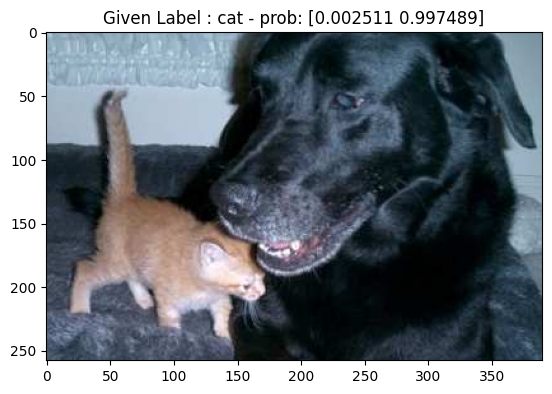

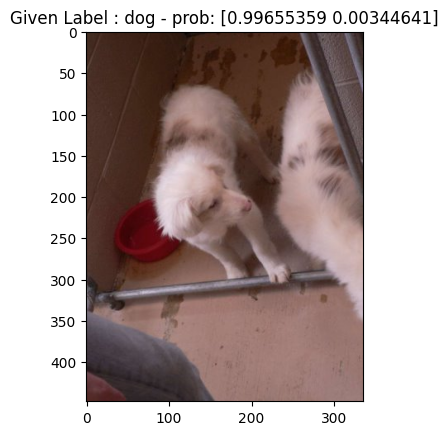

In [77]:
# Check the text and labels of 5 elements with the lowest label quality scores

# Iterate over the indices of the elements with the lowest label quality scores
for i in top_train_label_quality_scores_idxs:
    # Open the image file corresponding to the current index
    img = Image.open(df_train_cleaned_1.iloc[i].file)

    # Display the image using matplotlib
    plt.imshow(img)

    # Dictionary to convert integer labels to string labels
    int2str = {0: "cat", 1: "dog"}

    # Set the title of the plot to show the label and the predicted probabilities
    plt.title(
        f"Given Label : {int2str[y_train_cleaned_1[i]]} - prob: {out_of_sample_probs[i]}"
    )

    # Show the plot with the image
    plt.show()

## Confident Learning Methods

Confident Learning (CL) provides a framework to address the issue of learning from datasets that contain **noisy labels**, that is, instances where some training examples have incorrect labels. Instead of relying solely on the labels provided, CL uses the model's own prediction confidence to identify and rectify mislabeled instances. The key assumption in this framework is **class-conditional noise**, meaning that the probability of a label error depends solely on the true class rather than individual examples.


### Confidence Scores

Confidence scores represent the model's predicted probability for each class when given an input data point. For an input $ x $ and class $ j $, the confidence score is denoted as:
$$
\hat{p}_{x, y=j}
$$
These scores play a central role in CL.

- **High Confidence:** A score such as $\hat{p}_{x, y=j} =0.95 $ indicates that the model is very confident of its prediction.
- **Low Confidence:** A lower score suggests uncertainty regarding the prediction, which might indicate a mislabel or an outlier.

CL uses these scores to detect discrepancies between the model’s prediction and the given label $\tilde{y} $. For instance, if the model is very confident that an image belongs to class $ j $ while the assigned label is $ i $, it raises the possibility of mislabeling. This idea leads to the construction of the **Confident Joint matrix**.


### Joint Distribution of Noisy and True Labels

The basic idea of CL involves undertanding how observed noisy labels $\tilde{y} $ relate to the unobserved true labels $ y^* $. This relationship is modeled by the joint distribution:
$$
P(\tilde{y}, y^*)
$$

- **Mathematical Estimation:**  
CL estimates the joint distribution by counting those examples for which the model is confident. This count is organized into a matrix called the Confident Joint matrix $ C_{\tilde{y}, y^*} $, with elements defined as:
  $$
  C_{\tilde{y}, y^*}[i][j] = \left|\left\{ x \mid \tilde{y}=i,\ \hat{y}^* = j,\ \hat{p}_{x, y=j} \geq t_{ij} \right\}\right|
  $$
  where $ t_{ij} $ is a threshold for the pair of classes $ (i, j) $.

- **Purpose:**  
Estimating the joint distribution allows the calculation of the noise probability for $p(\tilde{y}|y^*)$, which is the probability of observing a label $ \tilde{y} $ given the true label $ y^* $. This is $ m \times n $ matrix, where $ m $ is the number of classes and $ n $ is the number of examples is represented by $\hat{Q}_{\tilde{y}, y^*} $. 
Given the confident joint $C_{\tilde{y},y^*}$, we estimate $Q_{\tilde{y},y^*}$ as:

$$\hat{Q}_{\tilde{y}=i,y^*=j} = \frac{\sum_{j \in [m]} \frac{C_{\tilde{y}=i,y^*=j}}{\sum_{j' \in [m]} C_{\tilde{y}=i,y^*=j'}} \cdot |X_{\tilde{y}=i}|}{\sum_{i \in [m], j \in [m]} \left( \frac{C_{\tilde{y}=i,y^*=j}}{\sum_{j' \in [m]} C_{\tilde{y}=i,y^*=j'}} \cdot |X_{\tilde{y}=i}| \right)} $$

The numerator calibrates $\sum_j \hat{Q}_{\tilde{y}=i,y^*=j} = |X_i|/ \sum_{i \in [m]}|X_i|, \forall i \in [m]$ so that row-sums match the observed marginals. The denominator calibrates $\sum_{i,j} \hat{Q}_{\tilde{y}=i,y^*=j} = 1$ so that the distribution sums to 1.

### Pruning Methods in Confident Learning

Pruning methods in Confident Learning (CL) aim to improve dataset quality by eliminating or down-weighting examples that are likely mislabeled. CL estimates label errors using the model’s predicted probabilities alongside the noisy labels. Two main quantities play a role in this process:

- The **confident joint** $ C_{\tilde{y},y^*} $, an unnormalized count matrix that records the number of examples assigned noisy label $tilde{y} $ and the (unknown) true label $ y^* $.
- The estimated joint probability distribution $hat{Q}_{\tilde{y},y^*} $, which normalizes these counts to approximate the probability of each label pairing (Northcutt et al., 2021, Sec3.1).

Until now, we have used an approach hthat directly leverages the off-diagonal entries of $ C_{\tilde{y},y^*} $ to flag potential label errors. This method corresponds to **"CL method2: $ C_{\tilde{y},y^*} $"** as described in [Northcutt et al., 2021, Section 3.2]((http://arxiv.org/abs/1911.00068)), where the label errors are estimated by the set:

$$
\{x \in \hat{X}_{\tilde{y}=i,y^*=j} : i \neq j\}.
$$

Other strategies use the estimated joint distribution $hat{Q}_{\tilde{y},y^*} $ to determine both the number of examples to prune for each mislabeling pair $ (\tilde{y}=i, y^*=j) $ and the ranking of those examples based on specific criteria. Two common ranking and pruning approaches described in [Northcutt et al., 2021, Section 3.2]((http://arxiv.org/abs/1911.00068)) are outlined below:



#### 1. Prune by Noise Rate (PBNR)

- **Objective:** Identify mislabeled examples by estimating the noise rate between different class pairs.
   
 - **Method:**
     - For every off-diagonal entry in $\hat{Q}_{\tilde{y}=i, y^*=j} $ (where $ i \ne j $), compute
       $$
       n \cdot \hat{Q}_{\tilde{y}=i, y^*=j},
       $$
       where $ n $ is the total number of examples. This value indicates the expected number of mislabeled examples from class $ i $ as class $ j $.

     - From the set $\mathbf{X}_{\tilde{y}=i} $ (all examples with label $ i $), select the $ n \cdot \hat{Q}_{\tilde{y}=i, y^*=j} $ examples that have the largest margin defined by
       $$
       \hat{p}_{\mathbf{x}, \tilde{y}=j} - \hat{p}_{\mathbf{x}, \tilde{y}=i}.
       $$
    
    Here:

    - $\hat{p}_{\mathbf{x}, \tilde{y}=j} $ is the estimated probability for class $ j $ for example $\mathbf{x} $.

    - $\hat{p}_{\mathbf{x}, \tilde{y}=i} $ is the estimated probability for class $ i $ for example $\mathbf{x} $.
       
 - **Insight:** A high margin suggests that the model is more inclined to predict an alternate class $ j $ rather than the assigned class $ i $, marking the example as prime candidate for removal.


#### 2. Prune by Class (PBC)

   - **Objective:** Isolate mislabeled examples within each class by evaluating the model’s self-confidence.
   
 - **Method:**
     - For each class $ i \in [m] $ (where $ m $ is the total number of classes), determine the number of expected mislabels by calculating:
       $$
       n \cdot \sum_{j \in [m]; \, j \ne i} \hat{Q}_{\tilde{y}=i, y^*=j}[i].
       $$

     - Within $\mathbf{X}_i $ (the set of examples labeled $ i $), select the computed number of examples that show the lowest self-confidence, as measured by:
       $$
       \hat{p}(\tilde{y}=i; \mathbf{x} \in \mathbf{X}_i).
       $$
       
 Here, $\hat{p}(\tilde{y}=i; \mathbf{x} \in \mathbf{X}_i) $ is the predicted probability for the label $ i $ associated with example $\mathbf{x} $ in that class.
       
 - **Insight:** Lower self-confidence indicates uncertainty about the assigned label, suggesting a higher risk that the label is incorrect.


#### Comparison of PBNR and PBC

- **PBNR:**  
 Targets mislabeling that occurs between pairs of classes. It requires detailed estimates of noise rates for each class pair but can be more effective when noise patterns vary between classes.
  
- **PBC:**  
 Uses a simpler strategy by evaluating the confidence within each class. Although easier to apply, it might not capture the full complexity of noise that exists between class pairs.


### Robustness to Miscalibration

Machine learning models can suffer from miscalibration, where the predicted probabilities do not accurately represent the true likelihoods. CL remains resilient even when the probabilities are not perfectly calibrated. Key points include:

1. **Thresholding vs. Using Exact Probabilities:**  
 Instead of depending on the exact probability values, CL employs confidence thresholds $ t_{ij} $ to determine if a prediction is reliable. For instance, a threshold for class $ j $ can be set as:
   $$
   t_j = \frac{1}{|X_{\tilde{y} = j}|} \sum_{x \in X_{\tilde{y} = j}} \hat{p}_{x, y = j}
   $$
   This strategy compares the predicted probabilities against an expected average rather than their absolute values.

2. **Relative Comparison of Predictions:**  
 The method focuses on the difference between probabilities. For example, in PBNR, the margin:
   $$
   \text{Margin}_{ij}(x) = \hat{p}_{x, \tilde{y}=j} - \hat{p}_{x, \tilde{y}=i}
   $$
   effectively distinguishes between examples even when the model is generally overconfident or underconfident, as long as the ordering of probabilities is correct.

3. **Counting-Based Methodology:**  
 By aggregating counts over predictions that exceed a given threshold (as organized in the Confident Joint matrix), CL reduces reliance on precise probability estimates. This binning process diminishes the influence of miscalibration by focusing on whether predictions cross the threshold rather than on their exact values.

4. **Strength in Practice:**  
 Since CL prioritizes relative rankings over exact score values, models that struggle with accurate calibration can still perform well under this framework. The approach adjusts thresholds to reflect class-specific behavior, making it effective even when probability estimates are imperfect.


In [78]:
ranked_label_issues_pbnr = cleanlab.filter.find_label_issues(
    y_train_cleaned_1,
    out_of_sample_probs,
    return_indices_ranked_by="self_confidence",
    filter_by="prune_by_noise_rate",  # filters examples with *high probability* of being mislabeled for every non-diagonal in the confident joint. Please see the docs for more options and the paper for understanding the options.
)

print(f"Cleanlab found {len(ranked_label_issues_pbnr)} label issues.")
print(
    f"Top {min(15,len(ranked_label_issues_pbnr))} most likely label errors: \n {ranked_label_issues_pbnr[:min(15,len(ranked_label_issues_pbnr))]}"
)

Cleanlab found 6 label issues.
Top 6 most likely label errors: 
 [15658  3878  1281 18451 16761 15481]


In [79]:
ranked_label_issues_pbc = cleanlab.filter.find_label_issues(
    y_train_cleaned_1,
    out_of_sample_probs,
    return_indices_ranked_by="self_confidence",
    filter_by="prune_by_class",  # filters the examples with *smallest probability* of belonging to their given class label for every class. Please see the docs for more options and the paper for understanding the options.
)

print(f"Cleanlab found {len(ranked_label_issues_pbc)} label issues.")
print(
    f"Top {min(15,len(ranked_label_issues_pbc))} most likely label errors: \n {ranked_label_issues_pbc[:min(15,len(ranked_label_issues_pbc))]}"
)

Cleanlab found 6 label issues.
Top 6 most likely label errors: 
 [15658  3878  1281 18451 16761 15481]


In [80]:
ranked_label_issues_pbnr_pbc = cleanlab.filter.find_label_issues(
    y_train_cleaned_1,
    out_of_sample_probs,
    return_indices_ranked_by="self_confidence",
    filter_by="both",  # filters only those examples that would be filtered by both ``'prune_by_noise_rate'`` and ``'prune_by_class'``. Please see the docs for more options and the paper for understanding the options.
)

print(f"Cleanlab found {len(ranked_label_issues_pbnr_pbc)} label issues.")
print(
    f"Top {min(15,len(ranked_label_issues_pbnr_pbc))} most likely label errors: \n {ranked_label_issues_pbnr_pbc[:min(15,len(ranked_label_issues_pbnr_pbc))]}"
)

Cleanlab found 6 label issues.
Top 6 most likely label errors: 
 [15658  3878  1281 18451 16761 15481]


In [81]:
ranked_label_issues_cl = cleanlab.filter.find_label_issues(
    y_train_cleaned_1,
    out_of_sample_probs,
    return_indices_ranked_by="self_confidence",
    filter_by="confident_learning",  # filters the examples counted as part of the off-diagonals of the confident joint. These are the examples that are confidently predicted to be a different label than their given label. Please see the docs for more options and the paper for understanding the options.
)

print(f"Cleanlab found {len(ranked_label_issues_cl)} label issues.")
print(
    f"Top {min(15,len(ranked_label_issues_cl))} most likely label errors: \n {ranked_label_issues_cl[:min(15,len(ranked_label_issues_cl))]}"
)

Cleanlab found 6 label issues.
Top 6 most likely label errors: 
 [15658  3878  1281 18451 16761 15481]


In [82]:
# Find label issues that are in ranked_label_issues_cl but not in ranked_label_issues_pbnr_pbc
# Convert both lists to sets and use the difference method to find unique elements
in_ranked_label_issues_cl_not_in_ranked_label_issues_pbnr_pbc = list(
    set(ranked_label_issues_cl).difference(set(ranked_label_issues_pbnr_pbc))
)

# Find label issues that are in ranked_label_issues_pbnr_pbc but not in ranked_label_issues_cl
# Convert both lists to sets and use the difference method to find unique elements
in_ranked_label_issues_pbnr_pbc_not_in_ranked_label_issues_cl = list(
    set(ranked_label_issues_pbnr_pbc).difference(set(ranked_label_issues_cl))
)

# Print the number of label issues unique to ranked_label_issues_cl
print(
    f"There are {len(in_ranked_label_issues_cl_not_in_ranked_label_issues_pbnr_pbc)} label issues in ranked_label_issues_cl that are not in ranked_label_issues_pbnr_pbc."
)

# Print the number of label issues unique to ranked_label_issues_pbnr_pbc
print(
    f"There are {len(in_ranked_label_issues_pbnr_pbc_not_in_ranked_label_issues_cl)} label issues in ranked_label_issues_pbnr_pbc that are not in ranked_label_issues_cl."
)

There are 0 label issues in ranked_label_issues_cl that are not in ranked_label_issues_pbnr_pbc.
There are 0 label issues in ranked_label_issues_pbnr_pbc that are not in ranked_label_issues_cl.


In [83]:
# check if both arrays are equal. In this case, they are. But that is not always the case.
np.array_equal(ranked_label_issues_pbnr, ranked_label_issues_pbc)

True

In [84]:
flagged_by_at_least_one_method = np.unique(
    np.concatenate(
        [
            ranked_label_issues_pbnr,
            ranked_label_issues_pbc,
            ranked_label_issues_cl,
            ranked_label_issues_pbnr_pbc,
        ]
    )
)
flagged_by_at_least_one_method

array([ 1281,  3878, 15481, 15658, 16761, 18451])

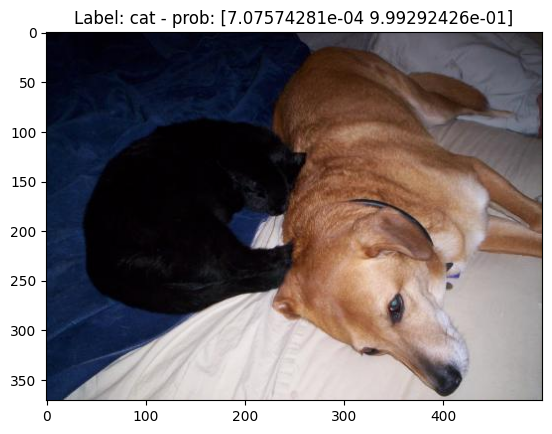

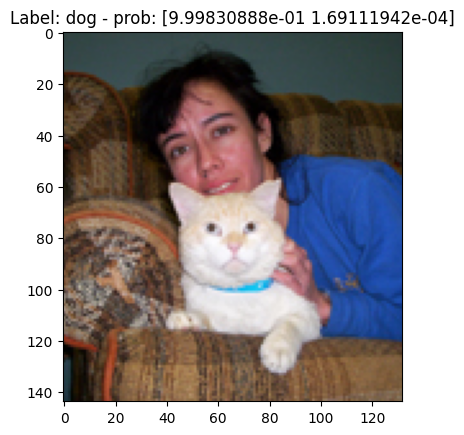

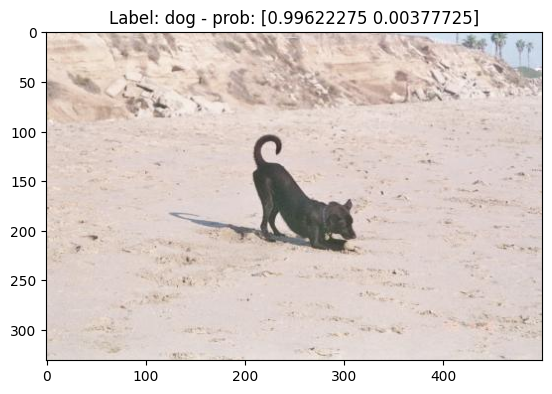

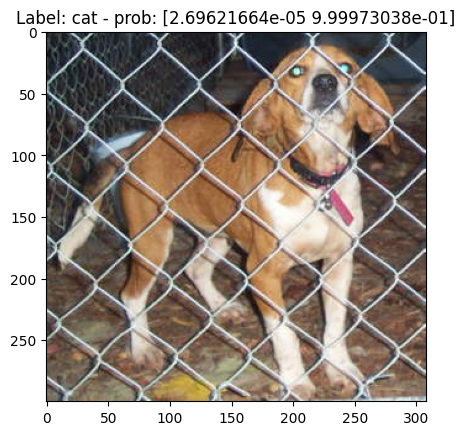

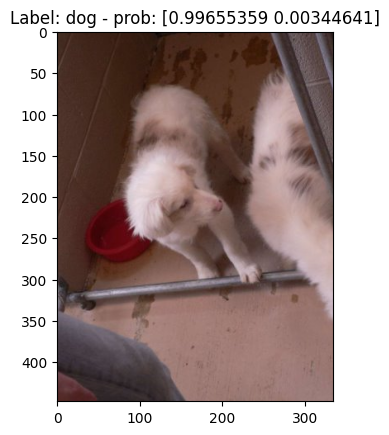

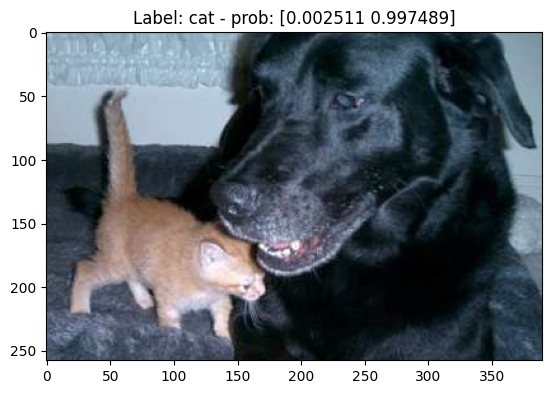

In [85]:
# Check the text and labels of elements flagged by at least one method

# Iterate over the indices of the elements flagged by at least one method
for i in flagged_by_at_least_one_method:
    # Open the image file corresponding to the current index
    img = Image.open(df_train_cleaned_1.iloc[i].file)

    # Display the image using matplotlib
    plt.imshow(img)

    # Dictionary to convert integer labels to string labels
    int2str = {0: "cat", 1: "dog"}

    # Set the title of the plot to show the label and the predicted probabilities
    plt.title(
        f"Label: {int2str[y_train_cleaned_1[i]]} - prob: {out_of_sample_probs[i]}"
    )

    # Show the plot with the image
    plt.show()

In [86]:
# Use the health_summary function from cleanlab to generate a summary of the label errors
cleanlab.dataset.health_summary(
    labels=y_train_cleaned_1,
    pred_probs=out_of_sample_probs,
)

-----------------------------------------------------------
|  Generating a Cleanlab Dataset Health Summary           |
|   for your dataset with 19,751 examples and 2 classes.  |
|  Note, Cleanlab is not a medical doctor... yet.         |
-----------------------------------------------------------

Overall Class Quality and Noise across your dataset (below)
------------------------------------------------------------ 



,Class Index,Label Issues,Inverse Label Issues,Label Noise,Inverse Label Noise,Label Quality Score
0,1,3,3,0.000304,0.000304,0.999696
1,0,3,3,0.000303,0.000303,0.999697



Class Overlap. In some cases, you may want to merge classes in the top rows (below)
-----------------------------------------------------------------------------------



,Class Index A,Class Index B,Num Overlapping Examples,Joint Probability
0,0,1,6,0.000304



 * Overall, about 0% (6 of the 19,751) labels in your dataset have potential issues.
 ** The overall label health score for this dataset is: 1.00.

Generated with <3 from Cleanlab.



{'overall_label_health_score': 0.9996962179130171,
 'joint': array([[5.00531619e-01, 1.51891043e-04],
        [1.51891043e-04, 4.99164599e-01]]),
 'classes_by_label_quality':    Class Index  Label Issues  Inverse Label Issues  Label Noise  \
 0            1             3                     3     0.000304   
 1            0             3                     3     0.000303   
 
    Inverse Label Noise  Label Quality Score  
 0             0.000304             0.999696  
 1             0.000303             0.999697  ,
 'overlapping_classes':    Class Index A  Class Index B  Num Overlapping Examples  Joint Probability
 0              0              1                         6           0.000304}

In [87]:
# Estimate the class prior probabilities, noise matrices, and confident joint using Cleanlab
# Parameters:
# - y_train_cleaned_1: The true labels of the training data after cleaning
# - out_of_sample_probs: The predicted probabilities for each label from the model
# The function returns:
# - py: The estimated class prior probabilities
# - noise_matrix: The estimated noise matrix, which shows the probability of each label being flipped to another label
# - inverse_noise_matrix: The inverse of the noise matrix
# - confident_joint: The confident joint matrix, which shows the number of examples confidently labeled as one class but predicted as another
py, noise_matrix, inverse_noise_matrix, confident_joint = (
    cleanlab.count.estimate_py_and_noise_matrices_from_probabilities(
        y_train_cleaned_1, out_of_sample_probs
    )
)

In [88]:
# py: prob(true_label=k)
# For all classes K, this is the distribution over the actual true labels (which cleanlab can estimate for you even though you don’t have the true labels)
py

array([0.50068351, 0.49931649])

In [89]:
# noise_matrix: p(noisy|true)
# This describes how errors were introduced into your labels. It’s a conditional probability matrix with the probability of flipping from the true class to every other class for the given label.
cleanlab.internal.util.print_noise_matrix(noise_matrix)


 Noise Matrix (aka Noisy Channel) P(given_label|true_label) of shape (2, 2)
 p(s|y)	y=0	y=1
	---	---
s=0 |	1.0	0.0
s=1 |	0.0	1.0
	Trace(matrix) = 2.0



In [90]:
# inverse_noise_matrix: p(true|noisy)
# This tells you the probability, for every class, that the true label is actually a different class.
inverse_noise_matrix

array([[9.99696633e-01, 3.04197931e-04],
       [3.03367378e-04, 9.99695802e-01]])

In [91]:
# confident_joint
# This is an unnormalized (count-based) estimate of the number of examples in our dataset with each possible (true label, given label) pairing.
confident_joint

array([[9886,    3],
       [   3, 9859]])

In [92]:
# joint: p(true label, noisy label)
# The joint distribution of noisy (given) and true labels is the most useful of all these statistics. From it, you can compute every other statistic listed above. One entry from this matrix can be interpreted as: “The proportion of examples in our dataset whose true label is y and given label is s”.

joint = cleanlab.count.estimate_joint(
    y_train_cleaned_1, out_of_sample_probs, confident_joint=confident_joint
)
cleanlab.internal.util.print_joint_matrix(joint)


 Joint Label Noise Distribution Matrix P(given_label, true_label) of shape (2, 2)
 p(s,y)	y=0	y=1
	---	---
s=0 |	0.5	0.0
s=1 |	0.0	0.5
	Trace(matrix) = 1.0



In [93]:
cleanlab.dataset.overall_label_health_score(
    y_train_cleaned_1,
    confident_joint=confident_joint,
    # cleanlab uses the confident_joint internally to quantify label noise (see cleanlab.count.compute_confident_joint)
)

 * Overall, about 0% (6 of the 19,751) labels in your dataset have potential issues.
 ** The overall label health score for this dataset is: 1.00.


0.9996962179130171

## Step 3 - Use the label quality scores to filter out the noisy labels.

In our case, we have a binary classification problem. One possible solution to the label errors is just flip them to the other class. This is a simple and effective solution. We can use the `ranked_label_issues` function to filter out the noisy labels and flip them to the other class.

Another possible solution (i.e. a more complex solution) is to use the label quality scores to filter out the noisy labels and use some inference method to get new labels. This is particularly useful if you have a multi-class problem. We won't cover this, but I'm sure you can figure it out.

One final possible solution is to just drop instances with noisy labels. This is a simple solution, but it can be effective in cases like ours, where we have a lot of data and little noise.

We will be dropping the noisy examples.

In [123]:
# Print the shape of the training feature set before removing additional problematic images
print(f"Before removing problematic images: {X_train_cleaned_1.shape}")

# Remove the images flagged by at least one method from the training DataFrame and reset the index
df_train_cleaned_2 = df_train_cleaned_1.drop(
    flagged_by_at_least_one_method
).reset_index(drop=True)

# Remove the flagged images from the training feature set
X_train_cleaned_2 = np.delete(X_train_cleaned_1, flagged_by_at_least_one_method, axis=0)

# Remove the flagged images from the training labels
y_train_cleaned_2 = np.delete(y_train_cleaned_1, flagged_by_at_least_one_method, axis=0)

# Print the shape of the training feature set after removing additional problematic images
print(f"After removing problematic images: {X_train_cleaned_2.shape}")

Before removing problematic images: (19751, 768)
After removing problematic images: (19745, 768)


## Checking Image Quality with [CleanVision](https://github.com/cleanlab/cleanvision)

CleanVision detects several types of issues that may reduce the effectiveness of a computer vision project. Each issue described below with its characteristics, practical examples, and potential consequences:

1. **Light**
   - **Description**: Images that are overly bright or appear washed out.
   - **Issue Key**: `light`
   - **Example**: A photograph where details in bright areas lost due to overexposure.
   - **Consequences**: Excessive brightness can obscure important details, leading to difficulties in feature extraction and possibly degrading model accuracy.

2. **Dark**
   - **Description**: Images that are unusually dark, making it difficult to distinguish details.
   - **Issue Key**: `dark`
   - **Example**: An image where key subjects are hidden by strong shadows or underexposure.
   - **Repercussions**: Dark images may result in the loss of important visual information, impairing the model's ability to learn from the data.

3. **Odd Aspect Ratio**
   - **Description**: Images with dimensions that do not align with the typical aspect ratios expected in the dataset (e.g., extremely wide or thin images).
   - **Issue Key**: `odd_aspect_ratio`
   - **Example**: A panoramic picture that is much wider compared to its height.
   - **Effects**: Inconsistent aspect ratios can disrupt the learning process by introducing unexpected variations in shape and spatial features.

4. **Exact Duplicates**
   - **Description**: Images that are exactly identical, replicating the same content.
   - **Issue Key**: `exact_duplicates`
   - **Example**: Two or more images that are pixel-wise the same even if saved under different filenames.
   - **Consequences**: Duplicate images may lead to redundancy, potentially biasing the model if it concentrates on repeated data.

5. **Near Duplicates**
   - **Description**: Images that are nearly identical in appearance but may have minor differences (e.g., different filters or adjustments).
   - **Issue Key**: `near_duplicates`
   - **Example**: Images captured in quick succession with slight color variations.
   - **Effects**: Such images can cause the model to focus on small, insignificant variations rather than on the general features needed for stable learning.

6. **Blurry**
   - **Description**: Images lacking clear focus, resulting in a loss of sharpness.
   - **Issue Key**: `blurry`
   - **Example**: A photograph captured with a motion blur effect due to camera shake.
   - **Effects**: Blurry images reduce clarity in edge details and textures, which are essential for accurate feature extraction.

7. **Grayscale**
   - **Description**: Images that lack color information, presented only in shades of gray.
   - **Issue Key**: `grayscale`
   - **Example**: A black-and-white photo included a collection expected to contain color images.
   - **Repercussions**: If the model is trained to recognize color-based features, grayscale images may introduce inconsistency and affect model performance.

8. **Low Information**
   - **Description**: Images that do not contain significant visual content, such as nearly blank images.
   - **Issue Key**: `low_information`
   - **Example**: An image that is predominantly a single color with minimal variation.
   - **Repercussions**: These images contribute little to the learning process, leading to inefficient use of computational resources during training.

9. **Odd Size**
   - **Description**: Images with dimensions that significantly differ from the majority of the dataset, either too large or too small.
   - **Issue Key**: `odd_size`
   - **Example**: A small icon-like image within a dataset primarily composed of high-resolution photographs.
   - **Repercussions**: Variations in image size can complicate batch processing, possibly affecting the consistency of feature extraction across the dataset.


In [127]:
from cleanvision import Imagelab

# Create an Imagelab object with the train data
img_lab = Imagelab(data_path="data/dogs-vs-cats/train")

# Use the Imagelab object to find issues with the images
img_lab.find_issues()

Reading images from /media/nas-elias/drive/UFRN/Disciplinas/2025-1/imd3011-datacentric_ai/data/dogs-vs-cats/train
Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/19947 [00:00<?, ?it/s]

  0%|          | 0/19947 [00:00<?, ?it/s]

Issue checks completed. 98 issues found in the dataset. To see a detailed report of issues found, use imagelab.report().


Issues found in images in order of severity in the dataset

|    | issue_type       |   num_images |
|---:|:-----------------|-------------:|
|  0 | blurry           |           42 |
|  1 | exact_duplicates |           38 |
|  2 | near_duplicates  |            8 |
|  3 | odd_aspect_ratio |            5 |
|  4 | low_information  |            4 |
|  5 | light            |            1 |
|  6 | dark             |            0 |
|  7 | odd_size         |            0 |
|  8 | grayscale        |            0 | 

---------------------- blurry images -----------------------

Number of examples with this issue: 42
Examples representing most severe instances of this issue:



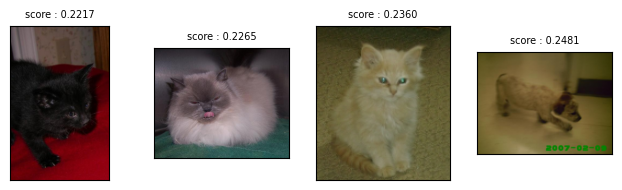

----------------- exact_duplicates images ------------------

Number of examples with this issue: 38
Examples representing most severe instances of this issue:

Set: 0


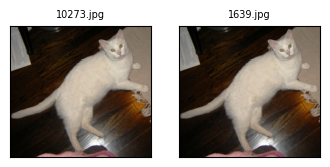

Set: 1


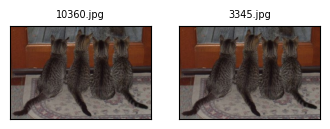

Set: 2


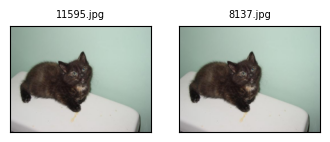

Set: 3


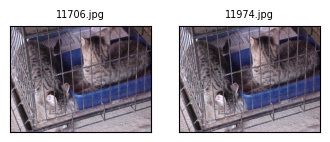

------------------ near_duplicates images ------------------

Number of examples with this issue: 8
Examples representing most severe instances of this issue:

Set: 0


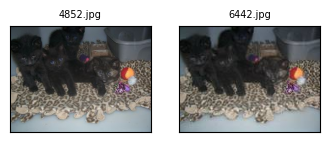

Set: 1


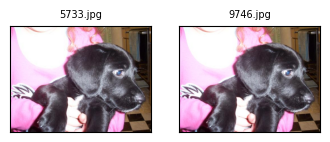

Set: 2


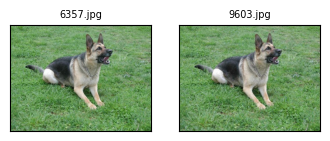

Set: 3


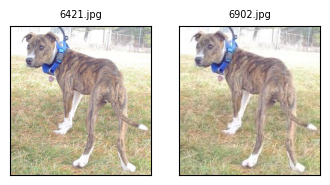

----------------- odd_aspect_ratio images ------------------

Number of examples with this issue: 5
Examples representing most severe instances of this issue:



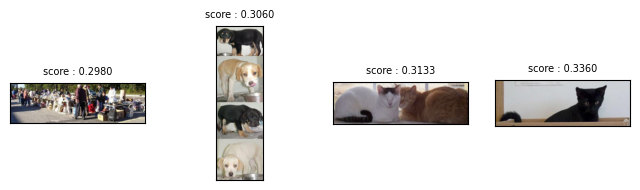

------------------ low_information images ------------------

Number of examples with this issue: 4
Examples representing most severe instances of this issue:



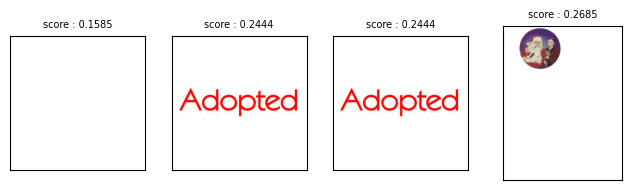

----------------------- light images -----------------------

Number of examples with this issue: 1
Examples representing most severe instances of this issue:



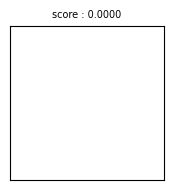

In [128]:
img_lab.report()

In [129]:
img_lab.issue_summary

,issue_type,num_images
0,blurry,42
1,exact_duplicates,38
2,near_duplicates,8
3,odd_aspect_ratio,5
4,low_information,4
5,light,1
6,dark,0
7,odd_size,0
8,grayscale,0


In [130]:
img_lab.issues.head()

,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
/media/nas-elias/drive/UFRN/Disciplinas/2025-1/imd3011-datacentric_ai/data/dogs-vs-cats/train/CAT/0.jpg,0.928571,False,0.750000,False,0.886329,False,0.916612,False,1,False,0.915625,False,0.419102,False,1.0,False,1.0,False
/media/nas-elias/drive/UFRN/Disciplinas/2025-1/imd3011-datacentric_ai/data/dogs-vs-cats/train/CAT/1.jpg,0.878014,False,0.936667,False,0.870913,False,0.920491,False,1,False,0.679669,False,0.389699,False,1.0,False,1.0,False
/media/nas-elias/drive/UFRN/Disciplinas/2025-1/imd3011-datacentric_ai/data/dogs-vs-cats/train/CAT/10.jpg,0.845255,False,0.978000,False,0.926407,False,0.947426,False,1,False,0.916317,False,0.478126,False,1.0,False,1.0,False
/media/nas-elias/drive/UFRN/Disciplinas/2025-1/imd3011-datacentric_ai/data/dogs-vs-cats/train/CAT/100.jpg,0.907050,False,0.806000,False,0.910463,False,0.741769,False,1,False,0.995705,False,0.507646,False,1.0,False,1.0,False
/media/nas-elias/drive/UFRN/Disciplinas/2025-1/imd3011-datacentric_ai/data/dogs-vs-cats/train/CAT/10000.jpg,0.981591,False,0.835267,False,0.782567,False,0.968627,False,1,False,0.956350,False,0.805295,False,1.0,False,1.0,False


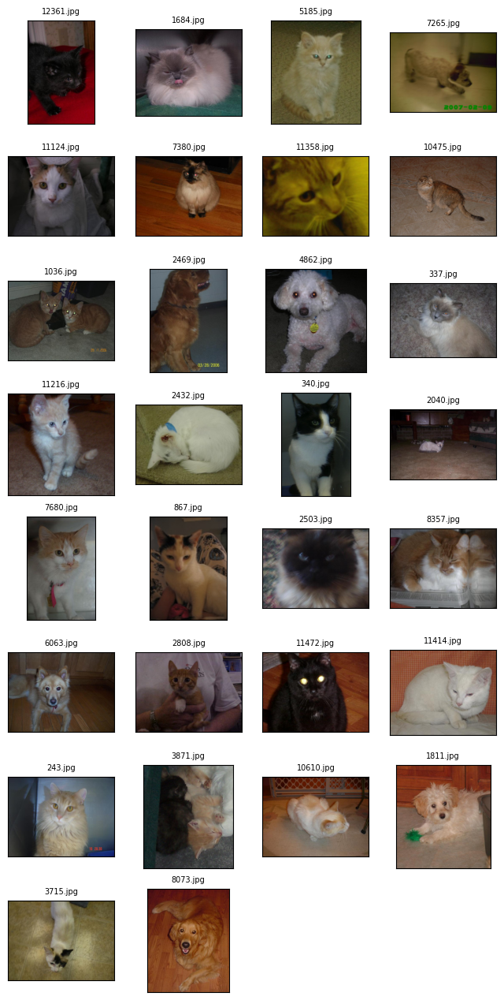

In [131]:
# Filter the DataFrame 'img_lab.issues' to include only rows where 'is_blurry_issue' is True
# Sort the filtered DataFrame by the 'blurry_score' column in ascending order
blurry_images = img_lab.issues[img_lab.issues["is_blurry_issue"] == True].sort_values(
    by=["blurry_score"]
)

# Convert the index of the sorted DataFrame to a list of image file names
blurry_image_files = blurry_images.index.tolist()

# Visualize the first 30 blurry images using the 'visualize' method of the 'img_lab' object
# Parameters:
# - image_files: A list of image file names to visualize
img_lab.visualize(image_files=blurry_image_files[:30])

## Using Confident Learning on NER Datasets

This section explains how to apply **Confident Learning** to a Named Entity Recognition (NER) dataset. The dataset will be introduced in [Notebook 07](Notebook_07.ipynb). It contains NER annotations that might include some errors. The aim is to improve dataset quality by identifying and handling incorrect or noisy labels, which can lead to enhanced performance of NER models. The whole idea is generally very similar, but the implementation is different. The main difference is that we will be applying it to a sequence labeling task, where we have a sequence of labels for each text. This is a bit more complex than the image classification task, but the idea is the same: we will be using the Confident Learning algorithm to identify and handle noisy labels in the dataset.

### Overview of the Process

The application of Confident Learning on the NER dataset involves the following steps:

1. **Loading the Dataset**  
    - Begin with the weakly labeled NER dataset from [Notebook 07](Notebook_07.ipynb). 
    - Recognize that this dataset may include noisy annotations, which could affect model training.

2. **Identifying Noisy Labels**  
    - Use Confident Learning techniques to calculate a *confidence score* for each label.
    - Flag labels with confidence scores below a defined threshold as potential errors.

3. **Correcting Noisy Labels**  
 - Once labels with low confidence scores are identified, decide on one of the following approaches:
     - **Manual Correction**: Involves human review of flagged labels. Although this method can provide high accuracy, it is resource-intensive, especially for large datasets.
     - **Automated Correction**: Adjust labels automatically based on confidence scores. This method can scale to larger datasets but requires careful tuning to prevent the introduction of new errors.

4. **Evaluating Dataset Quality**  
    - Assess improvements by comparing the dataset before and after the application of Confident Learning.
        - Train an NER model on both the original and corrected datasets.
    - Evaluate model performance using metrics such as:
        - **Precision**: The ratio of correctly predicted entities to the total predicted entities.
        - **Recall**: The ratio of correctly predicted entities to the total actual entities.
        - **F1-Score**: The harmonic mean of precision and recall


In [1]:
import datasets  # Import the datasets module from the Hugging Face library

# Load the true labels dataset from disk
hf_dataset_train_true = datasets.load_from_disk("outputs/ner/hf_dataset_train_true")

# Load the hmm model predictions dataset from disk
hf_dataset_train_hmm = datasets.load_from_disk("outputs/ner/hf_dataset_train_hmm")

# Display the hmm model predictions dataset
hf_dataset_train_hmm

Dataset({
    features: ['tokens', 'ner_tags', 'text', 'hash'],
    num_rows: 10000
})

In [2]:
# Extract the list of entity names from the 'ner_tags' feature of the HMM predictions dataset
entities = hf_dataset_train_hmm.features["ner_tags"].feature.names

# Create a dictionary to map each entity label to its corresponding index
label_to_index = {
    label: hf_dataset_train_hmm.features["ner_tags"].feature.str2int(label)
    for label in entities
}

# Create a reverse mapping dictionary to map each index back to its corresponding entity label
index_to_label = {idx: label for label, idx in label_to_index.items()}

# Display the label to index mapping dictionary
label_to_index

{'O': 0, 'B-MEDICAMENTO': 1, 'I-MEDICAMENTO': 2}

## Generating Out-of-Sample Predictions for Confident Learning

Applying Confident Learning to a Named Entity Recognition (NER) dataset necessitates generating out-of-sample predictions. These predictions are critical as they form the foundation for calculating label quality scores and subsequently identifying potential label errors within the dataset. 

As usual, a reliable method to achieve this is through **cross-validation**. regarding our NER task, cross-validation helps us obtain out-of-sample predictions for every data point in the dataset. These predictions, distinct from those generated during training, provide an unbiased assessment of the model's performance and serve as valuable input for Confident Learning. 

In [3]:
import helpers.transformer  # Import custom helper functions for transformer models
from datetime import datetime  # Import datetime module to handle date and time
import warnings  # Import warnings module to manage warnings

# Define the model name for the BERT model in Portuguese
MODEL_NAME = "neuralmind/bert-base-portuguese-cased"

# Suppress warnings within this block
with warnings.catch_warnings():
    warnings.simplefilter("ignore")  # Ignore all warnings

    # Get training arguments for the transformer model
    training_args = helpers.transformer.get_training_arguments(
        output_dir=f"./tmp/ner_{datetime.now().strftime('%Y%m%d_%H%M%S')}",  # Output directory with timestamp
        learning_rate=5e-5,  # Learning rate for the optimizer
        per_device_train_batch_size=16,  # Batch size for training
        per_device_eval_batch_size=16,  # Batch size for evaluation
        num_train_epochs=5,  # Number of training epochs
        weight_decay=0.01,  # Weight decay for regularization
        eval_accumulation_steps=10,  # Steps to accumulate evaluation results
        seed=271828,  # Random seed for reproducibility
        bf16=False,  # Use bfloat16 precision (set to False)
        fp16=True,  # Use float16 precision (set to True)
        gradient_accumulation_steps=4,  # Steps to accumulate gradients
    )

    # Perform cross-validation prediction for Named Entity Recognition (NER)
    predicted_dataset = helpers.transformer.cross_val_predict_ner(
        hf_dataset=hf_dataset_train_hmm,  # Input dataset for majority voter predictions
        model_checkpoint_path=MODEL_NAME,  # Path to the pre-trained model checkpoint
        training_args=training_args,  # Training arguments defined above
        id_to_label=index_to_label,  # Mapping from index to label
        random_state=271828,  # Random state for reproducibility
        n_splits_kfold=10,  # Number of splits for K-Fold cross-validation
    )

# WARNING: This cell may take a long time to run, depending on your hardware and the dataset size. In our case, it will take around 5 hours to run in 2 GPUs

Label to ID mapping: {'O': 0, 'B-MEDICAMENTO': 1, 'I-MEDICAMENTO': 2}
ID to label mapping: {0: 'O', 1: 'B-MEDICAMENTO', 2: 'I-MEDICAMENTO'}
Number of labels: 3


Folds:   0%|          | 0/10 [00:00<?, ?it/s]

Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

wandb: WARNING The `run_name` is currently set to the same value as `TrainingArguments.output_dir`. If this was not intended, please specify a different run name by setting the `TrainingArguments.run_name` parameter.
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: eliasjacob to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.006200,0.024220,0.797192,0.940420,0.862903,0.991790
2,0.007500,0.018200,0.843924,0.955963,0.896456,0.993771
3,0.007900,0.017734,0.863663,0.961143,0.909799,0.994612
4,0.008400,0.016089,0.890052,0.951892,0.919934,0.995282


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.013800,0.019748,0.835244,0.942704,0.885727,0.993301
2,0.006000,0.017183,0.860613,0.966898,0.910665,0.994711
3,0.007800,0.013912,0.898496,0.952082,0.924513,0.995704
4,0.007900,0.013615,0.909309,0.959959,0.933948,0.996205


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.009700,0.024595,0.808597,0.927910,0.864155,0.991455
2,0.008600,0.019311,0.844515,0.949978,0.894147,0.993322
3,0.005100,0.017265,0.871206,0.961229,0.914006,0.994518
4,0.008100,0.016016,0.900832,0.955950,0.927573,0.995476


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.018000,0.023586,0.832126,0.950294,0.887293,0.992477
2,0.012200,0.018185,0.862799,0.960632,0.909091,0.993986
3,0.001700,0.016433,0.889971,0.952609,0.920225,0.994792
4,0.006900,0.015654,0.901125,0.954264,0.926933,0.995287


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.011400,0.023385,0.836662,0.931677,0.881617,0.992209
2,0.014200,0.019463,0.859857,0.960970,0.907606,0.994002
3,0.008800,0.017284,0.884100,0.957193,0.919196,0.994763
4,0.008600,0.017042,0.899416,0.956186,0.926932,0.995327


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.023300,0.024904,0.791060,0.952270,0.864212,0.991369
2,0.007200,0.017444,0.866427,0.947354,0.905085,0.994183
3,0.003800,0.016043,0.891760,0.946997,0.918549,0.995117
4,0.005800,0.014904,0.903463,0.956114,0.929043,0.995757


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.013000,0.021498,0.829063,0.931433,0.877272,0.992724
2,0.009000,0.016544,0.860124,0.963333,0.908808,0.994625
3,0.008600,0.013642,0.898091,0.957283,0.926743,0.995759
4,0.008500,0.013818,0.907385,0.961866,0.933832,0.996176


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.010400,0.024403,0.798292,0.947780,0.866637,0.991464
2,0.006400,0.016907,0.857860,0.957299,0.904856,0.994102
3,0.003900,0.015184,0.892185,0.952584,0.921396,0.995126
4,0.007700,0.015027,0.898161,0.955609,0.925995,0.995413


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.009300,0.021940,0.827115,0.938952,0.879492,0.992499
2,0.010800,0.017094,0.866909,0.961159,0.911604,0.994418
3,0.006200,0.014240,0.891471,0.966990,0.927696,0.995566
4,0.006500,0.013913,0.906147,0.964417,0.934374,0.995988


Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/9000 [00:00<?, ? examples/s]

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.020700,0.021299,0.832071,0.919158,0.873449,0.992516
2,0.006100,0.017922,0.846618,0.954382,0.897276,0.993787
3,0.005300,0.016096,0.871520,0.964499,0.915655,0.994905
4,0.007700,0.015237,0.896943,0.952543,0.923907,0.995517


In [4]:
predicted_dataset[0].keys()

dict_keys(['hash', 'text', 'predicted_words', 'predicted_probs'])

In [5]:
import joblib

joblib.dump(
    predicted_dataset, "outputs/ner/predicted_dataset_for_confident_learning.joblib"
)

['outputs/ner/predicted_dataset_for_confident_learning.joblib']

In [6]:
!ls -lah "outputs/ner/predicted_dataset_for_confident_learning.joblib"

-rwxr-xr-x 1 jacob jacob 129M mar 22 13:57 outputs/ner/predicted_dataset_for_confident_learning.joblib


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [1]:
import numpy as np  # Import NumPy for numerical operations
from cleanlab.token_classification.filter import (
    find_label_issues,
)
from cleanlab.internal.token_classification_utils import (
    get_sentence,
    mapping,
)
from cleanlab.token_classification.summary import (
    display_issues,
    common_label_issues,
)
import helpers.ner
import joblib
import os

os.environ["TOKENIZERS_PARALLELISM"] = "false"

# Set NumPy print options to suppress scientific notation for better readability
np.set_printoptions(suppress=True)

# Load the predicted dataset for confident learning from a joblib file
predicted_dataset = joblib.load(
    "outputs/ner/predicted_dataset_for_confident_learning.joblib"
)

In [2]:
import datasets  # Import the datasets module from the Hugging Face library

# Load the true labels dataset from disk
hf_dataset_train_true = datasets.load_from_disk("outputs/ner/hf_dataset_train_true")

# Load the hmm model predictions dataset from disk
hf_dataset_train_hmm = datasets.load_from_disk("outputs/ner/hf_dataset_train_hmm")

# Display the hmm model predictions dataset
hf_dataset_train_hmm

Dataset({
    features: ['tokens', 'ner_tags', 'text', 'hash'],
    num_rows: 10000
})

In [3]:
hf_dataset_train_hmm

Dataset({
    features: ['tokens', 'ner_tags', 'text', 'hash'],
    num_rows: 10000
})

In [4]:
# Extract the predicted words (tokens) from the predicted dataset
tokens = [word["predicted_words"] for word in predicted_dataset]

# Extract the given NER tags (labels) from the majority voter predictions dataset
given_labels = [label["ner_tags"] for label in hf_dataset_train_hmm]

# Convert the list of tokens into sentences using the get_sentence utility function
sentences = [get_sentence(tok) for tok in tokens]

# Extract the predicted probabilities from the predicted dataset and convert them to NumPy arrays
pred_probs = [np.array(prob["predicted_probs"]) for prob in predicted_dataset]

# Remap the confidence vectors to merge certain labels (e.g., merging labels 1 and 2 into label 1)
# This is done because B-SOMETHING and I-SOMETHING are the same entity, so we merge them into one label (SOMETHING)
pred_probs = [
    helpers.ner.remap_confidence_vectors(
        confidence_vectors=p,
        label_remapping={0: 0, 1: 1, 2: 1},  # Remap labels 1 and 2 to label 1
    )
    for p in pred_probs
]

# Print the number of sentences, tokens, and given labels for verification
print(f"Number of sentences: {len(sentences)}")
print(f"Number of tokens: {len(tokens)}")
print(f"Number of given labels: {len(given_labels)}")

Number of sentences: 10000
Number of tokens: 10000
Number of given labels: 10000


In [5]:
# Extract the list of entity names from the 'ner_tags' feature of the HMM predictions dataset
entities = hf_dataset_train_hmm.features["ner_tags"].feature.names

# Create a dictionary to map each entity label to its corresponding index
label_to_index = {
    label: hf_dataset_train_hmm.features["ner_tags"].feature.str2int(label)
    for label in entities
}

# Create a reverse mapping dictionary to map each index back to its corresponding entity label
index_to_label = {idx: label for label, idx in label_to_index.items()}

# Display the label to index mapping dictionary
label_to_index

{'O': 0, 'B-MEDICAMENTO': 1, 'I-MEDICAMENTO': 2}

In [6]:
label_to_index

{'O': 0, 'B-MEDICAMENTO': 1, 'I-MEDICAMENTO': 2}

In [7]:
# Define the list of entity labels used in the dataset
entities = ["O", "MEDICAMENTO"]

# Define a list to remap the original labels to new labels
# Here, 'O' (index 0) remains 'O', and 'B-MEDICAMENTO' and 'I-MEDICAMENTO' (index 1 and 2) are both remapped to 'MEDICAMENTO' (index 1)
remapping_list = [0, 1, 1]

# Remap the given labels using the remapping list
# The mapping function applies the remapping_list to each label in given_labels
remapped_labels = [mapping(labels, remapping_list) for labels in given_labels]

In [8]:
idx = 175

# Print the sentence
print(f"Sentence: {sentences[idx]}")

# Print the tokens (words) in the sentence
print(f"Tokens: {tokens[idx]}")

# Print the given (true) labels for the tokens, after remapping
print(f"Given Labels: {remapped_labels[idx]}")

# Print the predicted probabilities for each token
print(f"Predicted Probabilities: {pred_probs[idx]}")

# Print a newline for better readability between previews
print("\n")

# Note that the predicted probabilities are of shape (n_tokens, n_labels)

Sentence: NO CASO DOS AUTOS, entendo estar suficientemente demonstrado, ao menos nesta análise preliminar, que a parte autora padece de DIABETE DESCOMPENSADA COM PRÓTESE TRAQUEAL, bem como que, em razão desta enfermidade, necessita do uso de INSULINA LANTUS REFIL 3ML, INSULINA HUMALOG REFIL 3ML, AGULHA PARA CANETA BD 4MM C/ 100UND, TIRA REAGENTE PARA GLICOSÍMETRO C/ 5UND, LANCETA PARA TESTE DE GLICOSE C/ 100 UND, METFORMINA 8MG C/ 30CPR., conforme se depreende do documento dos Anexos 10/ 12, que acompanha (m) a petição inicial. Com efeito, tal iminência de dano irreversível autoriza a imediata salvaguarda do direito postulado nestes autos, cuja plausibilidade é evidente. Pensamento de ordem diversa destituiria o caráter emergencial e reparador da tutela ante a gravidade da situação em apreço. Saliente - se, ainda, que a irreversibilidade da medida não é imperativo intransponível, mas assinala maior cautela do magistrado quando da entrega do bem jurídico pretendido, eis que a recomposiç

In [9]:
# Use the find_label_issues function to identify potential label issues in the dataset
# This function takes the remapped true labels and the predicted probabilities as inputs
# It returns a list of tuples where potential label issues are detected as (sentence_index, token_index)

issues = find_label_issues(remapped_labels, pred_probs)
len(issues)

2113

In [10]:
# Extract the sentence indices from the list of issues
# Each issue is a tuple where the first element is the sentence index
sentences_with_issues = set([issue[0] for issue in issues])

# Print the number of potential label issues found by Cleanlab
# Also print the number of unique sentences that contain these issues
print(
    f"Cleanlab found {len(issues)} potential label issues in {len(sentences_with_issues)} sentences."
)

# Print a message indicating that the top 10 most likely label errors will be displayed
print("The top 10 most likely label errors:")

# Print the indices of the top 10 most likely label errors
print(issues[:10])

Cleanlab found 2113 potential label issues in 1179 sentences.
The top 10 most likely label errors:
[(410, 254), (2784, 46), (7916, 69), (4945, 260), (5160, 119), (147, 288), (4008, 267), (5231, 100), (1975, 251), (2922, 158)]


In [11]:
# Initialize an empty list to store sentences with their tokens and corresponding IOB labels
sentences_tokens_iob = []

# Loop through each sentence in the dataset
for i in range(len(sentences)):
    inner_list = (
        []
    )  # Initialize an empty list to store tokens and labels for the current sentence

    # Loop through each token in the current sentence
    for j in range(len(tokens[i])):
        # Append a tuple of the token and its corresponding remapped label to the inner list
        inner_list.append((tokens[i][j], remapped_labels[i][j]))

    # Append the inner list (containing tokens and labels for the current sentence) to the main list
    sentences_tokens_iob.append(inner_list)

# Display the tokens and IOB labels for the second sentence in the dataset
sentences_tokens_iob[1]

[('Informações', 0),
 ('sobre', 0),
 ('os', 0),
 ('medicamentos', 0),
 ('postulados', 0),
 ('Olanzapina', 1),
 ('-', 0),
 ('está', 0),
 ('incluído', 0),
 ('na', 0),
 ('lista', 0),
 ('do', 0),
 ('RENAME', 0),
 ('2022', 0),
 (',', 0),
 ('e', 0),
 (',', 0),
 ('portanto', 0),
 (',', 0),
 ('é', 0),
 ('fornecido', 0),
 ('pelo', 0),
 ('SUS', 0),
 ('(', 0),
 ('http', 0),
 (':', 0),
 ('/', 0),
 ('url', 0),
 ('_', 0),
 ('placeholder', 0),
 ('.', 0),
 ('com', 0),
 ('.', 0),
 ('br', 0),
 ('-', 0),
 ('integra', 0),
 ('o', 0),
 ('componente', 0),
 ('especializado', 0),
 ('da', 0),
 ('assistência', 0),
 ('farmacêutica', 0),
 ('(', 0),
 ('grupo', 0),
 ('1A', 0),
 (')', 0),
 (';', 0),
 ('-', 0),
 ('segundo', 0),
 ('a', 0),
 ('bula', 0),
 (',', 0),
 ('este', 0),
 ('fármaco', 0),
 ('é', 0),
 ('indicado', 0),
 (':', 0),
 ('“', 0),
 ('A', 0),
 ('olanzapina', 1),
 ('é', 0),
 ('indicado', 0),
 ('para', 0),
 ('o', 0),
 ('tratamento', 0),
 ('agudo', 0),
 ('e', 0),
 ('de', 0),
 ('manutenção', 0),
 ('da', 0),
 (

In [12]:
# Display the identified label issues using the display_issues function
# This function takes the following parameters:
# - issues: the list of potential label issues identified by Cleanlab
# - tokens: the list of tokens (words) in the dataset
# - pred_probs: the predicted probabilities for each token
# - labels: the remapped true labels for each token (after remapping)
# - class_names: the list of entity labels used in the dataset (e.g., ['O', 'MEDICAMENTO'])

display_issues(
    issues, tokens, pred_probs=pred_probs, labels=remapped_labels, class_names=entities
)

Sentence index: 410, Token index: 254
Token: intime
Given label: MEDICAMENTO, predicted label according to provided pred_probs: O
----
Cuida - se de Ação Especial proposta por ANTÔNIO MARQUES DOS SANTOS contra a UNIÃO, com pedido de antecipação dos efeitos da tutela, no sentido de que seja a parte ré compelida a realizar aplicação de 12 sessões do medicamento EYLIA (AFLIBERCEPTE) em seu olho esquerdo (prescrição no anexo 561242, página 2). Inicialmente, determino a inclusão no polo passivo do ESTADO DO RIO GRANDE DO NORTE, diante do princípio da solidariedade que rege o Sistema Único de Saúde. Conforme exposto no laudo médico do anexo 561242, página 3, o demandante apresentou “ hemorragia vítrea em olho direito e retinopatia diabética proliferativa com hemorragia vítrea e edema macular no mesmo olho. Apresenta ainda retinopatia diabética não proliferativa associada a edema macular em olho esquerdo. ” “ Necessita realizar com urgência tratamento com medicação antiangiogenica intravitrea

In [13]:
issues[:5]

[(410, 254), (2784, 46), (7916, 69), (4945, 260), (5160, 119)]

In [14]:
# Use the common_label_issues function to summarize the most common label issues
# This function takes the following parameters:
# - issues: the list of potential label issues identified by Cleanlab
# - tokens: the list of tokens (words) in the dataset
# - labels: the remapped true labels for each token
# - pred_probs: the predicted probabilities for each token
# - class_names: the list of entity labels used in the dataset
# The function returns a summary of the most common label issues

info = common_label_issues(
    issues, tokens, labels=remapped_labels, pred_probs=pred_probs, class_names=entities
)

Token 'de' is potentially mislabeled 106 times throughout the dataset
---------------------------------------------------------------------------------------
labeled as class `O` but predicted to actually be class `MEDICAMENTO` 106 times

Token 'DE' is potentially mislabeled 25 times throughout the dataset
---------------------------------------------------------------------------------------
labeled as class `O` but predicted to actually be class `MEDICAMENTO` 25 times

Token 'complemento' is potentially mislabeled 23 times throughout the dataset
---------------------------------------------------------------------------------------
labeled as class `MEDICAMENTO` but predicted to actually be class `O` 23 times

Token 'versa' is potentially mislabeled 21 times throughout the dataset
---------------------------------------------------------------------------------------
labeled as class `MEDICAMENTO` but predicted to actually be class `O` 21 times

Token 'D' is potentially mislabeled 19

In [15]:
info

,token,given_label,predicted_label,num_label_issues
0,de,O,MEDICAMENTO,106
1,DE,O,MEDICAMENTO,25
2,complemento,MEDICAMENTO,O,23
3,versa,MEDICAMENTO,O,21
4,cloridrato,O,MEDICAMENTO,19
...,...,...,...,...
1180,Vigabatrin,O,MEDICAMENTO,1
1181,oxandrolona,O,MEDICAMENTO,1
1182,bromperidol,O,MEDICAMENTO,1
1183,Q10,O,MEDICAMENTO,1


In [17]:
info.head(50)

,token,given_label,predicted_label,num_label_issues
0,de,O,MEDICAMENTO,106
1,DE,O,MEDICAMENTO,25
2,complemento,MEDICAMENTO,O,23
3,versa,MEDICAMENTO,O,21
4,cloridrato,O,MEDICAMENTO,19
5,D,O,MEDICAMENTO,19
6,-,MEDICAMENTO,O,15
7,SPIRIVA,O,MEDICAMENTO,15
8,intime,MEDICAMENTO,O,11
9,turno,MEDICAMENTO,O,11


In [16]:
# # The code bellow is a helper function that will be used to correct the identified label issues, no matter the kind of transition that is needed to be done.
# # For instance, if CL flags a token that has either "O" or "MEDICAMENTO" flag as incorrect, this function will replace the label with the one it thinks is correct.
# # The function will also replace the label with the one that has the highest probability of being correct, if the token has a label that is not in the list of issues.
# # This is a sort of "automatic correction" of the labels, based on the probabilities of the model and may introduce some errors, but it is a good start to correct the labels.
# # I'll comment the cell to avoid running it for now, but I'm leaving it here for your future reference.

# # Initialize an empty list to store sentences with corrected IOB labels
# sentences_tokens_iob_fixed = []

# # Create a dictionary to map label indices to their corresponding entity names
# index_to_label_remapped = {0: "O", 1: "MEDICAMENTO"}

# # Loop through each sentence in the dataset
# for idx, sentence in enumerate(sentences_tokens_iob):
#     # Remap the labels in the sentence using the index_to_label_remapped dictionary
#     sentence = [(word, index_to_label_remapped[label]) for word, label in sentence]

#     # Correct label issues for the current sentence using the helper function
#     # This function takes the following parameters:
#     # - sentence_index: the index of the current sentence
#     # - all_issues: the list of potential label issues identified by Cleanlab
#     # - sentence_tokens_with_iob_labels: the current sentence with tokens and IOB labels
#     # - predicted_probabilities: the predicted probabilities for each token in the sentence
#     # - id_to_label_map: the dictionary mapping label indices to entity names
#     fixed_sentence = helpers.ner.correct_label_issues_for_sentence(
#         sentence_index=idx,
#         all_issues=issues,
#         sentence_tokens_with_iob_labels=sentence,
#         predicted_probabilities=pred_probs,
#         id_to_label_map=index_to_label_remapped,
#     )

#     # Append the corrected sentence to the list of fixed sentences
#     sentences_tokens_iob_fixed.append(fixed_sentence)

In [18]:
# Instead of running the cell above, we'll be a little more selective and correct only the issues that have been labeled as "MEDICAMENTO" but CL method thinks it is "O".
# This is a more conservative approach, as we are not adding false positives to the dataset.
# Remember: the best approach here is ALWAYS to manually check the instances by cleanlab by hand and correct them.

import helpers.ner

index_to_label_remapped = {0: "O", 1: "MEDICAMENTO"}

subset_of_issues = helpers.ner.filter_all_issues_by_label_transition(
    labels_for_all_sentences=remapped_labels,
    all_issues=issues,
    words_for_all_sentences=tokens,
    predicted_probabilities=pred_probs,
    id_to_label_map=index_to_label_remapped,
    from_labels=None,  # None means that we are not filtering by the original label (we are including them all)
    to_labels=["O"],
)

There are 2113 issues for 1179 sentences
After filtering, there are 344 issues for 239 sentences


In [19]:
display_issues(
    subset_of_issues,
    tokens,
    pred_probs=pred_probs,
    labels=remapped_labels,
    class_names=entities,
)

Sentence index: 8211, Token index: 156
Token: L
Given label: MEDICAMENTO, predicted label according to provided pred_probs: O
----
Importante salientar, primeiramente, que não se justifica a denegação do fornecimento de alguns medicamentos/ aparelhos terapêuticos àqueles que deles necessitam apenas em razão dos mesmos não se encontrarem em lista organizada pela Administração Pública (Lei no 12. 401/ 2011 e no Decreto 7. 508/ 2011). Nesse caso, incumbiria ao Estado fornecer ao cidadão outro fármaco/ equipamento terapêutico com efeitos idênticos ao preceituado pelo médico. Se não existe substituto apropriado, de menor valor, não pode o cidadão suportar as conseqüências nefastas da omissão administrativa, a qual coloca em risco o maior bem do homem – a vida. No caso concreto, encontra - se suficientemente instruído e provado que o autor é portador de distúrbio do metabolismo do ciclo de ureia, epilepsia e retardo mental moderado, necessitando da dispensação dos suplementos Benzoato de Sód

In [20]:
# Initialize an empty list to store sentences with corrected IOB labels
sentences_tokens_iob_fixed = []

# Create a dictionary to map label indices to their corresponding entity names
index_to_label_remapped = {0: "O", 1: "MEDICAMENTO"}

# Loop through each sentence in the dataset
for idx, sentence in enumerate(sentences_tokens_iob):
    # Remap the labels in the sentence using the index_to_label_remapped dictionary
    sentence = [(word, index_to_label_remapped[label]) for word, label in sentence]

    # Correct label issues for the current sentence using the helper function
    # This function takes the following parameters:
    # - sentence_index: the index of the current sentence
    # - all_issues: the list of potential label issues identified by Cleanlab
    # - sentence_tokens_with_iob_labels: the current sentence with tokens and IOB labels
    # - predicted_probabilities: the predicted probabilities for each token in the sentence
    # - id_to_label_map: the dictionary mapping label indices to entity names
    fixed_sentence = helpers.ner.correct_label_issues_for_sentence(
        sentence_index=idx,
        all_issues=subset_of_issues,  # We are using the subset of issues here
        sentence_tokens_with_iob_labels=sentence,
        predicted_probabilities=pred_probs,
        id_to_label_map=index_to_label_remapped,
    )

    # Append the corrected sentence to the list of fixed sentences
    sentences_tokens_iob_fixed.append(fixed_sentence)

In [21]:
sentences_tokens_iob[110]

[('A', 0),
 ('autora', 0),
 ('já', 0),
 ('utilizou', 0),
 ('tais', 0),
 ('fármacos', 0),
 (',', 0),
 ('ocasião', 0),
 ('em', 0),
 ('que', 0),
 ('teve', 0),
 ('que', 0),
 ('cessar', 0),
 ('o', 0),
 ('tratamento', 0),
 ('pois', 0),
 ('“', 0),
 ('os', 0),
 ('medicamentos', 0),
 ('fornecidos', 0),
 ('pelos', 0),
 ('SUS', 0),
 ('não', 0),
 ('ofereceram', 0),
 ('melhoras', 0),
 ('e', 0),
 ('controle', 0),
 ('do', 0),
 ('DM', 0),
 ('tipo', 0),
 ('2', 0),
 ('e', 0),
 ('por', 0),
 ('serem', 0),
 ('medicamentos', 0),
 ('não', 0),
 ('revestidos', 0),
 ('apresentaram', 0),
 ('intolerância', 0),
 ('gástrica', 0),
 ('e', 0),
 ('vômitos', 0),
 ('.', 0),
 ('”', 0),
 ('Consigna', 0),
 ('ser', 0),
 ('urgente', 0),
 ('a', 0),
 ('realização', 0),
 ('do', 0),
 ('tratamento', 0),
 ('.', 0),
 ('Solicita', 0),
 (',', 0),
 ('pois', 0),
 (',', 0),
 ('que', 0),
 ('seja', 0),
 ('custeado', 0),
 ('pelos', 0),
 ('entes', 0),
 ('réus', 0),
 ('.', 0),
 ('No', 0),
 ('caso', 0),
 ('em', 0),
 ('apreço', 0),
 (',', 0),
 

In [22]:
sentences_tokens_iob_fixed[110]

[('A', 'O'),
 ('autora', 'O'),
 ('já', 'O'),
 ('utilizou', 'O'),
 ('tais', 'O'),
 ('fármacos', 'O'),
 (',', 'O'),
 ('ocasião', 'O'),
 ('em', 'O'),
 ('que', 'O'),
 ('teve', 'O'),
 ('que', 'O'),
 ('cessar', 'O'),
 ('o', 'O'),
 ('tratamento', 'O'),
 ('pois', 'O'),
 ('“', 'O'),
 ('os', 'O'),
 ('medicamentos', 'O'),
 ('fornecidos', 'O'),
 ('pelos', 'O'),
 ('SUS', 'O'),
 ('não', 'O'),
 ('ofereceram', 'O'),
 ('melhoras', 'O'),
 ('e', 'O'),
 ('controle', 'O'),
 ('do', 'O'),
 ('DM', 'O'),
 ('tipo', 'O'),
 ('2', 'O'),
 ('e', 'O'),
 ('por', 'O'),
 ('serem', 'O'),
 ('medicamentos', 'O'),
 ('não', 'O'),
 ('revestidos', 'O'),
 ('apresentaram', 'O'),
 ('intolerância', 'O'),
 ('gástrica', 'O'),
 ('e', 'O'),
 ('vômitos', 'O'),
 ('.', 'O'),
 ('”', 'O'),
 ('Consigna', 'O'),
 ('ser', 'O'),
 ('urgente', 'O'),
 ('a', 'O'),
 ('realização', 'O'),
 ('do', 'O'),
 ('tratamento', 'O'),
 ('.', 'O'),
 ('Solicita', 'O'),
 (',', 'O'),
 ('pois', 'O'),
 (',', 'O'),
 ('que', 'O'),
 ('seja', 'O'),
 ('custeado', 'O'),
 ('

In [23]:
len(sentences_tokens_iob), len(sentences_tokens_iob_fixed)

(10000, 10000)

In [24]:
# Add IOB tags back to each sentence in the fixed sentences list
# The add_iob_tags function converts entity labels back to IOB format (e.g., from 'MEDICAMENTO', 'MEDICAMENTO' to 'B-MEDICAMENTO', 'I-MEDICAMENTO')
sentences_tokens_iob_fixed = [
    helpers.ner.add_iob_tags(sentence) for sentence in sentences_tokens_iob_fixed
]

# Display the tokens and IOB labels for the 176th sentence in the fixed sentences list
sentences_tokens_iob_fixed[1]

[('Informações', 'O'),
 ('sobre', 'O'),
 ('os', 'O'),
 ('medicamentos', 'O'),
 ('postulados', 'O'),
 ('Olanzapina', 'B-MEDICAMENTO'),
 ('-', 'O'),
 ('está', 'O'),
 ('incluído', 'O'),
 ('na', 'O'),
 ('lista', 'O'),
 ('do', 'O'),
 ('RENAME', 'O'),
 ('2022', 'O'),
 (',', 'O'),
 ('e', 'O'),
 (',', 'O'),
 ('portanto', 'O'),
 (',', 'O'),
 ('é', 'O'),
 ('fornecido', 'O'),
 ('pelo', 'O'),
 ('SUS', 'O'),
 ('(', 'O'),
 ('http', 'O'),
 (':', 'O'),
 ('/', 'O'),
 ('url', 'O'),
 ('_', 'O'),
 ('placeholder', 'O'),
 ('.', 'O'),
 ('com', 'O'),
 ('.', 'O'),
 ('br', 'O'),
 ('-', 'O'),
 ('integra', 'O'),
 ('o', 'O'),
 ('componente', 'O'),
 ('especializado', 'O'),
 ('da', 'O'),
 ('assistência', 'O'),
 ('farmacêutica', 'O'),
 ('(', 'O'),
 ('grupo', 'O'),
 ('1A', 'O'),
 (')', 'O'),
 (';', 'O'),
 ('-', 'O'),
 ('segundo', 'O'),
 ('a', 'O'),
 ('bula', 'O'),
 (',', 'O'),
 ('este', 'O'),
 ('fármaco', 'O'),
 ('é', 'O'),
 ('indicado', 'O'),
 (':', 'O'),
 ('“', 'O'),
 ('A', 'O'),
 ('olanzapina', 'B-MEDICAMENTO'),
 (

In [25]:
# Define the mapping from label names to label IDs
# 'O' represents tokens that are not part of any named entity
# 'B-MEDICAMENTO' represents the beginning of a 'MEDICAMENTO' entity
# 'I-MEDICAMENTO' represents the inside of a 'MEDICAMENTO' entity
label_to_id = {"O": 0, "B-MEDICAMENTO": 1, "I-MEDICAMENTO": 2}
id_to_label = {v: k for k, v in label_to_id.items()}


# Create the Hugging Face Dataset from the Majority Vote-labeled training data
hf_dataset_train_hmm_fixed = helpers.ner.create_hf_dataset(
    sentences_tokens_iob_fixed, sentences, label_to_id
)

In [26]:
hf_dataset_train_hmm_fixed

Dataset({
    features: ['tokens', 'ner_tags', 'text', 'hash'],
    num_rows: 10000
})

In [27]:
import evaluate  # Import the evaluate module for loading evaluation metrics


def convert_labels(dataset, id_to_label):
    """
    Convert numerical NER tags in the dataset to their corresponding string labels.

    Args:
        dataset: The dataset containing numerical NER tags.
        id_to_label: A dictionary mapping numerical IDs to string labels.

    Returns:
        A list of lists, where each inner list contains the string labels for a sentence.
    """
    return [[id_to_label[i] for i in item["ner_tags"]] for item in dataset]


# Convert numerical NER tags to string labels for different datasets
all_labels_hmm = convert_labels(
    hf_dataset_train_hmm, id_to_label
)  # HMM model predictions
all_labels_hmm_fixed = convert_labels(
    hf_dataset_train_hmm_fixed, id_to_label
)  # Fixed HMM model predictions
all_labels_true = convert_labels(hf_dataset_train_true, id_to_label)  # True labels

# Load the seqeval metric for evaluating sequence labeling tasks
metric = evaluate.load("seqeval")

In [28]:
# Save the HMM-fixed-labeled training dataset to disk
hf_dataset_train_hmm_fixed.save_to_disk("outputs/ner/hf_dataset_train_hmm_fixed")

Saving the dataset (0/1 shards):   0%|          | 0/10000 [00:00<?, ? examples/s]

In [29]:
from datasets import load_from_disk  # Import the load_from_disk function


# Load all the datasets from disk
hf_dataset_dev_true = load_from_disk("outputs/ner/hf_dataset_dev_true")
hf_dataset_test_true = load_from_disk("outputs/ner/hf_dataset_test_true")
hf_dataset_train_hmm_fixed = load_from_disk("outputs/ner/hf_dataset_train_hmm_fixed")
hf_dataset_train_hmm = load_from_disk("outputs/ner/hf_dataset_train_hmm")

Let's check how this self-corrected dataset performs when used to train the same model from [Notebook 07](Notebook_07.ipynb). We will compare the model's performance on the dataset with weak labels, and the dataset with self-corrected labels.

In [30]:
import gc  # Import the garbage collection module
import torch  # Import the PyTorch library

# Force the garbage collector to release unreferenced memory
# This is useful to free up memory that is no longer needed
gc.collect()

# Empty the CUDA cache
# This releases GPU memory that was allocated by PyTorch but is no longer needed
torch.cuda.empty_cache()

In [31]:
# Import necessary classes from the transformers library
from transformers import (
    AutoModelForTokenClassification,
    AutoTokenizer,
    Trainer,
    TrainingArguments,
    DataCollatorForTokenClassification,
)

MODEL_NAME = "neuralmind/bert-base-portuguese-cased"  # Specify the name of the pretrained BERT model

# Load the tokenizer for the BERT model
# The tokenizer will handle tokenization and padding/truncation of input sequences
# 'neuralmind/bert-base-portuguese-cased' is the name of the pretrained model
tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)

# Create a DataCollator for token classification tasks
# The DataCollatorForTokenClassification dynamically pads the input sequences to the maximum length in the batch
# This ensures that all sequences in a batch have the same length, which is required for efficient processing
# The tokenizer is passed to the DataCollator to handle tokenization and padding
token_classification_collator = DataCollatorForTokenClassification(tokenizer)

In [32]:
from typing import Dict, List  # Import necessary types for type annotations


def tokenize_and_align_labels(examples: Dict[str, List[str]]) -> Dict[str, List[str]]:
    """
    Tokenizes the input words and aligns the labels with the tokens.

    Args:
        examples: A dictionary containing the input words and the corresponding labels.
                  - "tokens": List of words (tokens) for each example.
                  - "ner_tags": List of named entity recognition tags for each token.

    Returns:
        A dictionary containing the tokenized input words and the aligned labels.
        - "input_ids": List of token IDs for each example.
        - "attention_mask": List of attention masks for each example.
        - "labels": List of aligned labels for each token.
    """
    label_all_tokens = (
        True  # Whether to label all tokens or only the first token of each word
    )
    # Tokenize the input words
    # truncation=True: Truncate sequences to the maximum length
    # is_split_into_words=True: The input is already split into words
    # max_length=512: Maximum length of the tokenized sequences
    tokenized_inputs = tokenizer(
        examples["tokens"], truncation=True, is_split_into_words=True, max_length=512
    )

    aligned_labels = []  # List to store the aligned labels for each example
    # Iterate over each example in the input data
    for i, label in enumerate(examples["ner_tags"]):
        word_ids = tokenized_inputs.word_ids(
            batch_index=i
        )  # Get the word IDs for the current example
        previous_word_idx = None  # Initialize the previous word index
        label_ids = []  # List to store the aligned labels for the current example

        # Iterate over each word ID in the tokenized input
        for word_idx in word_ids:
            if word_idx is None:
                label_ids.append(
                    -100
                )  # Append -100 for special tokens (e.g., [CLS], [SEP])
            elif word_idx != previous_word_idx:
                label_ids.append(
                    label[word_idx]
                )  # Append the label for the current word
            else:
                # Append the label for the current word if label_all_tokens is True, otherwise append -100
                label_ids.append(label[word_idx] if label_all_tokens else -100)
            previous_word_idx = word_idx  # Update the previous word index

        aligned_labels.append(
            label_ids
        )  # Append the aligned labels for the current example

    tokenized_inputs["labels"] = (
        aligned_labels  # Add the aligned labels to the tokenized inputs
    )
    return tokenized_inputs  # Return the tokenized inputs with aligned labels


# Apply the tokenization and label alignment to the training and validation datasets
# The map method applies the tokenize_and_align_labels function to each example in the dataset
# batched=True: Process the examples in batches for efficiency
tokenized_hf_dataset_train_hmm_fixed = hf_dataset_train_hmm_fixed.map(
    tokenize_and_align_labels, batched=True
)
tokenized_hf_dataset_train_hmm = hf_dataset_train_hmm.map(
    tokenize_and_align_labels, batched=True
)
tokenized_hf_dataset_dev_true = hf_dataset_dev_true.map(
    tokenize_and_align_labels, batched=True
)
tokenized_hf_dataset_test_true = hf_dataset_test_true.map(
    tokenize_and_align_labels, batched=True
)

Map:   0%|          | 0/10000 [00:00<?, ? examples/s]

In [33]:
# get the label_to_id_dict
label_to_id = {
    k: v for v, k in enumerate(hf_dataset_train_hmm.features["ner_tags"].feature.names)
}
id_to_label = {v: k for k, v in label_to_id.items()}

label_to_id, id_to_label

({'O': 0, 'B-MEDICAMENTO': 1, 'I-MEDICAMENTO': 2},
 {0: 'O', 1: 'B-MEDICAMENTO', 2: 'I-MEDICAMENTO'})

In [34]:
hf_dataset_test_true.features["ner_tags"]

Sequence(feature=ClassLabel(names=['O', 'B-MEDICAMENTO', 'I-MEDICAMENTO'], id=None), length=-1, id=None)

In [35]:
import numpy as np  # Import the NumPy library for numerical operations
from typing import Tuple, Dict  # Import Tuple and Dict for type annotations
import evaluate  # Import the evaluate library for computing evaluation metrics


def compute_metrics_for_evaluation(
    predictions_and_labels: Tuple[np.ndarray, np.ndarray],
) -> Dict[str, float]:
    """
    Computes metrics for model evaluation.

    Args:
        predictions_and_labels: A tuple containing the model predictions and the true labels.
                                - predictions: A NumPy array of shape (batch_size, sequence_length, num_labels)
                                - labels: A NumPy array of shape (batch_size, sequence_length)

    Returns:
        A dictionary containing precision, recall, f1, and accuracy metrics.
    """
    predictions, labels = (
        predictions_and_labels  # Unpack the predictions and labels from the input tuple
    )

    # Convert logits to actual predictions
    # np.argmax(predictions, axis=2) selects the index of the maximum value along the last axis (num_labels)
    # This converts the logits to the predicted label IDs
    predictions = np.argmax(predictions, axis=2)

    # Filter out the special tokens and convert IDs to labels
    # true_predictions and true_labels will contain the predicted and true labels, excluding special tokens
    true_predictions = [
        [id_to_label[pred] for (pred, label) in zip(prediction, label) if label != -100]
        for prediction, label in zip(predictions, labels)
    ]
    true_labels = [
        [
            id_to_label[label]
            for (pred, label) in zip(prediction, label)
            if label != -100
        ]
        for prediction, label in zip(predictions, labels)
    ]

    # Load the seqeval metric for named entity recognition
    # The seqeval metric computes precision, recall, f1, and accuracy for NER tasks
    metric = evaluate.load("seqeval")

    # Compute the evaluation metrics using the true predictions and true labels
    results = metric.compute(predictions=true_predictions, references=true_labels)

    # Return the computed metrics as a dictionary
    # The dictionary contains the overall precision, recall, f1, and accuracy
    return {
        "precision": results["overall_precision"],
        "recall": results["overall_recall"],
        "f1": results["overall_f1"],
        "accuracy": results["overall_accuracy"],
    }

In [36]:
# Load the pretrained model and tokenizer
# The model is configured for token classification with the specified number of labels
pretrained_language_model = AutoModelForTokenClassification.from_pretrained(
    MODEL_NAME,  # Pretrained model name
    num_labels=len(id_to_label),  # Number of unique labels in the dataset
    id2label=id_to_label,  # Mapping from label IDs to label names
    label2id=label_to_id,  # Mapping from label names to label IDs
)


# Define the training arguments for the Trainer
training_args = TrainingArguments(
    output_dir="./outputs/ner/bert-base-ner-hmm-labels",  # Directory to save model checkpoints and logs
    num_train_epochs=7,  # Number of training epochs
    per_device_train_batch_size=16,  # Batch size for training
    per_device_eval_batch_size=16,  # Batch size for evaluation
    eval_accumulation_steps=10,  # Accumulate evaluation results over multiple steps
    weight_decay=0.01,  # Weight decay for regularization
    seed=271828,  # Random seed for reproducibility
    bf16=False,  # Use bfloat16 precision for training (if supported by hardware)
    fp16=True,  # Use mixed precision training with FP16 (if supported by hardware)
    save_total_limit=1,  # Limit the total number of saved checkpoints
    logging_steps=1,  # Log training metrics every step
    eval_steps=1,  # Evaluate the model every step
    save_steps=1,  # Save the model every step
    metric_for_best_model="eval_f1",  # Metric to determine the best model
    greater_is_better=True,  # Higher metric value is better
    logging_strategy="steps",  # Log metrics at each step
    eval_strategy="epoch",  # Evaluate the model at the end of each epoch
    save_strategy="epoch",  # Save the model at the end of each epoch
    load_best_model_at_end=True,  # Load the best model at the end of training
    do_train=True,  # Perform training
    do_eval=True,  # Perform evaluation
    gradient_accumulation_steps=4,  # Accumulate gradients over multiple steps
    push_to_hub=False,  # Do not push the model to the Hugging Face Hub
    learning_rate=3e-5,  # Learning rate for the optimizer
    overwrite_output_dir=True,  # Overwrite the output directory if it exists
)

# Create a Trainer instance to handle training and evaluation
trainer = Trainer(
    model=pretrained_language_model,  # The model to be trained
    args=training_args,  # Training arguments defined above
    train_dataset=tokenized_hf_dataset_train_hmm,  # Tokenized training dataset
    eval_dataset=tokenized_hf_dataset_dev_true,  # Tokenized validation dataset
    processing_class=tokenizer,  # Tokenizer for preprocessing the data
    data_collator=token_classification_collator,  # Data collator for dynamic padding
    compute_metrics=compute_metrics_for_evaluation,  # Function to compute evaluation metrics
)

Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [37]:
# Start the training process using the Trainer instance
# This will train the model on the training dataset and evaluate it on the validation dataset
# The training process will follow the configurations specified in the TrainingArguments
trainer.train()

wandb: WARNING The `run_name` is currently set to the same value as `TrainingArguments.output_dir`. If this was not intended, please specify a different run name by setting the `TrainingArguments.run_name` parameter.
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: eliasjacob to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy
1,0.003400,0.013505,0.893788,0.790780,0.839135,0.996172
2,0.004400,0.015166,0.883268,0.804965,0.842301,0.996213
3,0.001400,0.021121,0.869654,0.757092,0.809479,0.995554
4,0.003600,0.019735,0.846304,0.771277,0.807050,0.995451
5,0.000800,0.024762,0.862903,0.758865,0.807547,0.995328
6,0.006000,0.026672,0.863544,0.751773,0.803791,0.995184


TrainOutput(global_step=546, training_loss=0.020863909406639507, metrics={'train_runtime': 1514.0845, 'train_samples_per_second': 46.233, 'train_steps_per_second': 0.361, 'total_flos': 1.7151045426981216e+16, 'train_loss': 0.020863909406639507, 'epoch': 6.920127795527156})

In [38]:
# Evaluate the model on the tokenized test dataset using the Trainer instance
# This will return a dictionary of evaluation metrics such as loss, precision, recall, and F1 score
metrics_hmm = trainer.evaluate(tokenized_hf_dataset_test_true)
metrics_hmm["dataset"] = "hmm_original"

# Display the evaluation metrics
# These metrics help us understand the performance of the model on the test dataset
metrics_hmm

{'eval_loss': 0.01698629930615425,
 'eval_precision': 0.9131782945736434,
 'eval_recall': 0.7816854678168547,
 'eval_f1': 0.8423310690025027,
 'eval_accuracy': 0.9956655457356743,
 'eval_runtime': 4.9369,
 'eval_samples_per_second': 51.449,
 'eval_steps_per_second': 1.62,
 'epoch': 6.920127795527156,
 'dataset': 'hmm_original'}

In [39]:
pretrained_language_model = None
trainer = None
gc.collect()
torch.cuda.empty_cache()

In [40]:
# Load the pretrained model and tokenizer
# The model is configured for token classification with the specified number of labels
pretrained_language_model = AutoModelForTokenClassification.from_pretrained(
    MODEL_NAME,  # Pretrained model name
    num_labels=len(id_to_label),  # Number of unique labels in the dataset
    id2label=id_to_label,  # Mapping from label IDs to label names
    label2id=label_to_id,  # Mapping from label names to label IDs
)


# Define the training arguments for the Trainer
training_args = TrainingArguments(
    output_dir="./outputs/ner/bert-base-ner-hmm_fixed-labels",  # Directory to save model checkpoints and logs
    num_train_epochs=7,  # Number of training epochs
    per_device_train_batch_size=16,  # Batch size for training
    per_device_eval_batch_size=16,  # Batch size for evaluation
    eval_accumulation_steps=10,  # Accumulate evaluation results over multiple steps
    weight_decay=0.01,  # Weight decay for regularization
    seed=271828,  # Random seed for reproducibility
    bf16=False,  # Use bfloat16 precision for training (if supported by hardware)
    fp16=True,  # Use mixed precision training with FP16 (if supported by hardware)
    save_total_limit=1,  # Limit the total number of saved checkpoints
    logging_steps=1,  # Log training metrics every step
    eval_steps=1,  # Evaluate the model every step
    save_steps=1,  # Save the model every step
    metric_for_best_model="eval_f1",  # Metric to determine the best model
    greater_is_better=True,  # Higher metric value is better
    logging_strategy="steps",  # Log metrics at each step
    eval_strategy="epoch",  # Evaluate the model at the end of each epoch
    save_strategy="epoch",  # Save the model at the end of each epoch
    load_best_model_at_end=True,  # Load the best model at the end of training
    do_train=True,  # Perform training
    do_eval=True,  # Perform evaluation
    gradient_accumulation_steps=4,  # Accumulate gradients over multiple steps
    push_to_hub=False,  # Do not push the model to the Hugging Face Hub
    learning_rate=3e-5,  # Learning rate for the optimizer
    overwrite_output_dir=True,  # Overwrite the output directory if it exists
)

# Create a Trainer instance to handle training and evaluation
trainer = Trainer(
    model=pretrained_language_model,  # The model to be trained
    args=training_args,  # Training arguments defined above
    train_dataset=tokenized_hf_dataset_train_hmm_fixed,  # Tokenized training dataset
    eval_dataset=tokenized_hf_dataset_dev_true,  # Tokenized validation dataset
    processing_class=tokenizer,  # Tokenizer for preprocessing the data
    data_collator=token_classification_collator,  # Data collator for dynamic padding
    compute_metrics=compute_metrics_for_evaluation,  # Function to compute evaluation metrics
)

Some weights of BertForTokenClassification were not initialized from the model checkpoint at neuralmind/bert-base-portuguese-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [41]:
# Start the training process using the Trainer instance
# This will train the model on the training dataset and evaluate it on the validation dataset
# The training process will follow the configurations specified in the TrainingArguments
trainer.train()

Epoch,Training Loss,Validation Loss


TrainOutput(global_step=546, training_loss=0.019448776012683123, metrics={'train_runtime': 1501.2917, 'train_samples_per_second': 46.627, 'train_steps_per_second': 0.364, 'total_flos': 1.7151045426981216e+16, 'train_loss': 0.019448776012683123, 'epoch': 6.920127795527156})

In [42]:
# Evaluate the model on the tokenized test dataset using the Trainer instance
# This will return a dictionary of evaluation metrics such as loss, precision, recall, and F1 score
metrics_hmm_fixed = trainer.evaluate(tokenized_hf_dataset_test_true)
metrics_hmm_fixed["dataset"] = "hmm_fixed"
# Display the evaluation metrics
# These metrics help us understand the performance of the model on the test dataset
metrics_hmm_fixed

{'eval_loss': 0.017313722521066666,
 'eval_precision': 0.9177018633540373,
 'eval_recall': 0.7843397478433974,
 'eval_f1': 0.8457960644007154,
 'eval_accuracy': 0.995699342650016,
 'eval_runtime': 3.3668,
 'eval_samples_per_second': 75.442,
 'eval_steps_per_second': 2.376,
 'epoch': 6.920127795527156,
 'dataset': 'hmm_fixed'}

In [43]:
pretrained_language_model = None
trainer = None
gc.collect()
torch.cuda.empty_cache()

In [44]:
import pandas as pd

df = pd.DataFrame([metrics_hmm, metrics_hmm_fixed])
df

,eval_loss,eval_precision,eval_recall,eval_f1,eval_accuracy,eval_runtime,eval_samples_per_second,eval_steps_per_second,epoch,dataset
0,0.016986,0.913178,0.781685,0.842331,0.995666,4.9369,51.449,1.620,6.920128,hmm_original
1,0.017314,0.917702,0.784340,0.845796,0.995699,3.3668,75.442,2.376,6.920128,hmm_fixed


> The F1-score for the model trained on the self-corrected dataset remains similar to that of the model trained on the weakly labeled dataset, but slightly higher, which indicates a modest improvement in performance. This demonstrates the potential of Confident Learning to enhance dataset quality and, consequently, model performance in NER tasks.

## Applying Confident Learning to Multi-Label Classification

Confident Learning (CL) can be adapted for multi-label classification, where each instance may belong to multiple classes simultaneously. In multi-label tasks, identifying and correcting label errors becomes more challenging because the relationships among labels add complexity.

### Adapting Confident Learning for Multi-Label Data

Several ideas of CL can be modified for multi-label tasks:

- **Label Representation:**  
 In single-label scenarios, each instance is assigned one class. In multi-label settings, an instance is represented by a set of true classes. Therefore, the analysis must consider combinations of labels rather than a single true label.

- **Error Identification:**  
 The algorithm must assess the quality of labels for every class assigned to an instance. It uses predicted probabilities for each class to highlight unusual or inconsistent labeling patterns. For each instance $ x $, assume the model outputs probabilities $ p(\tilde{y}_k \mid x) $ for class $ k $. Errors are identified by comparing these probabilities against expected patterns.

- **Correction Strategies:**  
 Modifications to one label might influence the interpretation of others. Correcting errors involves reviewing the interdependencies among the labels of an instance. For example, if one label appears with low confidence while another shows high probability, this inconsistency could indicate an error that needs adjustment.

### Step-by-Step Process for Multi-Label CL

1. **Model Training and Prediction:**  
    - Train a multi-label model that outputs a probability distribution across all possible classes for each instance.  
    - For every instance $ x $, the model provides a vector of probabilities  
        $$
        [p(y_1 \mid x), p(y_2 \mid x), \dots, p(y_K \mid x)]
        $$
        where $ K $ is the total number of classes.

2. **Label Quality Assessment:**  
    - Analyze the predicted probabilities to assess how well the provided labels match the model’s confidence.  
    - Compare the assigned labels with the probability values. Instances with unusual probability distributions are flagged for further review.

3. **Identifying Potential Errors:**  
    - Use the quality assessment to pinpoint instances where one or more labels might be incorrect.  
    - Take into account the relationships among labels; an instance may have a high probability for some labels while others, expected to accompany them, are missing or have low confidence.

4. **Label Correction or Removal:**  
    - Based on the assessment, decide whether to correct mislabeled data or remove erroneous instances entirely.  
    - The method chosen depends on the severity and scale of the errors detected.

### Practical Context: Multi-Label Hate-Speech Detection Dataset

For a practical application, let's consider the [TuPY dataset](https://huggingface.co/datasets/victoriadreis/TuPY_dataset_multilabel), designed for hate-speech detection in Portuguese. The dataset features text samples with multiple hate-speech labels. 

> **Note:** When applying CL to multi-label problems, always carefully evaluate the relationships among the labels. Misinterpreting these relationships can lead to an underestimation or overestimation of errors. For more information on the methodology behind this part of cleanlab, check [this paper](https://arxiv.org/abs/2211.13895)/


In [29]:
import os

os.environ["TOKENIZERS_PARALLELISM"] = "false"

from datasets import load_dataset
import numpy as np
import matplotlib.pyplot as plt
import re
from cleanlab import Datalab
from cleanlab.internal.multilabel_utils import int2onehot, onehot2int
import warnings
import helpers.multilabel

In [30]:
ds = load_dataset("victoriadreis/TuPY_dataset_multilabel")
ds

README.md:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

dataset_infos.json:   0%|          | 0.00/5.27k [00:00<?, ?B/s]

DatasetDict({
    full: Dataset({
        features: ['text', 'aggressive', 'hate', 'ageism', 'aporophobia', 'body_shame', 'capacitism', 'lgbtphobia', 'political', 'racism', 'religious_intolerance', 'misogyny', 'xenophobia', 'other'],
        num_rows: 10000
    })
})

In [31]:
ds = ds["full"]
ds[0]

{'text': '@user @user @user quanto vc pagava na época da, como vc diz, "canetada eleitoreira" do mito? quanto vai pagar agora com a política do nove dedos?',
 'aggressive': 1,
 'hate': 1,
 'ageism': 0,
 'aporophobia': 0,
 'body_shame': 0,
 'capacitism': 1,
 'lgbtphobia': 0,
 'political': 1,
 'racism': 0,
 'religious_intolerance': 0,
 'misogyny': 0,
 'xenophobia': 0,
 'other': 0}

In [32]:
# drop feature "other"
ds = ds.remove_columns("other")
ds

Dataset({
    features: ['text', 'aggressive', 'hate', 'ageism', 'aporophobia', 'body_shame', 'capacitism', 'lgbtphobia', 'political', 'racism', 'religious_intolerance', 'misogyny', 'xenophobia'],
    num_rows: 10000
})

In [33]:
ds[0]["text"]

'@user @user @user quanto vc pagava na época da, como vc diz, "canetada eleitoreira" do mito? quanto vai pagar agora com a política do nove dedos?'

In [34]:
def remove_mentions(text):
    """
    Function to remove Twitter-style mentions from a given text.

    Parameters:
    text (str): The input text from which mentions need to be removed.

    Returns:
    str: The cleaned text with mentions removed and extra spaces normalized.
    """
    # Remove all mentions (words starting with '@') from the text
    text_without_mentions = re.sub(r"@\w+", "", text)

    # Replace multiple spaces with a single space
    text_single_spaced = re.sub(r"\s+", " ", text_without_mentions)

    # Return the cleaned text, stripped of leading and trailing spaces
    return text_single_spaced.strip()


# Example usage: Remove mentions from the text in the first element of the 'ds' list
remove_mentions(ds[0]["text"])

'quanto vc pagava na época da, como vc diz, "canetada eleitoreira" do mito? quanto vai pagar agora com a política do nove dedos?'

In [35]:
# Convert the dataset 'ds' from its current format to a pandas DataFrame
ds = ds.to_pandas()

# Apply the 'remove_mentions' function to the 'text' column of the DataFrame
# This will remove Twitter-style mentions from each text entry in the column
ds["text"] = ds["text"].apply(remove_mentions)

# Display the modified DataFrame
ds

,text,aggressive,hate,ageism,aporophobia,body_shame,capacitism,lgbtphobia,political,racism,religious_intolerance,misogyny,xenophobia
0,"quanto vc pagava na época da, como vc diz, ""ca...",1,1,0,0,0,1,0,1,0,0,0,0
1,os árabes já vão lhes chutar do país ??,1,1,0,0,0,0,0,0,0,0,0,1
2,tem que desenhar e explicar o desenho pro reta...,1,1,0,0,0,1,0,0,0,0,0,0
3,chola mais gado. e se não quiser pagar mais ba...,1,1,0,0,0,0,0,1,0,0,0,0
4,michele micheque nao tinha cartao do bolsonaro...,1,1,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,eu não consigo expressar em palavras o ódio pr...,0,0,0,0,0,0,0,0,0,0,0,0
9996,"hahaha…fala mal não, que sou bairrista ??",0,0,0,0,0,0,0,0,0,0,0,0
9997,falei pra minha mãe que queria strogonoff e el...,0,0,0,0,0,0,0,0,0,0,0,0
9998,arruma 1 milhão de reais e guarda ne uma conta...,0,0,0,0,0,0,0,0,0,0,0,0


In [36]:
labels = [
    "aggressive",
    "hate",
    "ageism",
    "aporophobia",
    "body_shame",
    "capacitism",
    "lgbtphobia",
    "political",
    "racism",
    "religious_intolerance",
    "misogyny",
    "xenophobia",
]

In [37]:
# Create features for the texts

from sentence_transformers import SentenceTransformer

# Define the path to the pre-trained SentenceTransformer model
PATH_LM = "data/bin/assin2_sentence-transformer"

# Load the SentenceTransformer model from the specified path
model_st = SentenceTransformer(PATH_LM)

# Encode the cleaned training text data using the SentenceTransformer model
# batch_size: number of samples to process at a time
# show_progress_bar: display a progress bar during encoding
# convert_to_tensor: return the encoded data as a NumPy array (False) instead of a PyTorch tensor
X = model_st.encode(
    ds.text.values,
    batch_size=256,
    show_progress_bar=True,
    convert_to_tensor=False,
    normalize_embeddings=True,
)

# Extract the labels for the cleaned training data
y = ds[labels].values

Batches:   0%|          | 0/40 [00:00<?, ?it/s]

In [38]:
X.shape, y.shape

((10000, 768), (10000, 12))

In [39]:
predicted_probs = (
    helpers.multilabel.cross_val_predict_neural_network_pytorch_multilabel(
        X=X, y=y, n_splits=10, verbose=0
    )
)

Processing fold 1/10
Processing fold 2/10
Processing fold 3/10
Processing fold 4/10
Processing fold 5/10
Processing fold 6/10
Processing fold 7/10
Processing fold 8/10
Processing fold 9/10
Processing fold 10/10


When working with multi-label classification, the input data should be structured to represent both the predicted probabilities and the true labels.

For each example in your dataset, you need:

- **Predicted Probabilities:** A probability vector representing the model's confidence in assigning each class. Each vector should be the same length as the number of classes (K) and doesn't necessarily need to sum to 1 since an example can belong to multiple classes. For optimal performance in label error detection, these probabilities should be generated through out-of-sample methods, such as cross-validation, using a model that hasn't been trained on the specific example.

- **True Labels:** A list of integer indices corresponding to the classes that apply to each example. If your classes are initially represented as strings, you'll need to map them to numerical indices. An example belonging to no classes should have an empty list (`[]`) as its label.

In [40]:
# Convert each row in the label array 'y' to a list of class indices where the value is 1
# np.where(row == 1)[0] finds the indices of elements that are equal to 1 in each row
# The resulting list of indices represents the classes that apply to each example
given_labels = [list(np.where(row == 1)[0]) for row in y]

# Display the first 5 elements of the 'given_labels' list to verify the conversion
given_labels[:5]

[[0, 1, 5, 7], [0, 1, 11], [0, 1, 5], [0, 1, 7], [0, 1, 5]]

In [41]:
y[:5]

array([[1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0],
       [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1],
       [1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0],
       [1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0],
       [1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]])

In [42]:
predicted_probs[:5]

array([[0.33156928, 0.1729521 , 0.01087204, 0.01024933, 0.02133041,
        0.01390579, 0.01595321, 0.08044779, 0.00638238, 0.00402964,
        0.03248889, 0.01154088],
       [0.29255891, 0.14295073, 0.00576133, 0.00611169, 0.01381187,
        0.00877671, 0.01067571, 0.06197927, 0.00403718, 0.00327318,
        0.02502656, 0.00765725],
       [0.19859804, 0.08993528, 0.00739883, 0.00589861, 0.01482499,
        0.00867891, 0.01045376, 0.03823438, 0.00407814, 0.00236764,
        0.02145645, 0.00730123],
       [0.55473375, 0.40164194, 0.01730236, 0.02357753, 0.03412856,
        0.03343619, 0.03575668, 0.23978133, 0.01509959, 0.01200268,
        0.06698196, 0.02773406],
       [0.63619006, 0.46620336, 0.02237398, 0.03841186, 0.05052993,
        0.04001844, 0.046516  , 0.3023878 , 0.01950576, 0.01924128,
        0.08329449, 0.03760079]])

In [43]:
predicted_probs.shape

(10000, 12)

In [44]:
# Initialize a Datalab object for analyzing the dataset
# Parameters:
# - data: A dictionary containing the given labels of the dataset
# - label_name: The key in the data dictionary that corresponds to the given labels
# - task: Specifies the type of task, in this case, 'multilabel' classification
lab = Datalab(
    data={"given_labels": given_labels},
    label_name="given_labels",
    task="multilabel",
)

# Use the Datalab object to find issues in the dataset
# Parameters:
# - pred_probs: The predicted probabilities for each label from the model
# - issue_types: Specifies the types of issues to look for, here it is set to find label issues
lab.find_issues(pred_probs=predicted_probs, issue_types={"label": {}})

Finding label issues ...

Audit complete. 1047 issues found in the dataset.


In [45]:
# Retrieve the label issues identified by the Datalab object
label_issues = lab.get_issues("label")

# Filter the label issues to only include those marked as actual label issues
# Sort these issues by their 'label_score' in ascending order
# Extract the indices of these sorted issues
issues = label_issues.query("is_label_issue").sort_values("label_score").index.values

# Print the indices of the examples that have label issues
print(f"Indices of examples with label issues:\n{issues}")

Indices of examples with label issues:
[ 698   67  388 ... 4177 6702 9794]


In [46]:
# Query the DataFrame 'label_issues' to filter rows where 'is_label_issue' is True
# Sort the filtered rows by 'label_score' in ascending order
# Display the top 50 rows of the sorted DataFrame
label_issues.query("is_label_issue").sort_values("label_score").head(50)

,is_label_issue,label_score,given_label,predicted_label
698,True,0.004735,"[0, 1, 2, 4]",[]
67,True,0.005570,"[0, 1, 6, 10]",[]
388,True,0.005704,"[0, 1, 2, 4, 10]",[]
1033,True,0.006311,"[0, 1, 4, 11]",[]
795,True,0.006431,"[0, 1, 4, 10]",[]
584,True,0.006502,"[0, 1, 7, 10]",[]
752,True,0.006546,"[0, 1, 5, 8, 10]",[]
268,True,0.007451,"[0, 1, 7, 11]",[]
882,True,0.007782,"[0, 1, 7, 11]",[]
726,True,0.007806,"[0, 1, 3, 4]",[]


In [47]:
def view_issue(idx):
    """
    Function to display the text, given labels, and predicted labels for a specific example.

    Parameters:
    idx (int): The index of the example to view.
    """
    # Retrieve the text of the example at the given index
    text = ds.iloc[idx].text

    # Retrieve the true labels for the example and convert them to their corresponding names
    true_label_names = [labels[i] for i in given_labels[idx]]

    # Retrieve the predicted labels for the example from the label issues DataFrame
    predicted_label = label_issues.loc[idx].predicted_label

    # Convert the predicted labels to their corresponding names
    predicted_label_names = [labels[i] for i in predicted_label]

    # Print the text of the example
    print(f"Text: {text}")

    # Print the true labels of the example
    print(f"Given labels: {true_label_names}")

    # Print the predicted labels of the example
    print(f"Predicted labels: {predicted_label_names}")


# View the issue for the example at index 10
view_issue(10)

Text: nem 5 meses de separação fraudad@ pelo kbçade0vo/t$e, o pov0 já quer, volta governo bolsonaro . !! . ( grande dia, dólar, r$ 300, petrobras, ronaldo, whatsapp, michele, justin bieber, ceará )
Given labels: ['aggressive', 'hate', 'body_shame']
Predicted labels: ['aggressive']


In [49]:
view_issue(1)

Text: os árabes já vão lhes chutar do país ??
Given labels: ['aggressive', 'hate', 'xenophobia']
Predicted labels: []


In [50]:
view_issue(14)

Text: um novo flaxflu na história, primeira vez que o clássico acontece em uma copa do brasil, então temos que sair vencedores para ficar nas estatísticas, e também só jogar cal na situação dos mulambos vitória fluminense ???? #diadeflu #flaxflu #fluminense #fluminensefc #flu #ffc link
Given labels: ['aggressive', 'hate', 'aporophobia']
Predicted labels: []


In [51]:
view_issue(28)

Text: deixa de ser gay
Given labels: ['aggressive', 'hate', 'lgbtphobia']
Predicted labels: []


In [52]:
# Loop through the indices of the top 20 label issues sorted by their label score
for i in label_issues.query("is_label_issue").sort_values("label_score").head(20).index:
    # Display the text, given labels, and predicted labels for the current issue
    view_issue(i)
    # Print a newline for better readability between issues
    print("\n")

Text: ele parece ter uns 30 e pouco kkkkkkk
Given labels: ['aggressive', 'hate', 'ageism', 'body_shame']
Predicted labels: []


Text: ppk até conseguem fazer... mas quero ver se nasceu com uma
Given labels: ['aggressive', 'hate', 'lgbtphobia', 'misogyny']
Predicted labels: []


Text: a lily saiu de 23 anos pra 42 meu deus naaaaaoo
Given labels: ['aggressive', 'hate', 'ageism', 'body_shame', 'misogyny']
Predicted labels: []


Text: mano vi uma mina que mora no interior de algum lugar do nordeste, com a porra desse estilo, intankavel serio
Given labels: ['aggressive', 'hate', 'body_shame', 'xenophobia']
Predicted labels: []


Text: tava indo ali comprar meu carregador e uma gorda me chamou de gostoso. fiquei tentando entender se tinha sido um elogio ou uma ameaça
Given labels: ['aggressive', 'hate', 'body_shame', 'misogyny']
Predicted labels: []


Text: então, minha opinião sobre esquerdomacho é que link
Given labels: ['aggressive', 'hate', 'political', 'misogyny']
Predicted labels: []



## Takeaways

- **Data cleaning is essential for reliable models**: Proactively identifying and correcting label noise and other data issues critical for models to generalize well.

- **Confident Learning is a powerful tool for improving data quality**: It systematically detects and addresses label errors, enhancing dataset integrity across various domains.

- **Understanding CL's assumptions and limitations is key**: Careful application ensures effective results, especially in complex tasks like multi-label classification.

- **Combining multiple data quality techniques yields better outcomes**: Integrating CL with outlier detection and duplicate removal leads to higher-quality datasets and improved model performance.

- **Continual data quality assessment is important**: Regularly evaluating and improving data quality, including test sets, ensures accurate model evaluations and real-world performance.

- **CL is adaptable to different tasks**: While primarily designed for single-label classification, it can be extended to multi-label tasks with careful consideration of label relationships.

- **Real-world datasets often contain noise**: Even well-established datasets like MNIST and Dogs vs. Cats have label errors, highlighting the importance of data cleaning.

- **Human-in-the-loop validation can enhance CL**: Manual review of flagged label errors can further improve dataset quality, especially in critical applications.

- **CL complements model training**: By improving data quality, CL enables models to learn more effectively, leading to better generalization and performance.

# Questions

1. What is label noise and how does it affect the performance of machine learning models?

2. What is Confident Learning (CL) and what is its primary objective in data-centric AI?

3. Can you outline the four key steps involved the Confident Learning algorithm?

4. What key assumptions does Confident Learning rely on, particularly regarding class-conditional noise and error rates?

5. How does the `cleanlab` library assist the implementation of Confident Learning?

6. What is the role of the confident joint distribution in the process of detecting label noise?

7. How does Confident Learning remain effective in the face of model miscalibration?

8. What additional data quality techniques are integrated with CL in the notebook to improve dataset integrity?

9. How is Confident Learning applied to a Named Entity Recognition (NER) dataset to improve annotation quality?

10. In what ways can Confident Learning be adapted for multi-label classification tasks, and what challenges does this adaptation address?


`Answers are commented inside this cell.`
<!-- 

1. Label noise refers to incorrect or misleading labels in a dataset, which can significantly degrade model accuracy and generalization by causing the model to learn patterns that do not reflect the fundamental true data distribution.
2. Confident Learning (CL) is a framework designed to systematically detect, quantify, and correct label errors in datasets; its primary objective is to enhance data quality, which in turn improves model performance.
3. The four key steps of the CL algorithm are: (a) obtaining out-of-sample predictions from a trained model; (b) computing the confident joint distribution to compare model predictions with observed labels; (c) estimating the noise transition matrix that quantifies the probability of label errors; and (d) identifying and correcting (or pruning) the mislabeled examples.
4. CL operates under the assumption that label noise is class-conditional—meaning the probability of a label being incorrect depends on its true class—and that the error rate for each class is below50%, ensuring that most labels are correct and reliable noise estimates can be made.
5. The `cleanlab` library provides ready-to-use tools such as the Datalab object, functions for calculating label quality scores, confident joint distributions, and noise matrices, thereby simplifying the detection and correction of label issues in a variety of datasets.
6. The confident joint distribution records the counts of data points where the model’s confident prediction (above a set threshold) differs from the given label. This matrix is instrumental estimating noise rates and guiding the decision on which labels likely contain errors.
7. Instead of relying on exact probability values, Confident Learning uses relative confidence scores and predefined thresholds to determine if a prediction is reliable. This approach makes the method sturdy even when the model’s output probabilities are not perfectly calibrated.
8. In addition to using CL, the notebook integrates complementary data quality techniques like outlier detection and near-duplicate removal (e.g., using the CleanVision tool for image datasets) to ensure the overall dataset is as clean and representative as possible.
9. For NER, Confident Learning is applied at the token level by generating out-of-sample predictions and token-wise confidence scores. By identifying tokens where the predicted labels conflict with the annotated ones, the method helps flag and ultimately correct noisy or inconsistent NER annotations.
10. When dealing with multi-label classification, Confident Learning adapts by evaluating predicted probability vectors for each instance—where each entry represents the confidence for a particular label—to identify inconsistencies. This adaptation addresses the challenge of interrelated labels and ensures that potential errors are detected even when an instance can validly belong to multiple classes simultaneously. -->